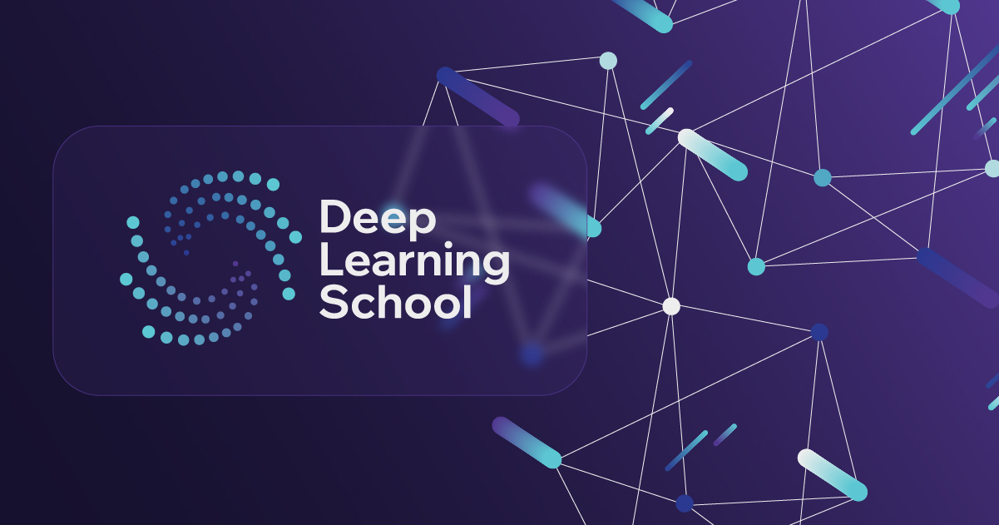


# Домашнее задание "Варианционные автоэнкодеры"

В этом домашнем задании вам предстоит реализовать несколько версий автоэнкодера для работы с изображениями.

Вы научитесь добавлять улыбку на фотографии людей, изменяя их исходное выражение лица с помощью обученной модели. А также, обучите ваш автоэнкодер генерировать изображения рукописных цифр.

# Часть 1. Vanilla Autoencoder (10 баллов)

## 1.1. Подготовка данных (1 балл)


Перед тем, как начинать работу с моделями нужно подготовить данные.

In [ ]:
import numpy as np
from torch.autograd import Variable
from torchvision import datasets
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data_utils
import torch
import matplotlib.pyplot as plt

import os
import pandas as pd
import skimage.io
from skimage.transform import resize

import imageio
from PIL import Image
import kagglehub

%matplotlib inline

В этом задании вам предстоить работать с датасетом [LFW (Labeled Faces in the Wild)](https://datasets.activeloop.ai/docs/ml/datasets/lfw-dataset/#:~:text=What%20is%20LFW%20Dataset%3F,commercial%20algorithms%20prior%20to%20release).

In [ ]:
# Скачиваем картинки
images_path = kagglehub.dataset_download("jessicali9530/lfw-dataset")
print("Path to dataset files:", images_path)

Path to dataset files: /kaggle/input/lfw-dataset


In [ ]:
# Скачиваем атрибуты
attrs_path = kagglehub.dataset_download("averkij/lfw-attributes")
print("Path to dataset files:", attrs_path)

Path to dataset files: /kaggle/input/lfw-attributes


In [ ]:
DATASET_PATH ="/kaggle/input/lfw-dataset/lfw-deepfunneled/lfw-deepfunneled/"
ATTRIBUTES_PATH = "/kaggle/input/lfw-attributes/lfw_attributes.txt"

In [ ]:
def fetch_dataset(dx=80, dy=80, dimx=45, dimy=45):

    df_attrs = pd.read_csv(ATTRIBUTES_PATH, sep='\t', skiprows=1,)
    df_attrs = pd.DataFrame(df_attrs.iloc[:, :-1].values, columns = df_attrs.columns[1:])

    photo_ids = []
    for dirpath, dirnames, filenames in os.walk(DATASET_PATH):
        for fname in filenames:
            if fname.endswith(".jpg"):
                fpath = os.path.join(dirpath, fname)
                photo_id = fname[:-4].replace('_', ' ').split()
                person_id = ' '.join(photo_id[:-1])
                photo_number = int(photo_id[-1])
                photo_ids.append({'person': person_id, 'imagenum': photo_number, 'photo_path': fpath})

    photo_ids = pd.DataFrame(photo_ids)
    df = pd.merge(df_attrs,photo_ids,on=('person', 'imagenum'))

    assert len(df) == len(df_attrs), "Потеряны данные при объединении датафреймов!"

    images = df['photo_path'].apply(imageio.imread)\
                                .apply(lambda img:img[dy:-dy, dx:-dx])\
                                .apply(lambda img: np.array(Image.fromarray(img).resize([dimx, dimy])) )

    images = np.stack(images.values).astype('uint8')
    attrs = df.drop(["photo_path","person","imagenum"],axis=1)

    return images, attrs

In [ ]:
# Обратите внимание, что датасет представляет собой не только картинки, но и атрибуты
# Атрибуты понадобятся в конце этого задания

images, attrs = fetch_dataset()


Разбейте датасет изображений и атрибутов на train и val, выведите несколько картинок в output, чтобы посмотреть, как они выглядят, и приведите картинки к тензорам pytorch, чтобы можно было скормить их сети:

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [ ]:
from sklearn.model_selection import train_test_split
from torch.utils.data import DataLoader, TensorDataset

In [ ]:
tensor_images = torch.tensor(images).permute(0, 3, 1, 2).float().to(device)
train_images, val_images, train_attr, val_attr = train_test_split(tensor_images, attrs, test_size=0.2)

batch_size = 128
train_loader = DataLoader(TensorDataset(train_images), batch_size=batch_size, shuffle=True)
val_loader = DataLoader(TensorDataset(val_images), batch_size=batch_size, shuffle=False)

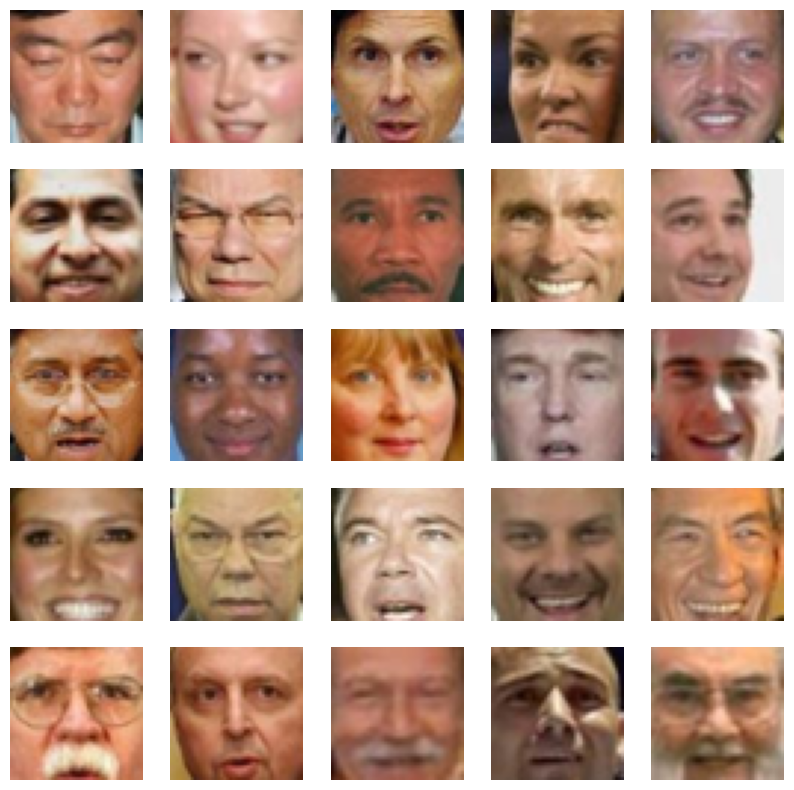

In [ ]:
cols_count = 5
rows_count = 5
count = 5 * 5
fig, axes = plt.subplots(rows_count, cols_count, figsize=(10, 10))
axes = axes.flatten()

for i in range(count):
  axes[i].imshow(train_images[i].cpu().permute(1, 2, 0).type(torch.int))
  axes[i].axis('off')

## 1.2. Архитектура модели (2 балла)
В этом разделе вы напишите и обучите обычный автоэнкодер.



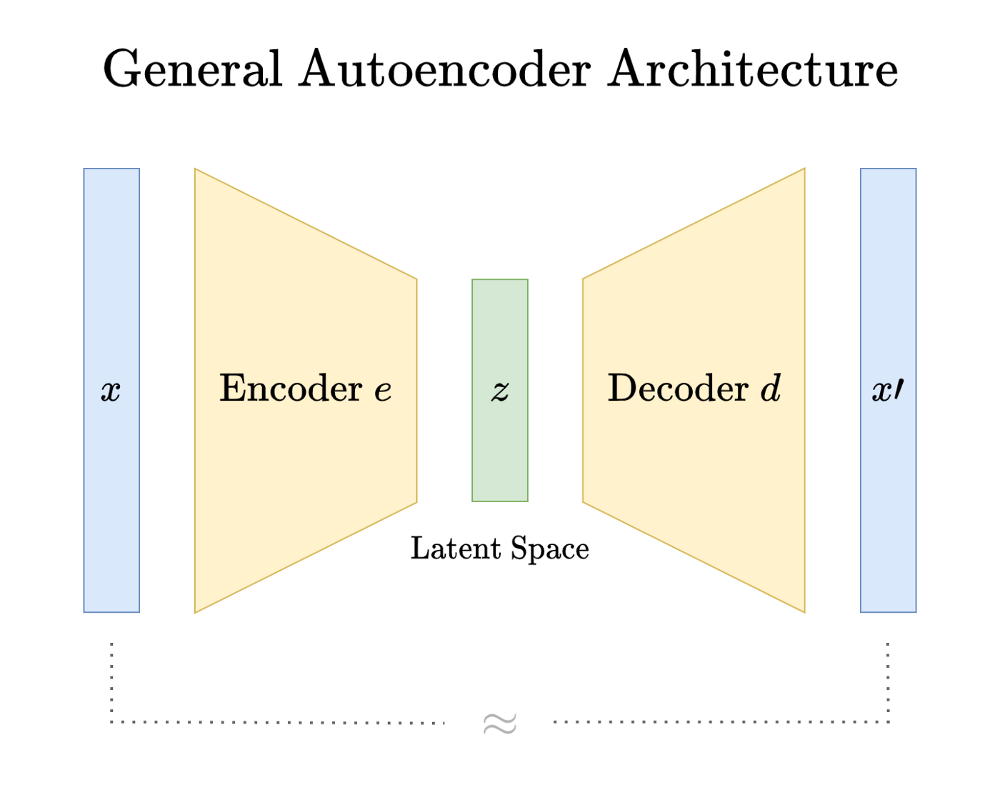

In [ ]:
dim_code = 128 # выберите размер латентного вектора

Реализуем autoencoder. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Экспериментируйте!

In [ ]:
class Autoencoder(nn.Module):
    def __init__(self):
        # <определите архитектуры encoder и decoder>
        super(Autoencoder, self).__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True), # 32x45x45
            nn.Conv2d(32, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True), # 64x45x45
            nn.Conv2d(64, 96, kernel_size=3, padding=1),
            nn.ReLU(inplace=True), # 96x45x45
            nn.Flatten(),
            nn.Linear(96*45*45, dim_code)
        )
        self.decoder = nn.Sequential(
            nn.Linear(dim_code, 96*45*45),
            nn.Unflatten(1, (96, 45, 45)),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(96, 64, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(64, 32, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.ConvTranspose2d(32, 3, kernel_size=3, padding=1)
        )

    def forward(self, x):
        # реализуйте forward проход автоэнкодера
        # в качестве возвращаемых переменных -- латентное представление картинки (latent_code)
        # и полученная реконструкция изображения (reconstruction)
        latent_code = self.encoder(x)
        reconstruction = self.decoder(latent_code)

        return reconstruction, latent_code

In [ ]:
criterion = nn.MSELoss() # <loss>

autoencoder = Autoencoder().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters()) # <Ваш любимый оптимизатор>

## 1.3 Обучение (2 балла)

Осталось написать код обучения автоэнкодера. При этом было бы неплохо в процессе иногда смотреть, как автоэнкодер реконструирует изображения на данном этапе обучения. Наример, после каждой эпохи (прогона train выборки через автоэнкодер) можно смотреть, какие реконструкции получились для каких-то изображений val выборки.

А, ну еще было бы неплохо выводить графики train и val лоссов в процессе тренировки =)

Epoch: 1; train loss: 2946001.4191; val loss: 185658.5752


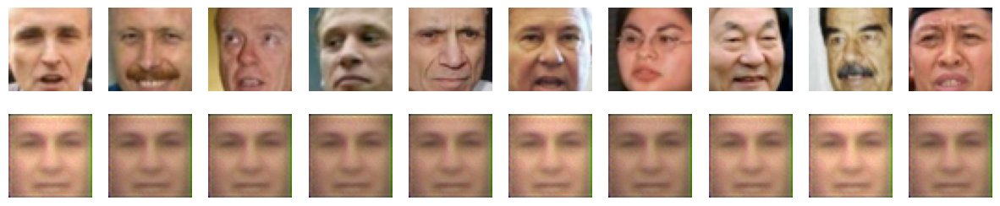

Epoch: 2; train loss: 182319.1517; val loss: 157002.2477


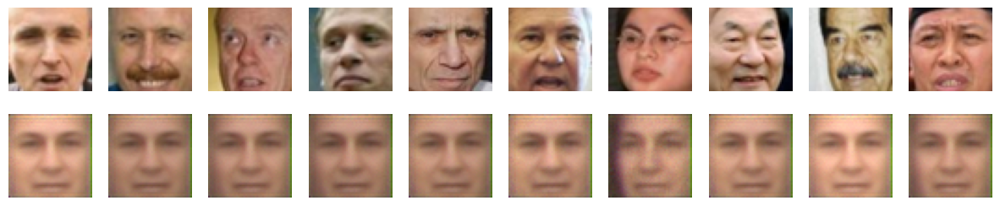

Epoch: 3; train loss: 138072.4496; val loss: 112251.2061


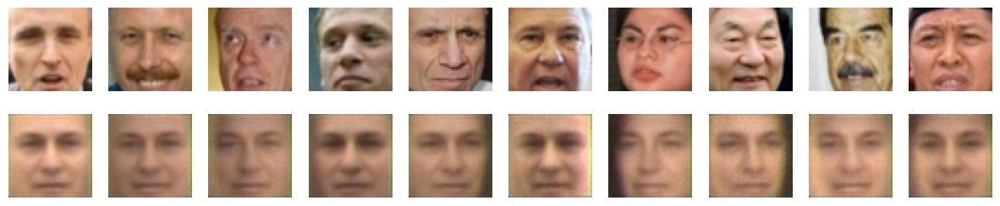

Epoch: 4; train loss: 104471.5059; val loss: 88903.5782


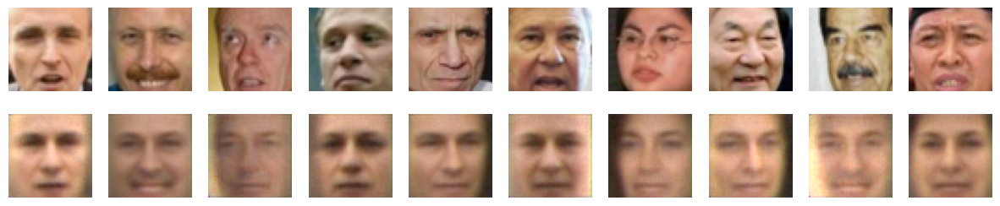

Epoch: 5; train loss: 82184.8530; val loss: 75082.3243


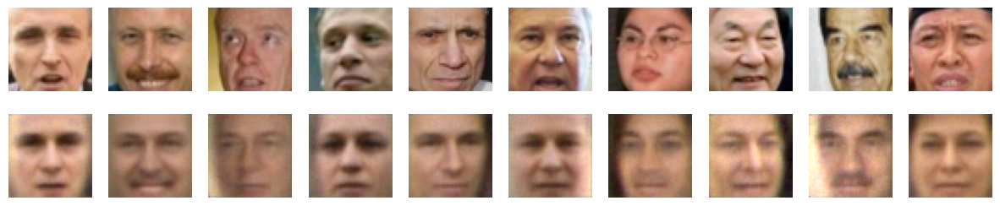

Epoch: 6; train loss: 66662.9197; val loss: 57857.1019


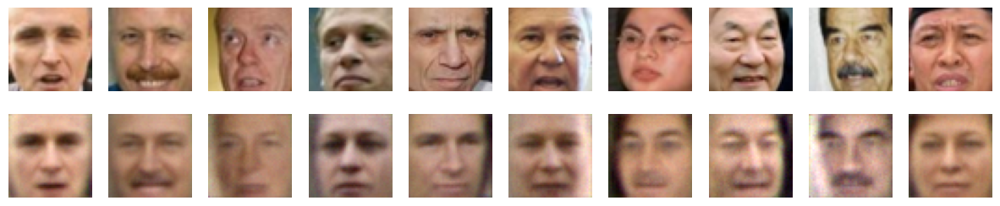

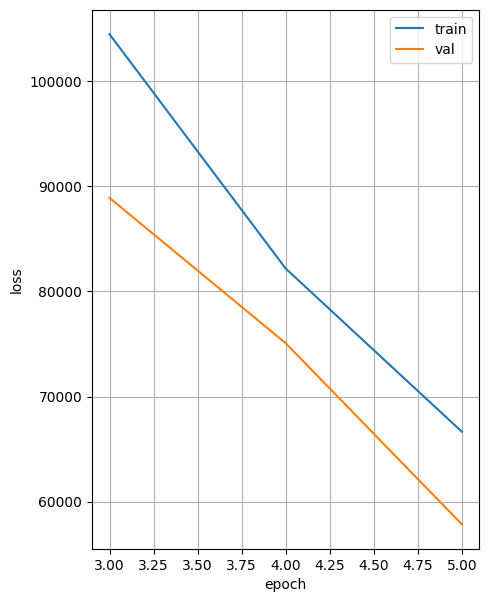

Epoch: 7; train loss: 54495.2455; val loss: 50144.2204


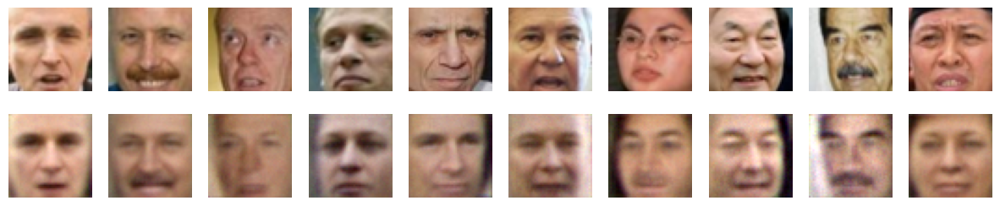

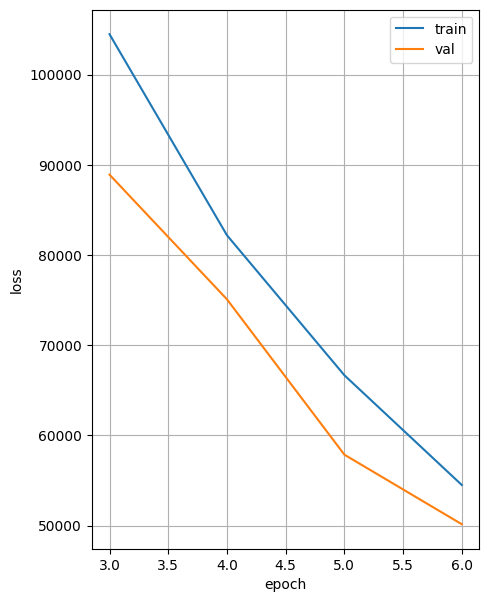

Epoch: 8; train loss: 48143.4860; val loss: 43778.6770


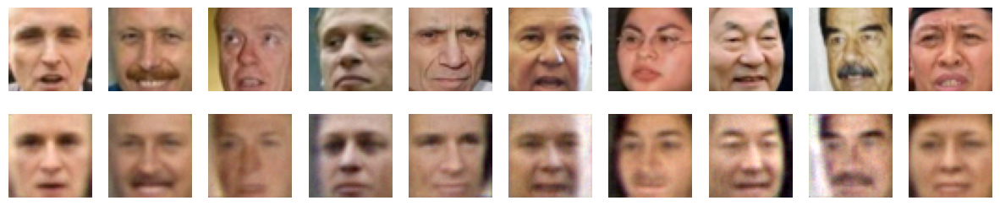

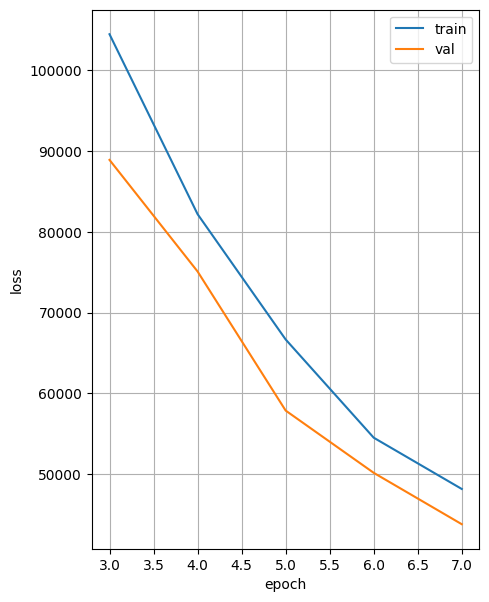

Epoch: 9; train loss: 43157.5763; val loss: 40148.8962


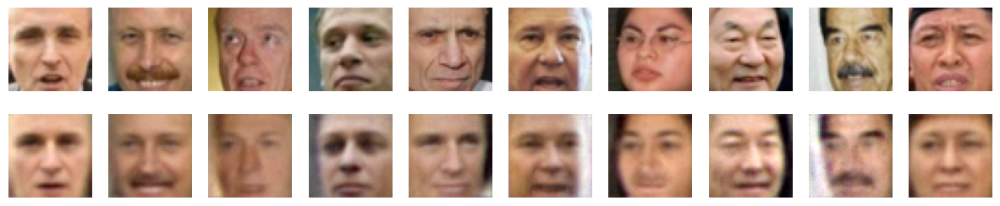

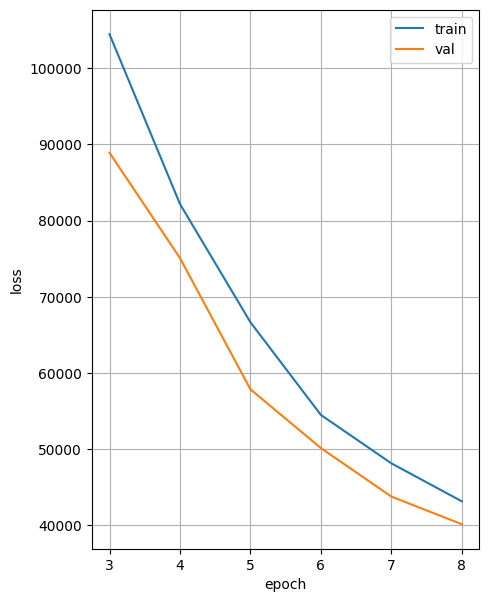

Epoch: 10; train loss: 37583.0118; val loss: 36028.5672


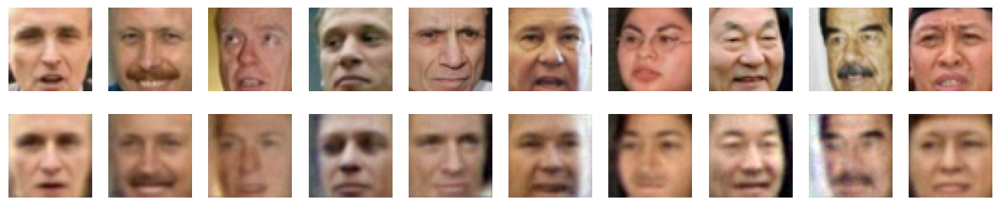

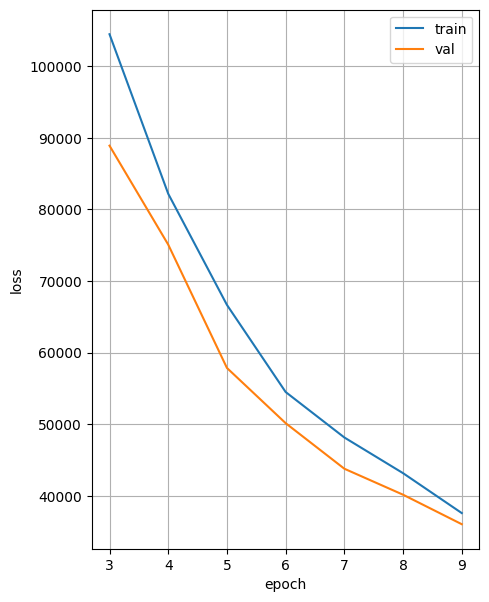

Epoch: 11; train loss: 34514.6123; val loss: 33223.8266


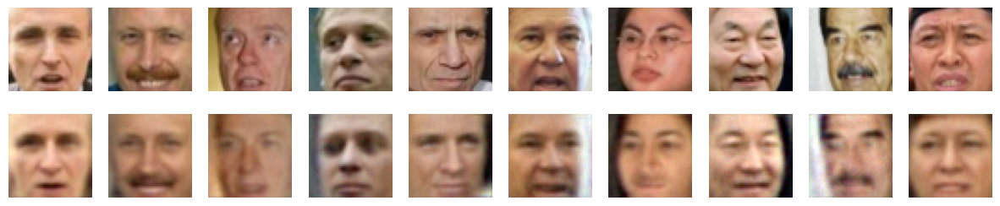

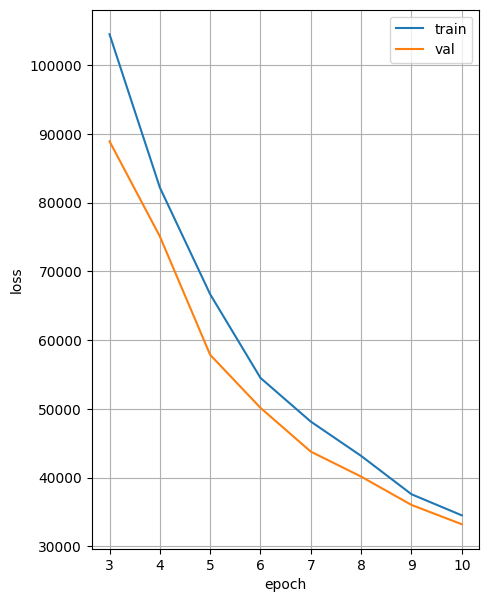

Epoch: 12; train loss: 32229.1134; val loss: 54234.2656


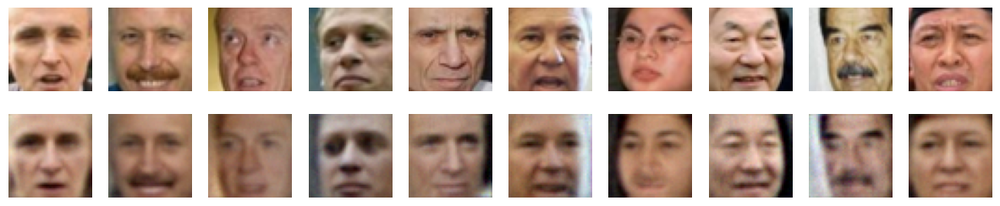

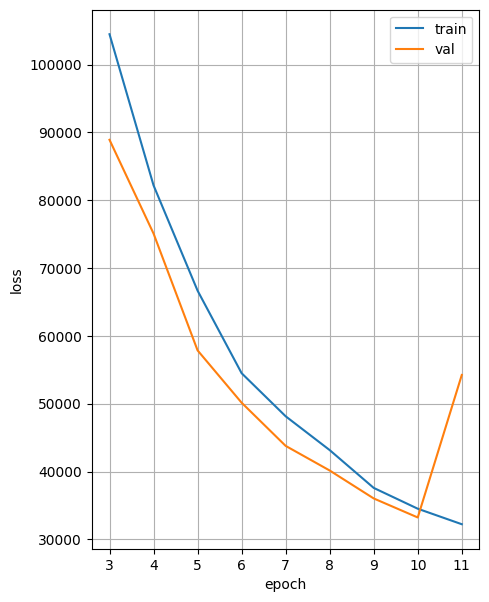

Epoch: 13; train loss: 31065.3961; val loss: 30272.4987


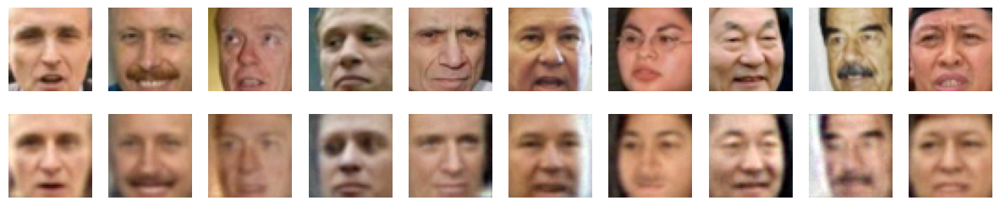

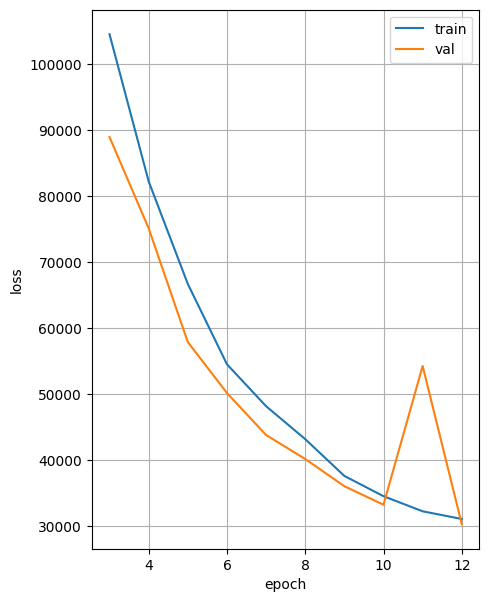

Epoch: 14; train loss: 28523.2650; val loss: 27642.3259


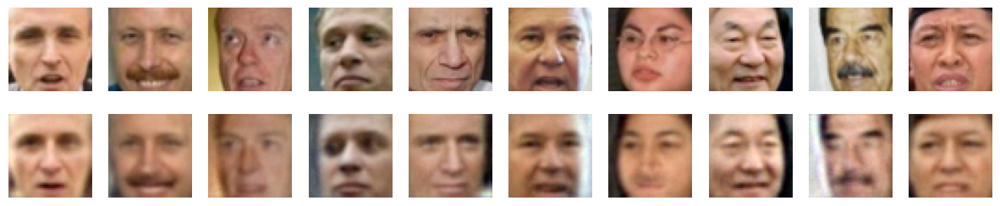

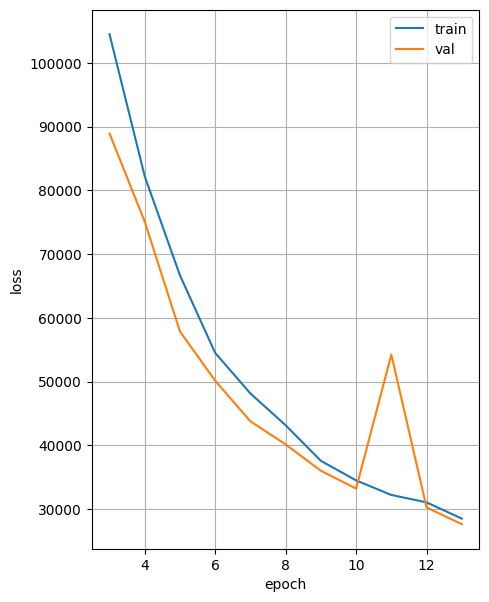

Epoch: 15; train loss: 27509.7292; val loss: 26706.9260


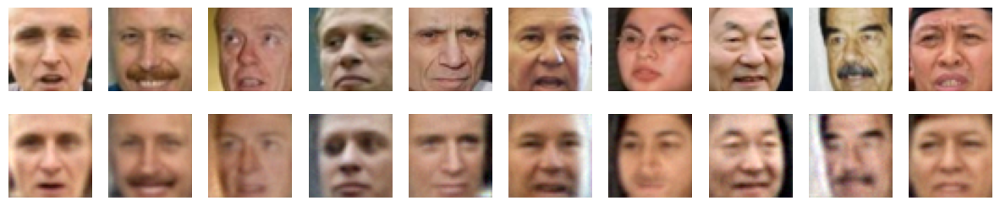

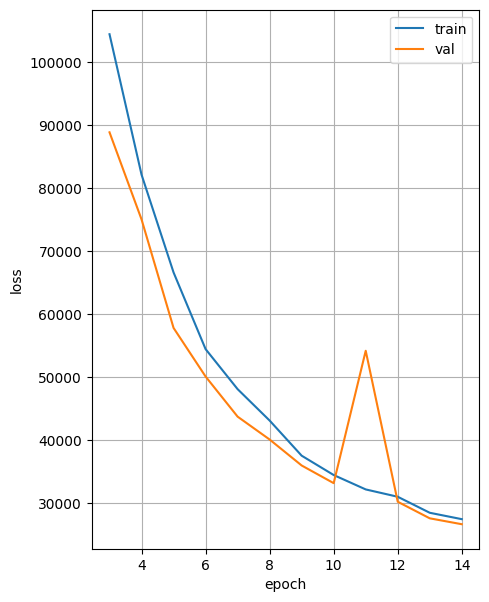

Epoch: 16; train loss: 25721.9823; val loss: 27722.8803


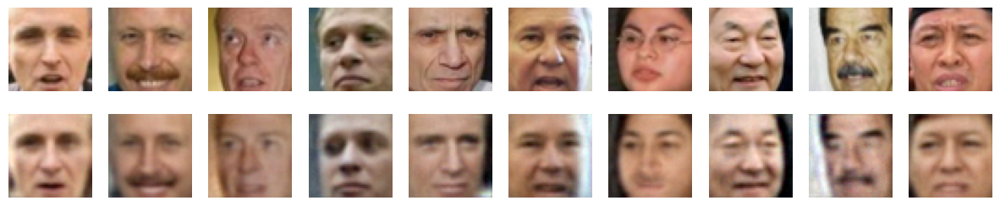

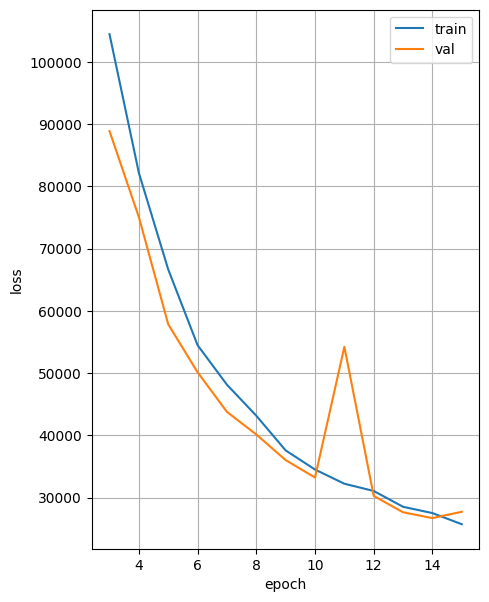

Epoch: 17; train loss: 24589.2302; val loss: 25024.8373


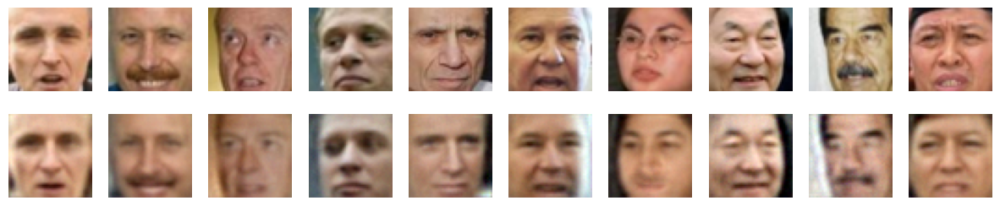

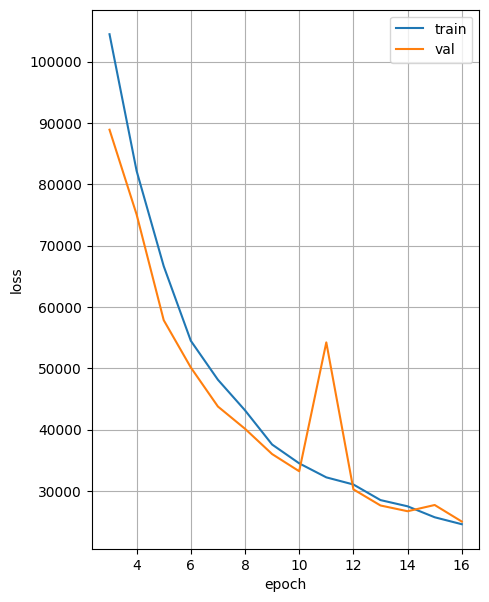

Epoch: 18; train loss: 24463.8328; val loss: 24942.0036


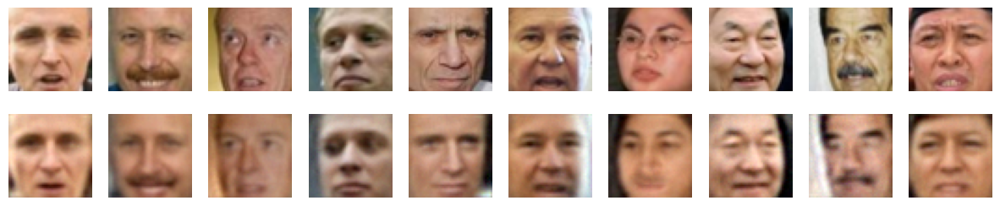

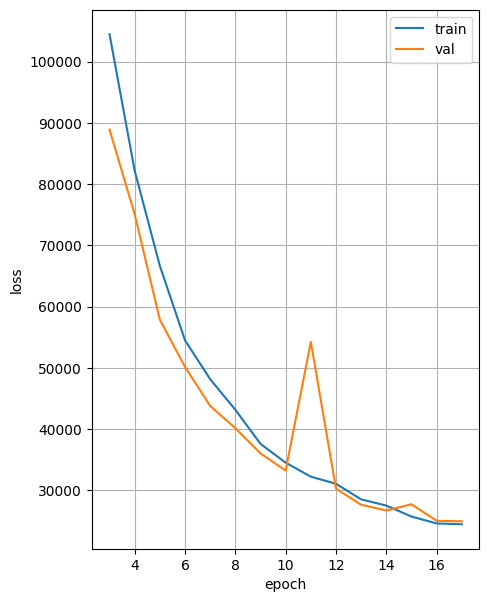

Epoch: 19; train loss: 22947.1135; val loss: 24531.7073


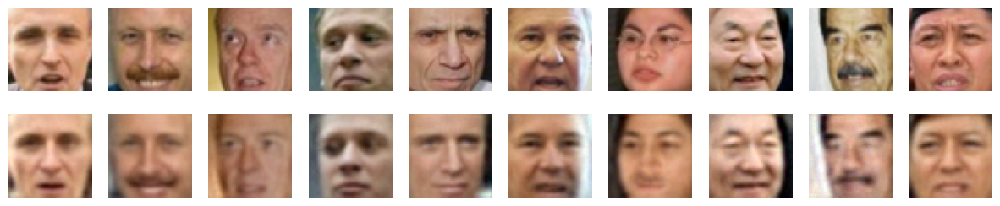

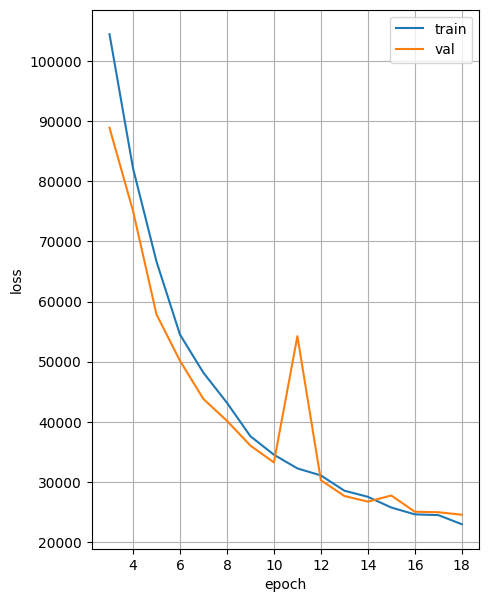

Epoch: 20; train loss: 22622.2650; val loss: 23596.3704


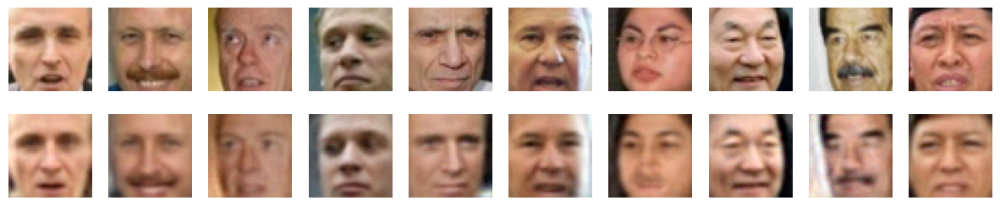

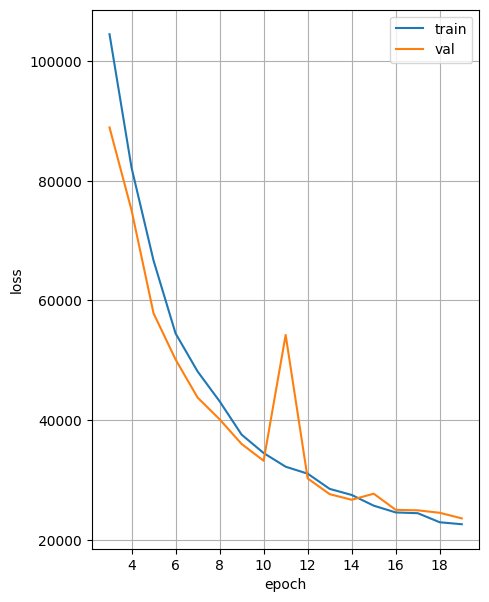

Epoch: 21; train loss: 21635.3106; val loss: 26510.1338


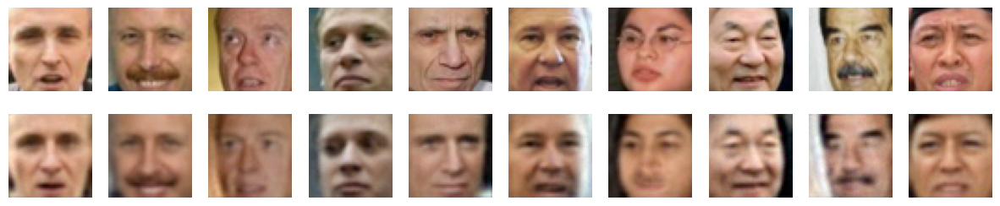

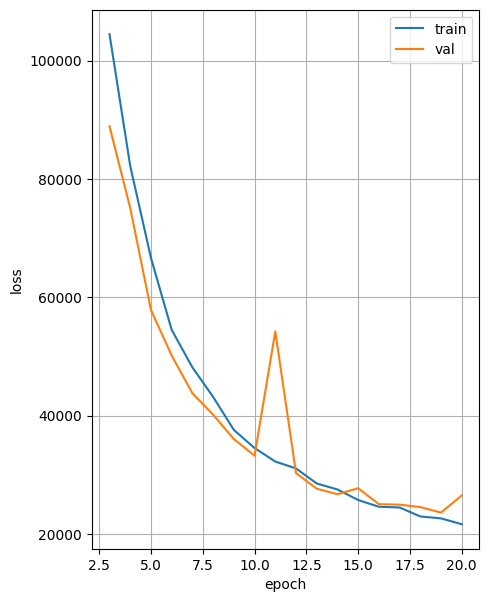

Epoch: 22; train loss: 21125.8812; val loss: 21854.1021


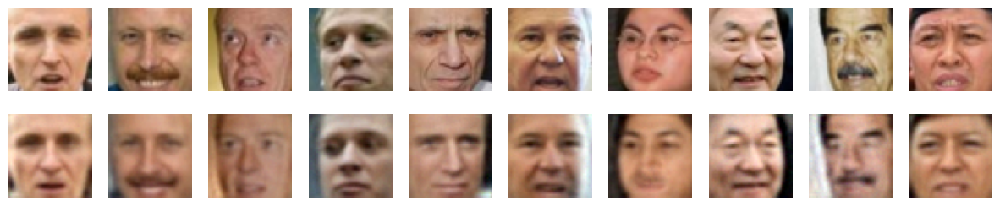

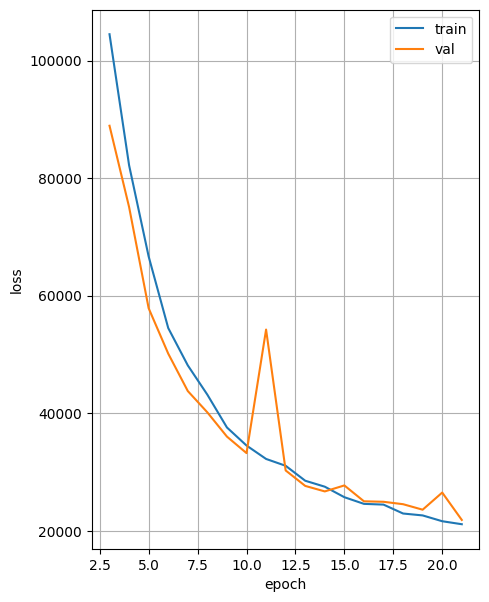

Epoch: 23; train loss: 21396.9580; val loss: 21688.3255


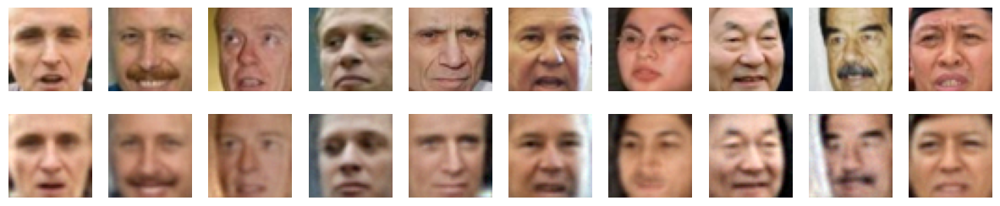

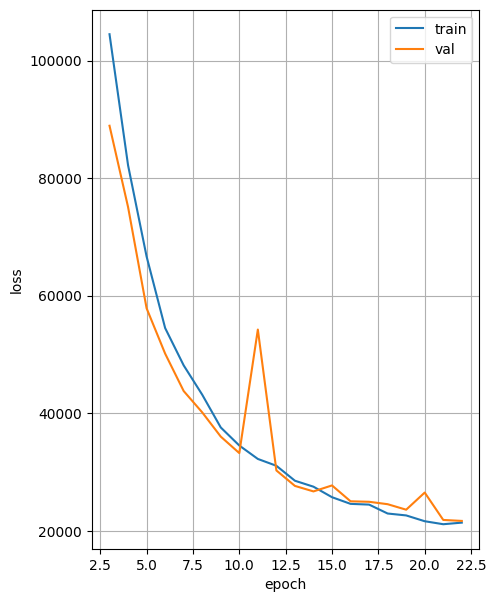

Epoch: 24; train loss: 20093.6802; val loss: 21999.9483


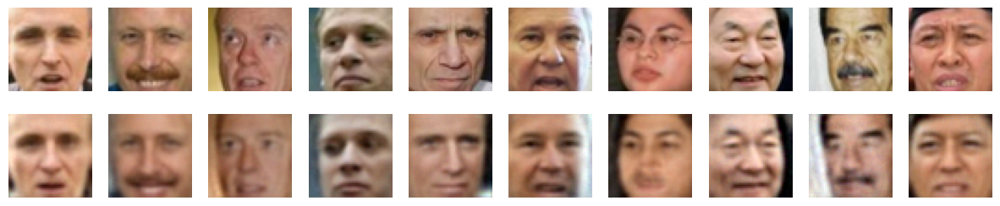

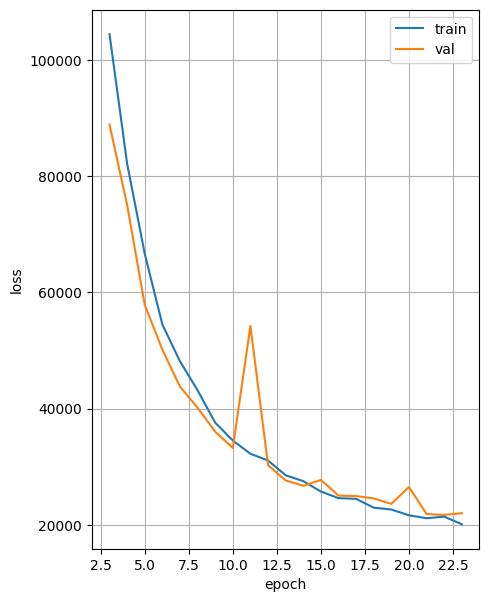

Epoch: 25; train loss: 19461.0700; val loss: 20858.3601


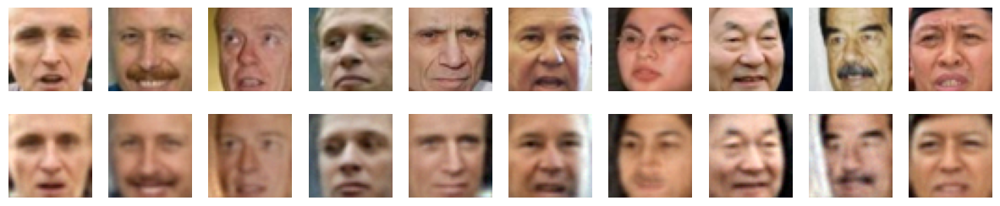

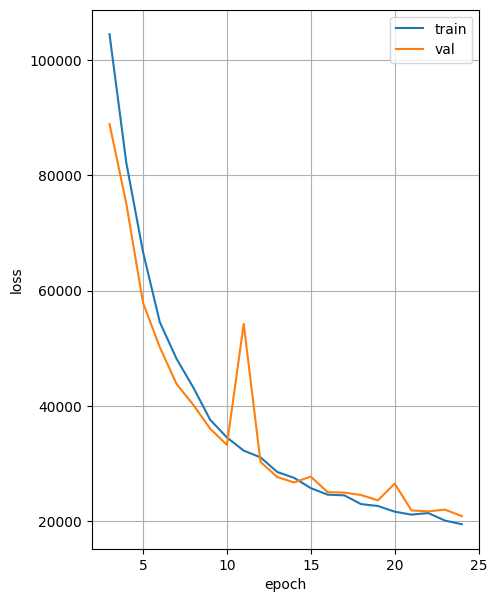

Epoch: 26; train loss: 19938.8678; val loss: 21580.2439


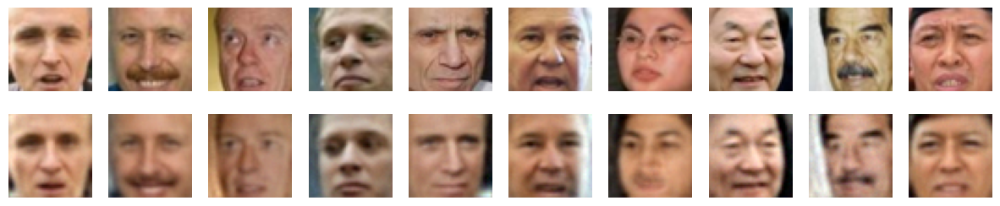

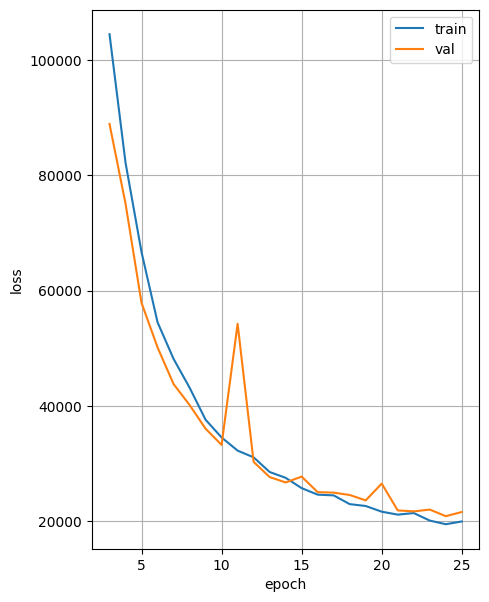

Epoch: 27; train loss: 19089.1347; val loss: 22182.3033


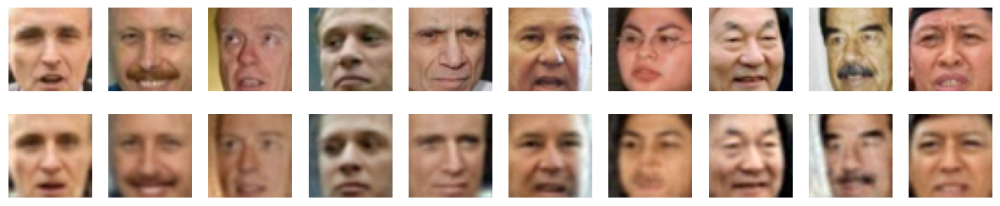

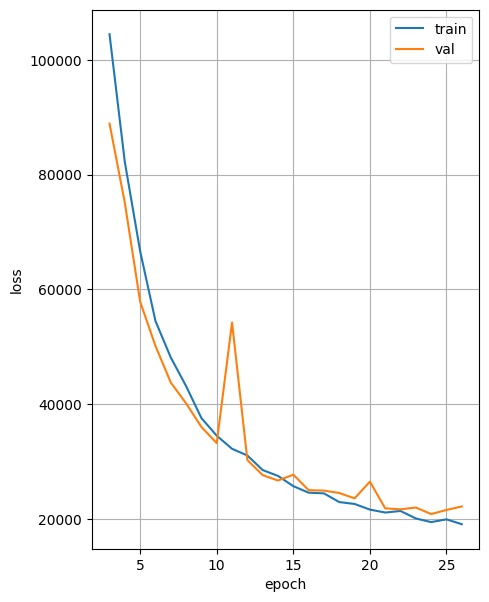

Epoch: 28; train loss: 19016.9026; val loss: 20890.4923


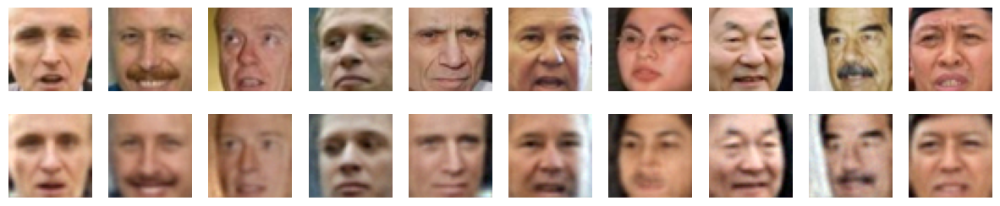

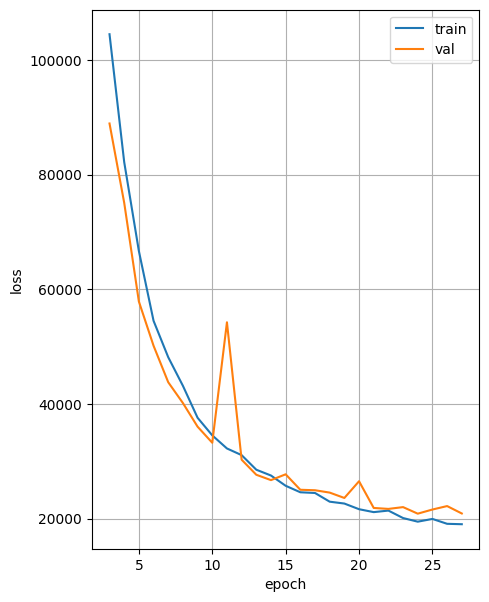

Epoch: 29; train loss: 18058.4111; val loss: 20650.9775


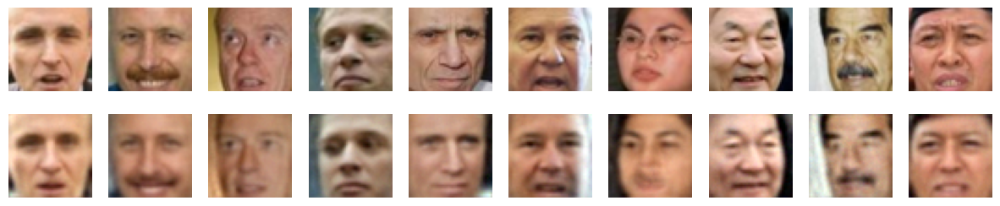

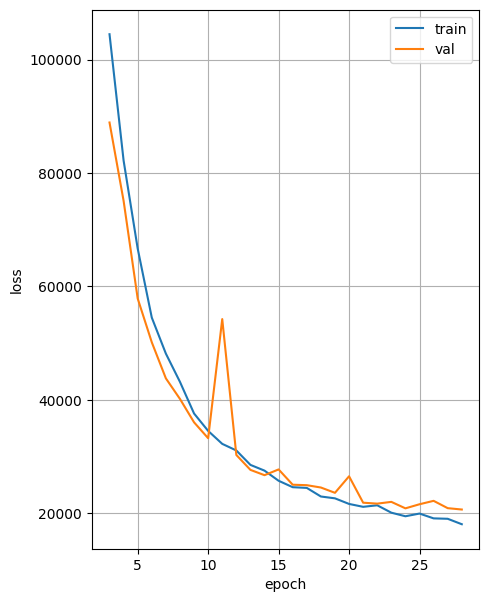

Epoch: 30; train loss: 18228.1696; val loss: 21009.6446


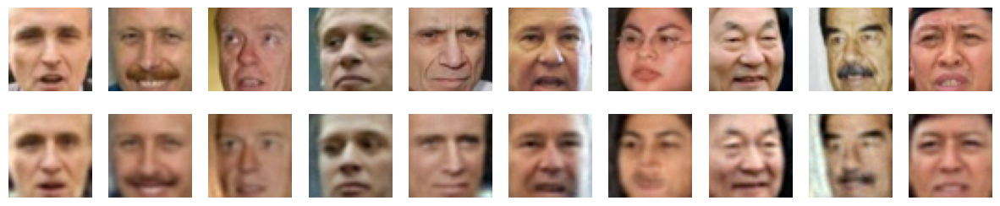

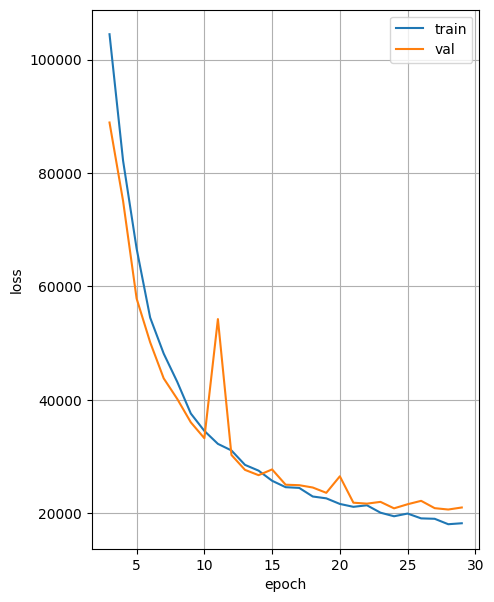

Epoch: 31; train loss: 17191.0952; val loss: 19141.3040


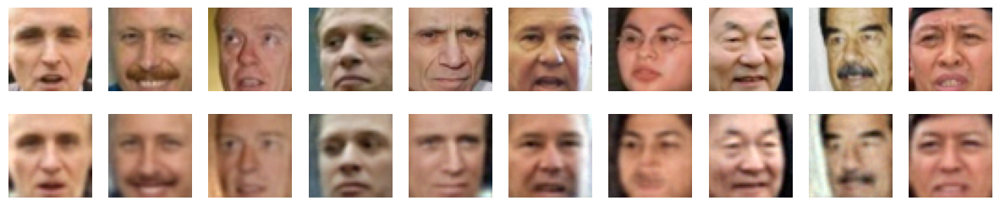

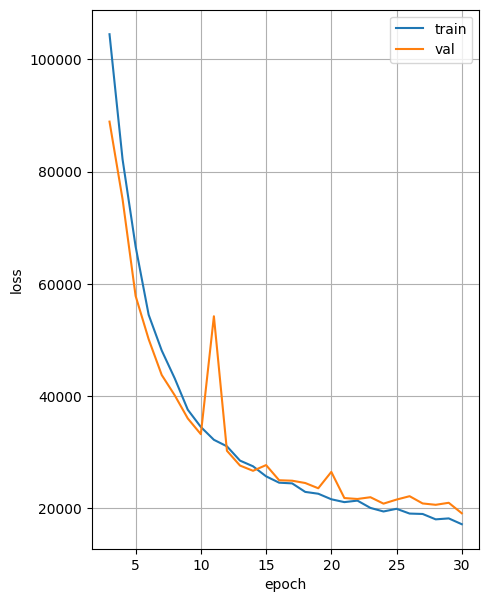

Epoch: 32; train loss: 17859.8741; val loss: 19013.5613


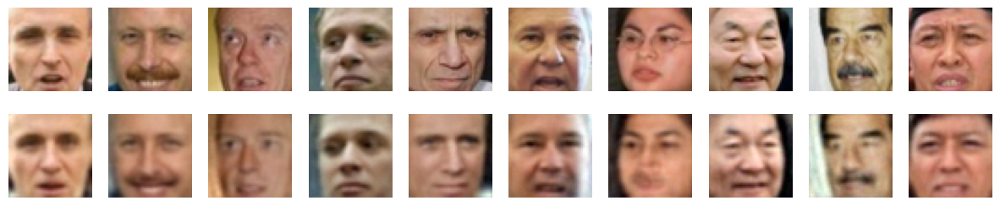

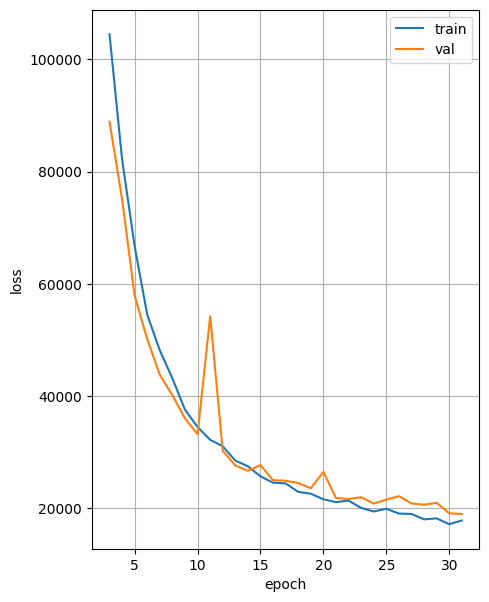

Epoch: 33; train loss: 16305.8700; val loss: 18696.8868


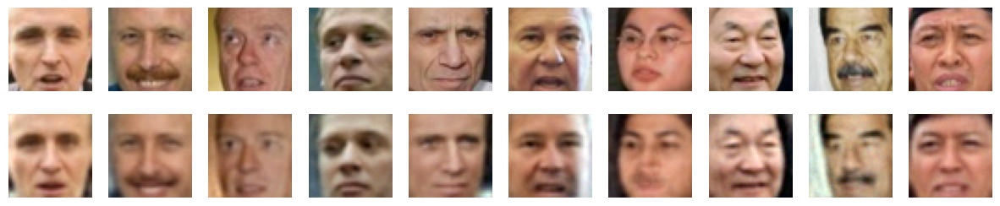

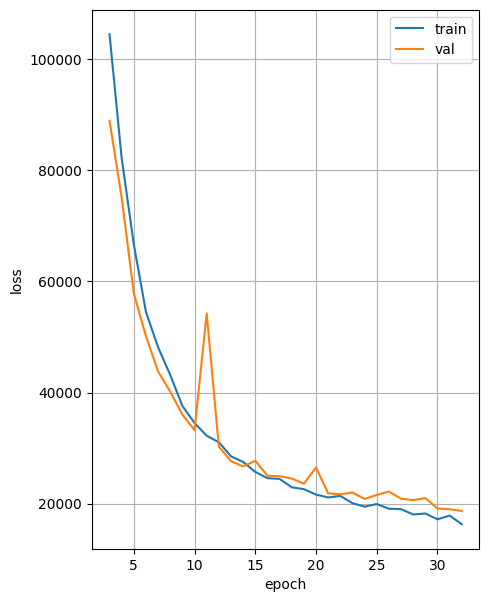

Epoch: 34; train loss: 16614.3595; val loss: 19378.5471


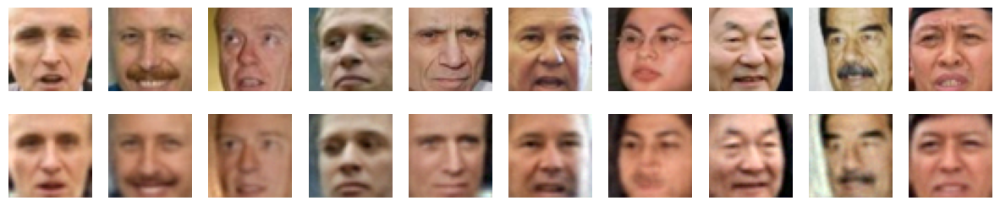

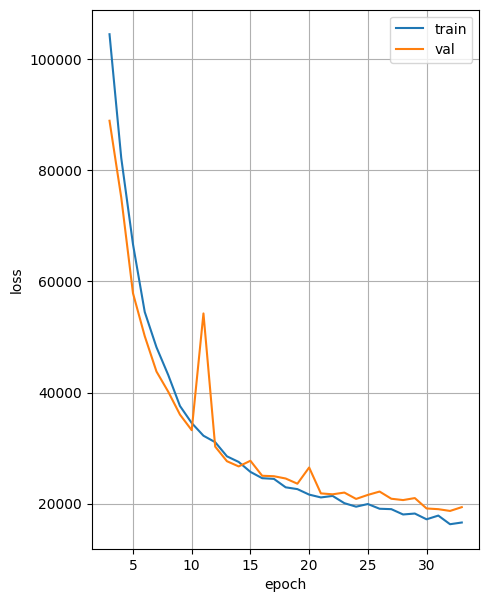

Epoch: 35; train loss: 16655.7632; val loss: 22429.0047


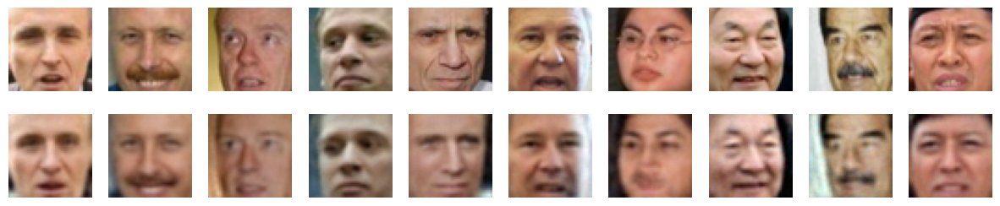

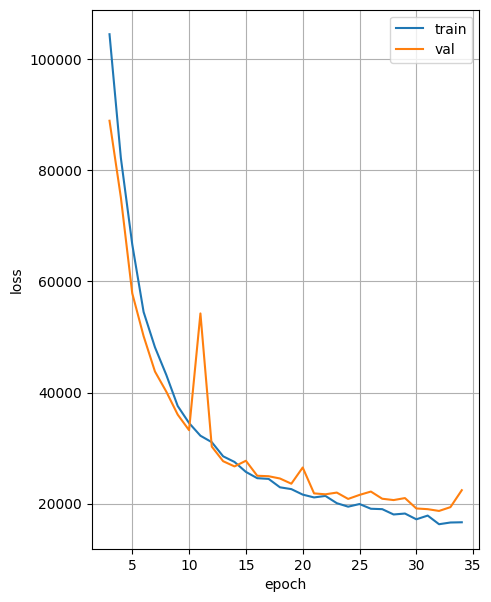

Epoch: 36; train loss: 16602.5956; val loss: 19491.8617


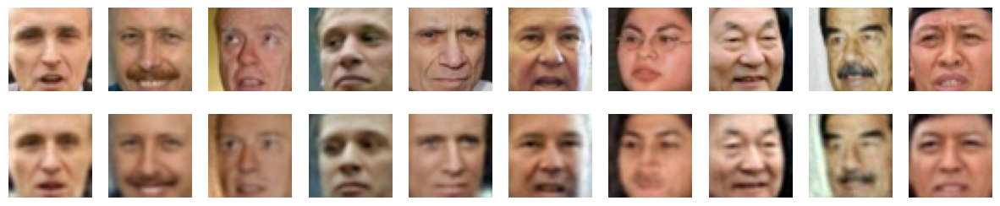

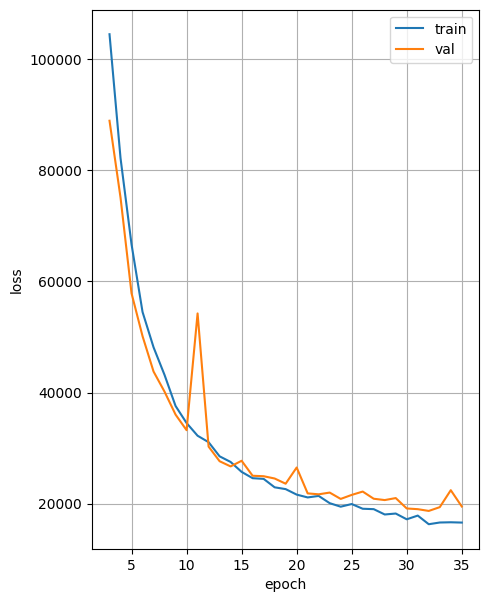

Epoch: 37; train loss: 15340.8282; val loss: 20756.6947


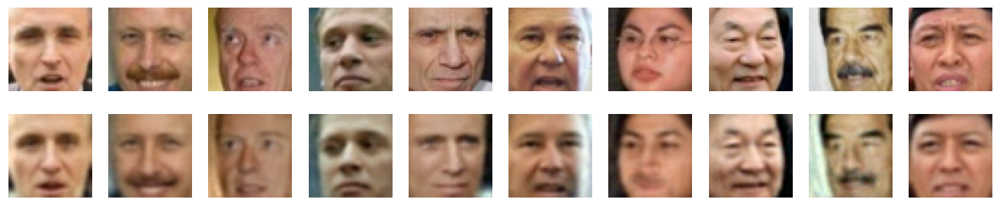

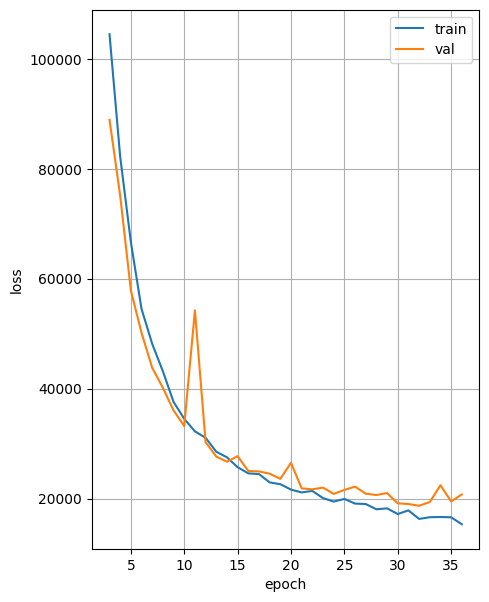

Epoch: 38; train loss: 15597.4724; val loss: 18239.7475


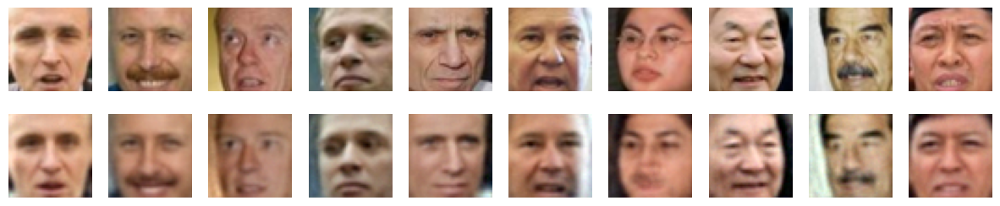

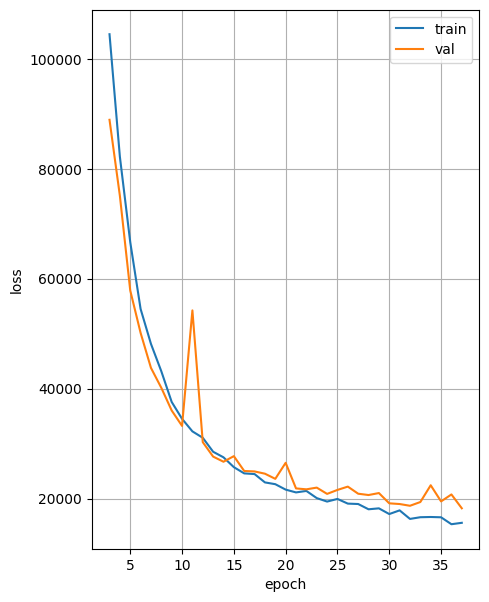

Epoch: 39; train loss: 15307.7562; val loss: 20539.3337


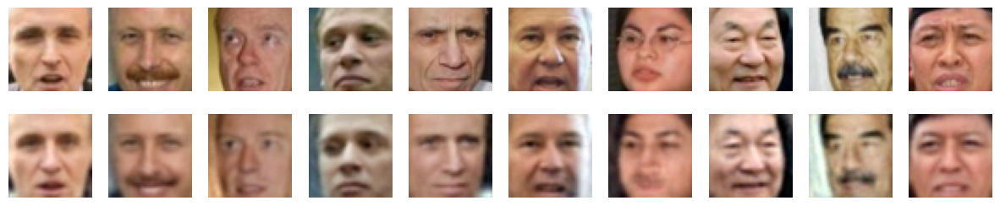

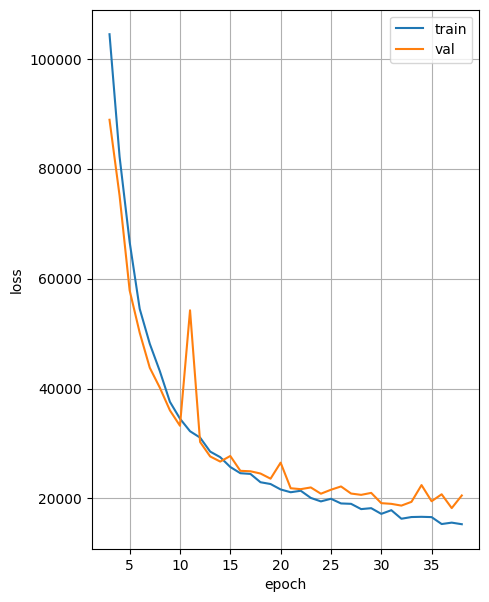

Epoch: 40; train loss: 15901.0948; val loss: 18381.4310


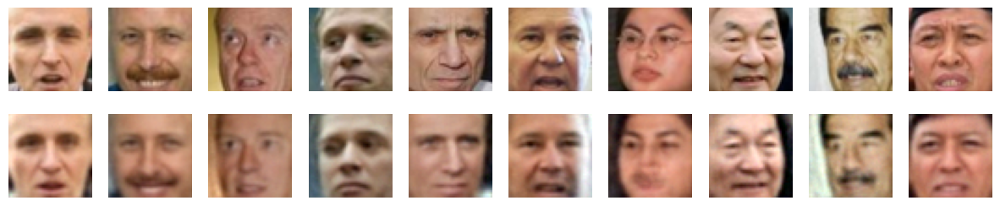

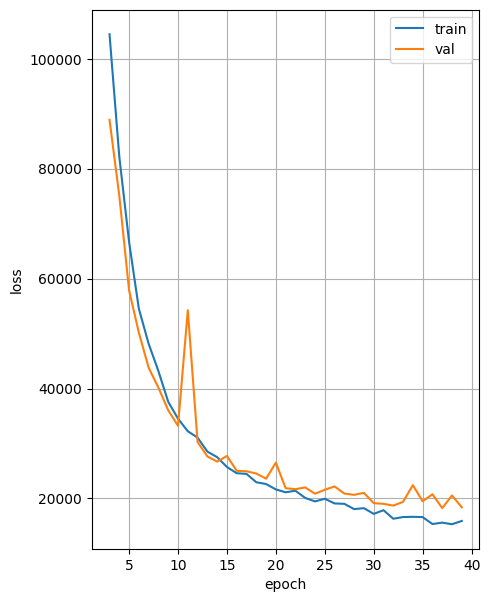

Epoch: 41; train loss: 14667.3495; val loss: 18336.4242


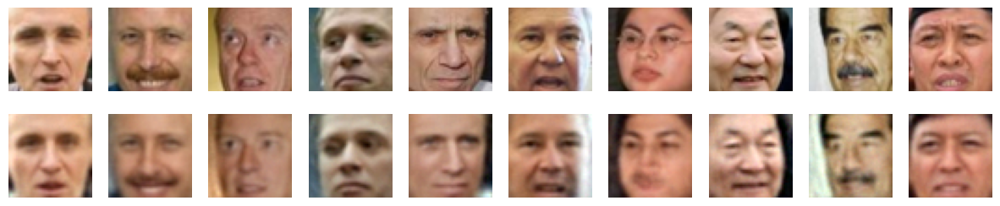

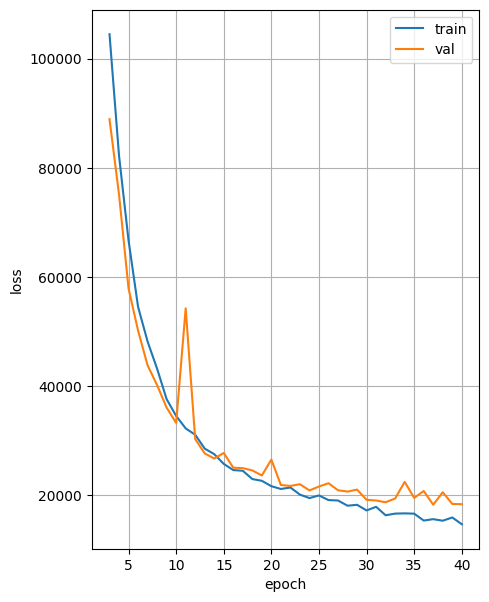

Epoch: 42; train loss: 14875.3196; val loss: 18098.6606


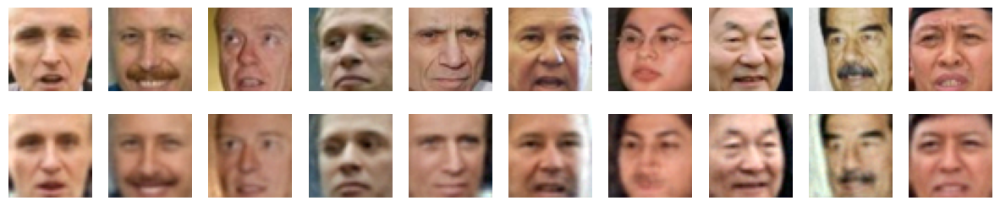

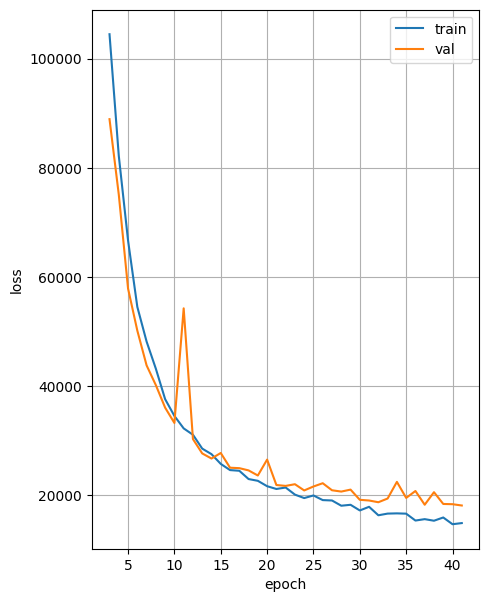

Epoch: 43; train loss: 14553.6273; val loss: 18417.0785


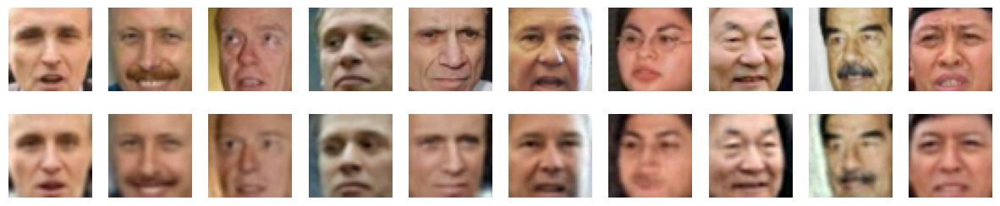

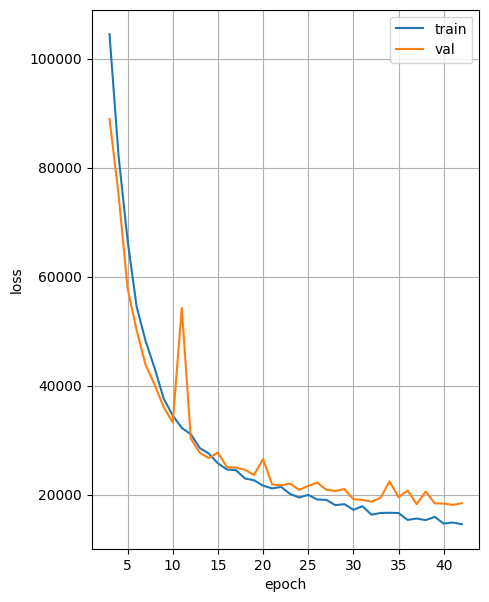

Epoch: 44; train loss: 14578.1520; val loss: 18695.1509


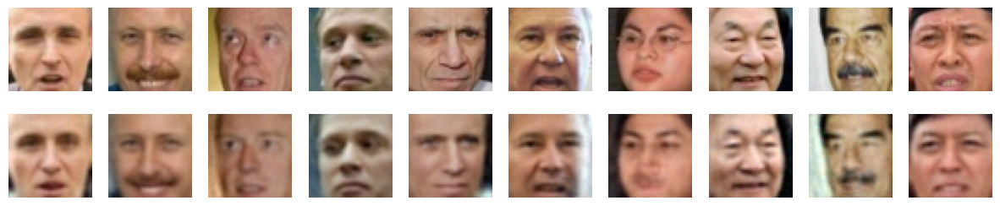

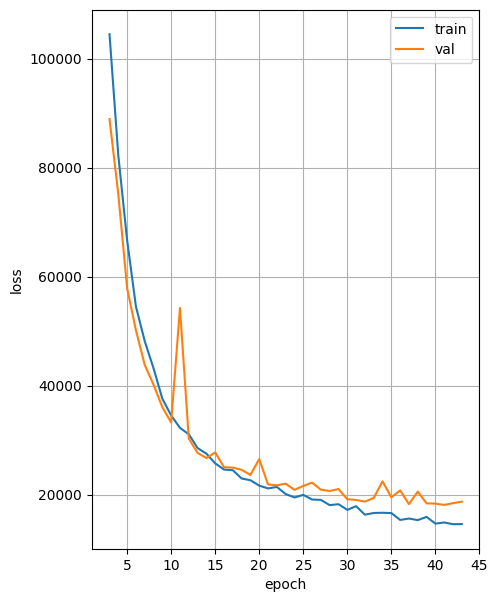

Epoch: 45; train loss: 14303.8809; val loss: 18067.2782


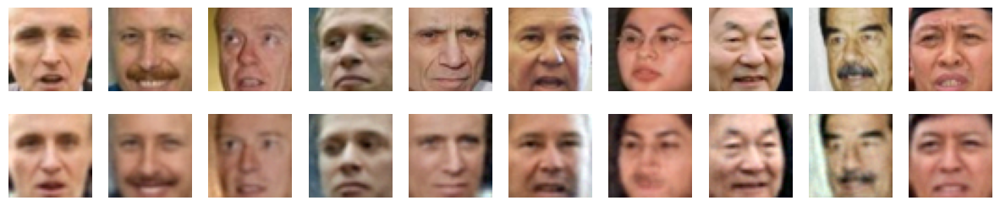

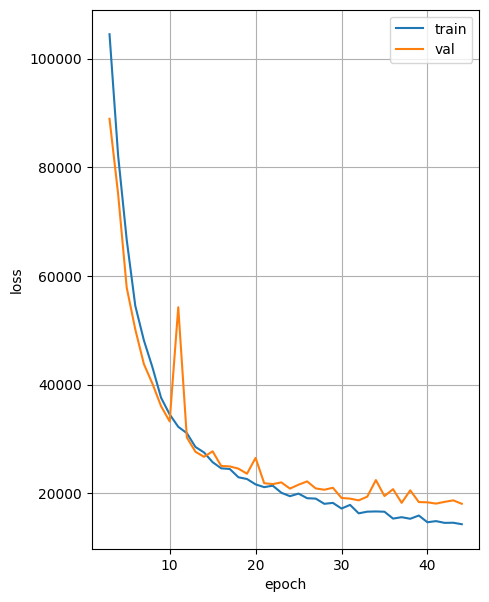

Epoch: 46; train loss: 13707.3183; val loss: 18002.3622


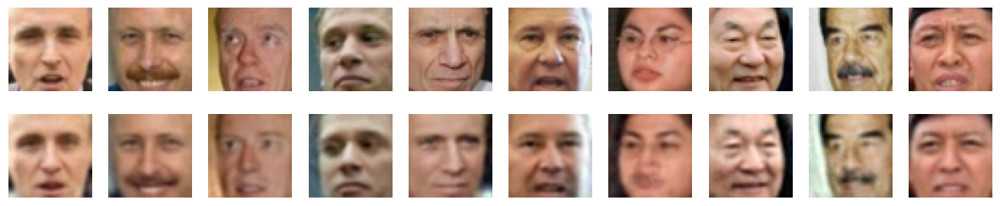

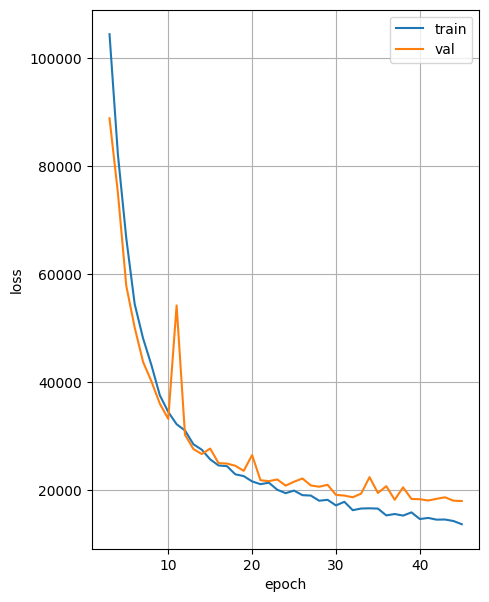

Epoch: 47; train loss: 14132.5283; val loss: 18269.1476


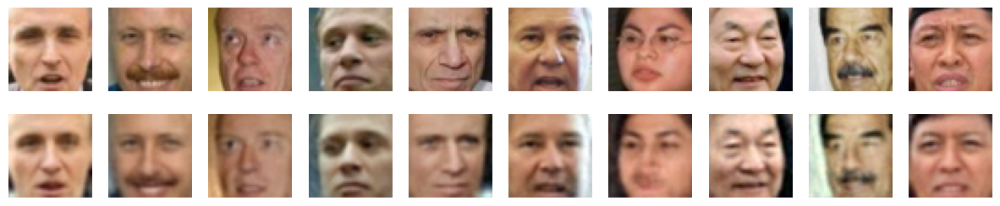

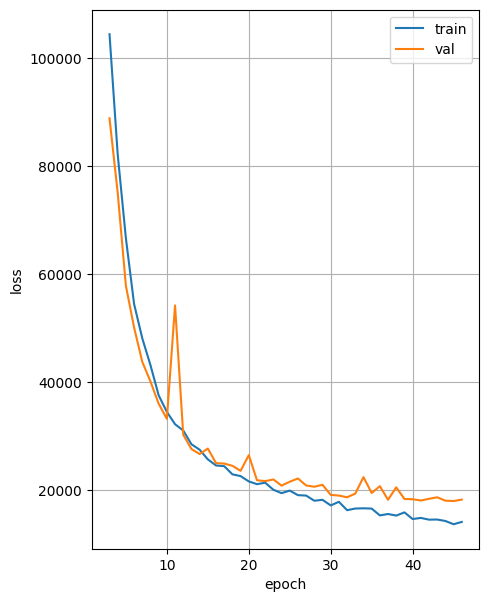

Epoch: 48; train loss: 13932.0819; val loss: 18542.2441


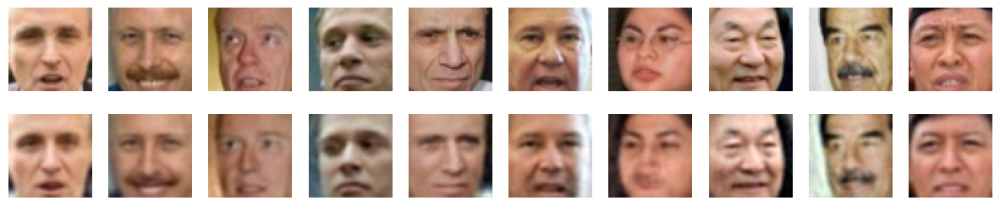

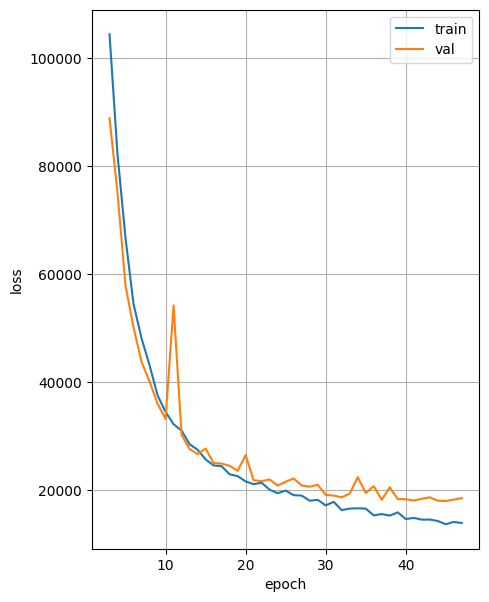

Epoch: 49; train loss: 13794.4372; val loss: 18538.4254


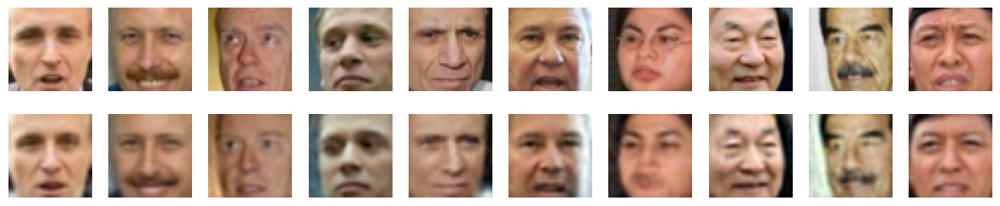

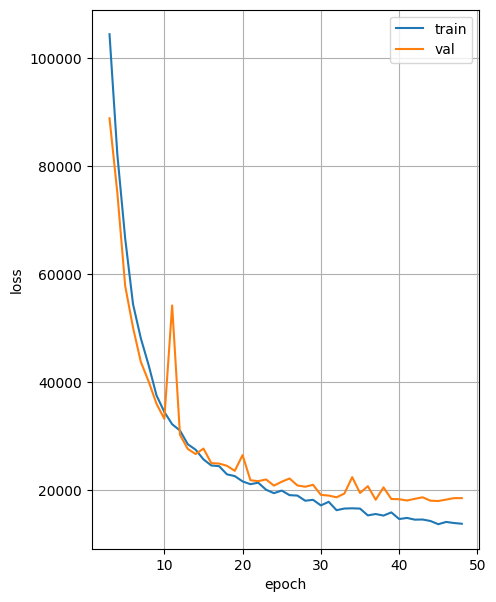

Epoch: 50; train loss: 13174.1072; val loss: 18005.5456


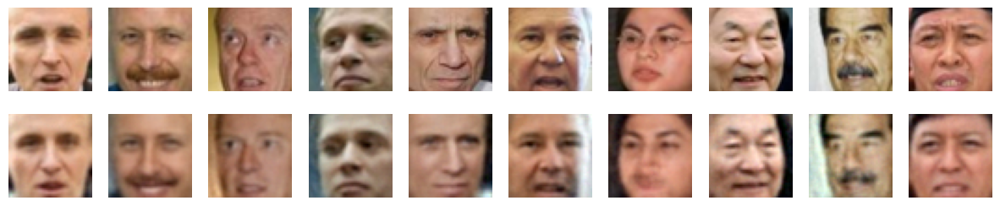

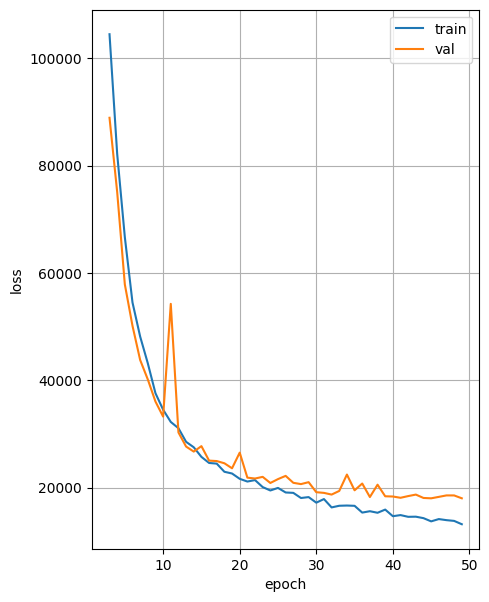

In [ ]:
epochs = 50
train_loss = []
val_loss = []

for epoch in range(epochs):
  autoencoder.train()
  cur_train_loss = 0.0
  for batch in train_loader:
    optimizer.zero_grad()
    # Все данные уже на GPU, переносить не нужно
    images = batch[0]
    reconstruction, _ = autoencoder(images)
    l = criterion(images, reconstruction)
    l.backward()
    optimizer.step()
    cur_train_loss += l.detach().cpu().item() * images.numel()
  # Подгоняемся под размер картинок для упрощения кода
  cur_train_loss /= len(train_loader) * (3 * 45 * 45)

  autoencoder.eval()
  cur_val_loss = 0.0
  with torch.no_grad():
    for batch in val_loader:
      images = batch[0]
      reconstruction, _ = autoencoder(images)
      l = criterion(images, reconstruction)
      cur_val_loss += l.detach().cpu().item() * images.numel()
  cur_val_loss /= len(val_loader) * (3 * 45 * 45)

  train_loss.append(cur_train_loss)
  val_loss.append(cur_val_loss)
  print(f"Epoch: {epoch + 1}; train loss: {cur_train_loss:.4f}; val loss: {cur_val_loss:.4f}")

  cols_count = 10
  with torch.no_grad():
    source = next(iter(val_loader))[0][:cols_count]
    reconstructed, _ = autoencoder(source)
    source = source.cpu().permute(0, 2, 3, 1).type(torch.int)
    reconstructed = reconstructed.cpu().permute(0, 2, 3, 1).type(torch.int).clip(0, 255)

  fig, axes = plt.subplots(2, cols_count, figsize=(15, 3))

  for i in range(cols_count):
    axes[0][i].imshow(source[i])
    axes[0][i].axis('off')
    axes[1][i].imshow(reconstructed[i])
    axes[1][i].axis('off')

  plt.show()

  # Не будем рисовать на первых эпохах, т.к. данных пока мало
  start_epoch = 3
  if epoch > 4:
    plt.figure(figsize=(5,7))
    # Также не будем рисовать loss для первых эпох, т.к. он там слишком большой и не показательный
    plt.plot(range(start_epoch, len(train_loss)), train_loss[start_epoch:], label='train')
    plt.plot(range(start_epoch, len(val_loss)), val_loss[start_epoch:], label='val')
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.legend()
    plt.grid()
    plt.show()

Давайте посмотрим, как наш тренированный автоэнкодер кодирует и восстанавливает картинки:

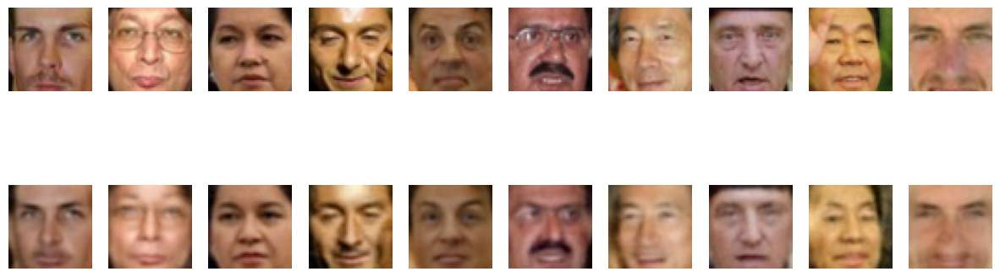

In [ ]:
cols_count = 10
with torch.no_grad():
  # Возьмем другие лица
  source = next(iter(val_loader))[0][cols_count:cols_count*2]
  reconstructed, _ = autoencoder(source)
  source = source.cpu().permute(0, 2, 3, 1).type(torch.int)
  reconstructed = reconstructed.cpu().permute(0, 2, 3, 1).type(torch.int)

fig, axes = plt.subplots(2, cols_count, figsize=(15, 5))

for i in range(cols_count):
  axes[0][i].imshow(source[i])
  axes[0][i].axis('off')
  axes[1][i].imshow(reconstructed[i].clip(0, 255))
  axes[1][i].axis('off')

fig.show()

Что вы можете сказать про результат?

Лица получились вполне похожими. Примечательно, что модель уже на первых эпохах способна выдавать что-то похожее на лица.

## 1.4. Sampling (2 балла)

Давайте теперь будем не просто брать картинку, прогонять ее через автоэнкодер и получать реконструкцию, а попробуем создать что-то НОВОЕ!

Давайте возьмем и подсунем декодеру какие-нибудь сгенерированные нами векторы (например, из нормального распределения) и посмотрим на результат реконструкции декодера:

__Подсказка:__ Если вместо лиц у вас выводится непонятно что, попробуйте посмотреть, как выглядят латентные векторы картинок из датасета. Так как в обучении нейронных сетей есть определенная доля рандома, векторы латентного слоя могут быть распределены НЕ как `np.random.randn(25, <latent_space_dim>)`. А чтобы у нас получались лица при запихивании вектора декодеру, вектор должен быть распределен так же, как латентные векторы реальных фоток. Так что в таком случае придется рандом немного подогнать.

In [ ]:
# Считаем мат. ожидание и дисперсию латентных векторов по достаточно большой
# части датасета, чтобы вектора генерировались примерно из такого же
# распределения, что и обучающие данные (исходные данные представляют собой
# числа от 0 до 255, что не очень похоже на стандартное нормальное
# распределение)

with torch.no_grad():
  latent = autoencoder.encoder(train_images[:4000])
  m = torch.mean(latent, axis=0, keepdims=True)
  v = torch.var(latent, axis=0, keepdims=True)

<ipython-input-156-572871264b18>:4: UserWarning: To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).
  output = autoencoder.decoder(torch.tensor(z).to(device))


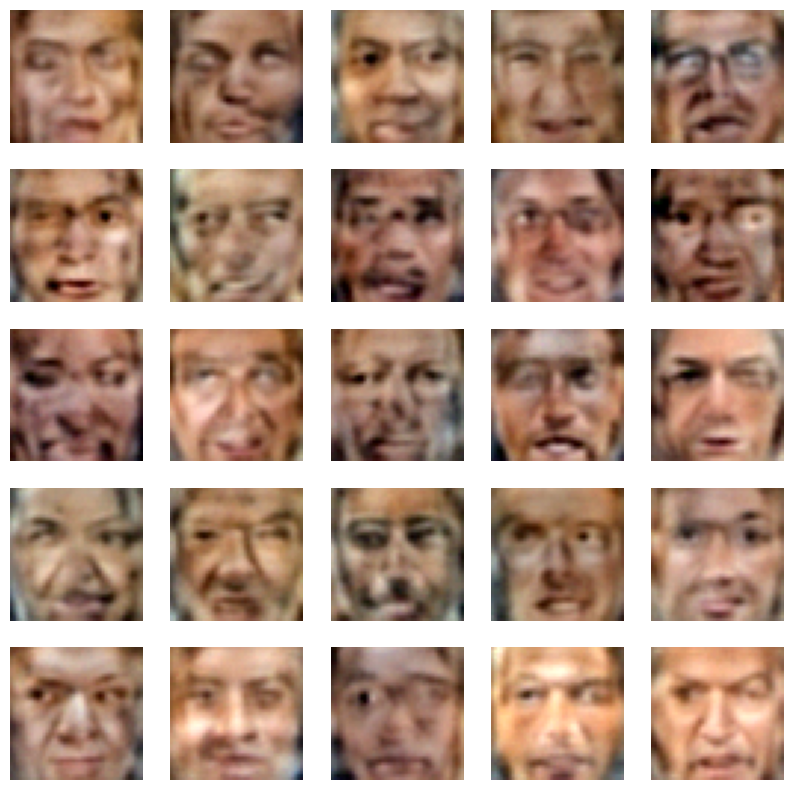

In [ ]:
# сгенерируем 25 рандомных векторов размера latent_space
z = torch.randn(25, dim_code).type(torch.float32) * torch.sqrt(v).cpu() + m.cpu()
with torch.no_grad():
  output = autoencoder.decoder(torch.tensor(z).to(device))

cols_count = 5
rows_count = 5
count = 25
fig, axes = plt.subplots(rows_count, cols_count, figsize=(10, 10))
axes = axes.flatten()

for i in range(count):
  axes[i].imshow(output[i].cpu().permute(1, 2, 0).type(torch.int).clip(0, 255))
  axes[i].axis('off')

Ну, это похоже на лица.

## 1.5 Time to make fun! (3 балла)

Давайте научимся пририсовывать людям улыбки =)

<img src="https://i.imgur.com/tOE9rDK.png" alt="linear" width="700" height="400">

План такой:

1. Нужно выделить "вектор улыбки": для этого нужно из выборки изображений найти несколько (~15) людей с улыбками и столько же без.

Найти людей с улыбками вам поможет файл с атрибутами, скачанный вместе с картинками. В нем указаны имена изображений и присутствубщие атрибуты (улыбки, очки и прочее интересное).

2. Вычислить латентный вектор для всех улыбающихся людей (прогнать их через encoder) и то же для всех грустненьких.

3. Вычислить, собственно, вектор улыбки -- посчитать разность между средним латентным вектором улыбающихся людей и средним латентным вектором грустных людей.

4. А теперь приделаем улыбку грустному человеку: добавим полученный в пункте 3 вектор к латентному вектору грустного человека и прогоним полученный вектор через decoder. Получим того же человека, но уже не грустненького!

In [ ]:
attrs['Smiling'].min(), attrs['Smiling'].max()

(-2.68659390331, 2.83999377045)

In [ ]:
smile_ind = train_attr.index[train_attr['Smiling'] > 1.0].tolist()
non_smile_ind = train_attr.index[train_attr['Smiling'] < -1.0].tolist()

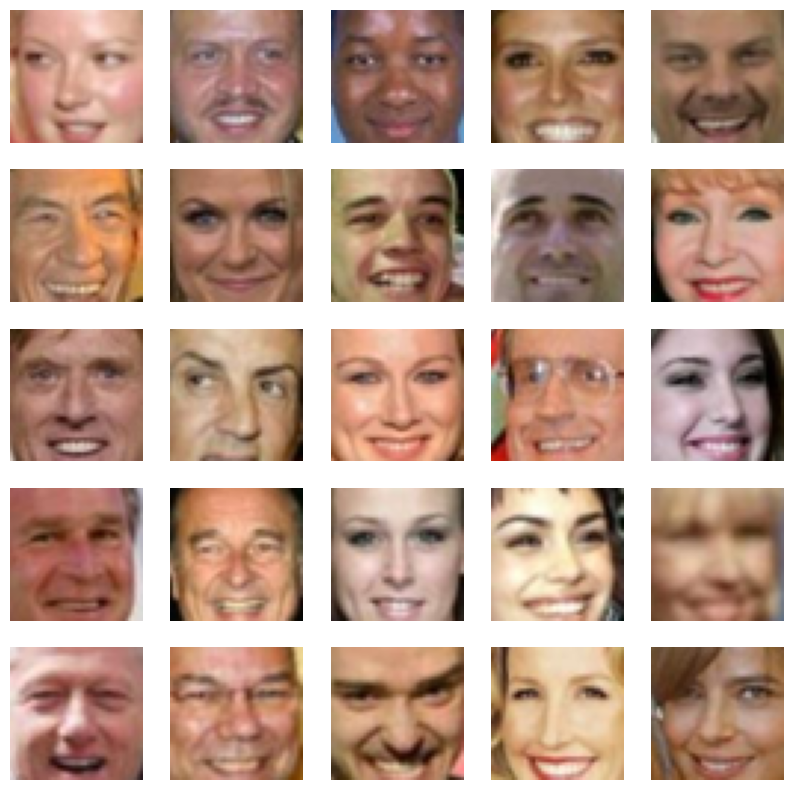

In [ ]:
cols_count = 5
rows_count = 5
count = 5 * 5
fig, axes = plt.subplots(rows_count, cols_count, figsize=(10, 10))
axes = axes.flatten()

for i in range(count):
  axes[i].imshow(tensor_images[smile_ind[i]].cpu().permute(1, 2, 0).type(torch.int))
  axes[i].axis('off')

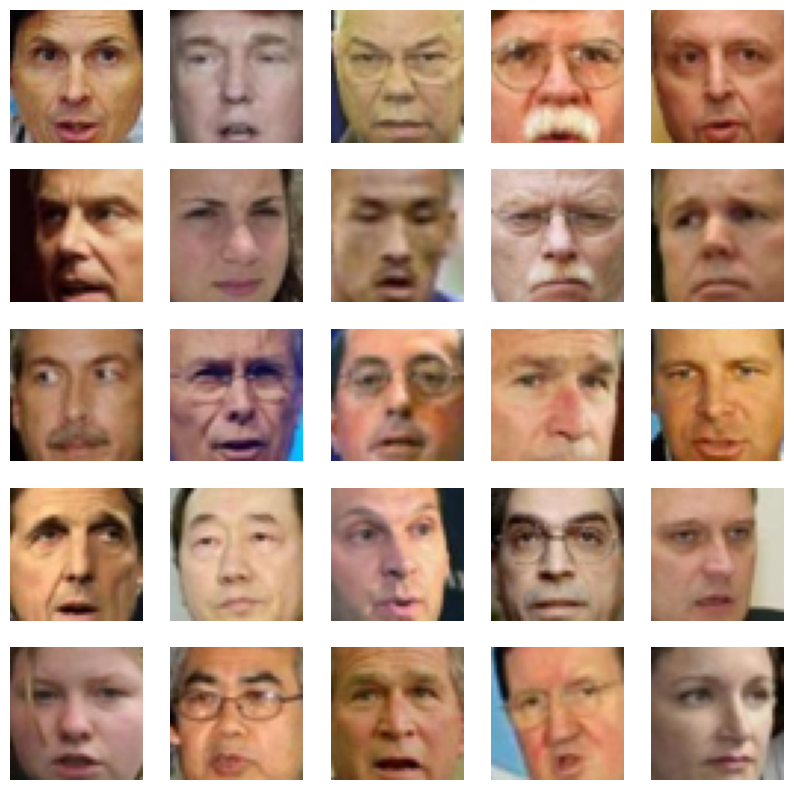

In [ ]:
cols_count = 5
rows_count = 5
count = 5 * 5
fig, axes = plt.subplots(rows_count, cols_count, figsize=(10, 10))
axes = axes.flatten()

for i in range(count):
  axes[i].imshow(tensor_images[non_smile_ind[i]].cpu().permute(1, 2, 0).type(torch.int))
  axes[i].axis('off')

In [ ]:
with torch.no_grad():
  smile_latent = autoencoder.encoder(tensor_images[smile_ind])
  smile_latent = torch.mean(smile_latent, axis=0)
  non_smile_latent = autoencoder.encoder(tensor_images[non_smile_ind])
  non_smile_latent = torch.mean(non_smile_latent, axis=0)

In [ ]:
add_smile_latent = smile_latent - non_smile_latent

Возьмем десятого грустненького с картинки выше.

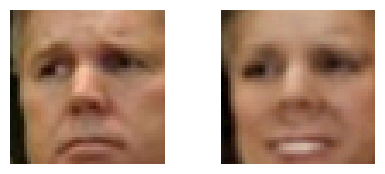

In [ ]:
with torch.no_grad():
  num = 9
  image = tensor_images[non_smile_ind[num]]
  latent = autoencoder.encoder(image[None, ...])
  latent += add_smile_latent
  res = autoencoder.decoder(latent)

  fig, axes = plt.subplots(1, 2, figsize=(5, 2))
  axes[0].imshow(image.cpu().permute(1, 2, 0).type(torch.int))
  axes[0].axis('off')
  axes[1].imshow(res[0].cpu().permute(1, 2, 0).type(torch.int).clip(0, 255))
  axes[1].axis('off')
  plt.show()

Улыбка появилась, но мне это больше напоминает это:

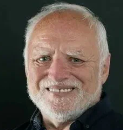

Вуаля! Вы восхитительны!

Теперь вы можете пририсовывать людям не только улыбки, но и много чего другого -- закрывать/открывать глаза, пририсовывать очки... В общем, все, на что хватит фантазии и на что есть атрибуты в `attrs`:)

# Часть 2: Variational Autoencoder (10 баллов)

Займемся обучением вариационных автоэнкодеров — проапгрейженной версии AE. Обучать будем на датасете MNIST, содержащем написанные от руки цифры от 0 до 9

In [ ]:
from torchvision import datasets, transforms

In [ ]:
batch_size = 32
# MNIST Dataset
train_dataset = datasets.MNIST(root='./mnist_data/', train=True, transform=transforms.ToTensor(), download=True)
test_dataset = datasets.MNIST(root='./mnist_data/', train=False, transform=transforms.ToTensor(), download=False)

# Data Loader (Input Pipeline)
train_loader = torch.utils.data.DataLoader(dataset=train_dataset, batch_size=batch_size, shuffle=True)
test_loader = torch.utils.data.DataLoader(dataset=test_dataset, batch_size=batch_size, shuffle=False)

100%|██████████| 9.91M/9.91M [00:01<00:00, 5.11MB/s]
100%|██████████| 28.9k/28.9k [00:00<00:00, 58.0kB/s]
100%|██████████| 1.65M/1.65M [00:01<00:00, 1.28MB/s]
100%|██████████| 4.54k/4.54k [00:00<00:00, 7.68MB/s]


## 2.1 Архитектура модели и обучение (2 балла)

Реализуем VAE. Архитектуру (conv, fully-connected, ReLu, etc) можете выбирать сами. Рекомендуем пользоваться более сложными моделями, чем та, что была на семинаре:) Экспериментируйте!

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

Размер картинки:

In [ ]:
next(iter(train_loader))[0][0].shape

torch.Size([1, 28, 28])

In [ ]:
features = 64
class VAE(nn.Module):
    def __init__(self):
        super(VAE, self).__init__()
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(1*28*28, 1024),
            nn.LeakyReLU(),
            nn.BatchNorm1d(1024),
            nn.Linear(1024, 512),
            nn.LeakyReLU(),
            nn.BatchNorm1d(512),
        )
        self.encoder_mu = nn.Linear(512, features)
        self.encoder_sigma = nn.Linear(512, features)

        self.decoder = nn.Sequential(
            nn.Linear(features, 512),
            nn.LeakyReLU(),
            nn.Linear(512, 1024),
            nn.LeakyReLU(),
            nn.Linear(1024, 1*28*28),
            nn.Unflatten(1, (1, 28, 28)),
            # nn.Unflatten(1, (32, 28, 28)),
            # nn.ConvTranspose2d(32, 1, kernel_size=5, padding=2),
            # nn.Sigmoid(),
        )

    def encode(self, x):
        # <реализуйте forward проход энкодера
        # в качестве ваозвращаемых переменных -- mu и logsigma>
        intermediate = self.encoder(x)
        mu = self.encoder_mu(intermediate)
        logsigma = self.encoder_sigma(intermediate)

        return mu, logsigma

    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            # <засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma>
            std = torch.exp(0.5 * logsigma)
            eps = torch.randn_like(std)
            sample = mu + (eps * std)
            return sample
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu.
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu

    def decode(self, z):
        # <реализуйте forward проход декодера
        # в качестве возвращаемой переменной -- reconstruction>
        reconstruction = self.decoder(z)
        return reconstruction

    def decode_sigmoid(self, z):
        reconstruction = self.decoder(z)
        return reconstruction.sigmoid()

    def forward(self, x):
        # <используя encode и decode, реализуйте forward проход автоэнкодера
        # в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction>
        mu, logsigma = self.encode(x)
        z = self.gaussian_sampler(mu, logsigma)
        reconstruction = self.decode(z)
        return mu, logsigma, reconstruction

Определим лосс и его компоненты для VAE:

Надеюсь, вы уже прочитали материал в towardsdatascience (или еще где-то) про VAE и знаете, что лосс у VAE состоит из двух частей: KL и log-likelihood.

Общий лосс будет выглядеть так:

$$\mathcal{L} = -D_{KL}(q_{\phi}(z|x)||p(z)) + \log p_{\theta}(x|z)$$

Формула для KL-дивергенции:

$$D_{KL} = -\frac{1}{2}\sum_{i=1}^{dimZ}(1+log(\sigma_i^2)-\mu_i^2-\sigma_i^2)$$

В качестве log-likelihood возьмем привычную нам кросс-энтропию.

In [ ]:
def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    loss = -0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
    return loss

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    # loss = nn.BCELoss(reduction='sum')
    loss = nn.BCEWithLogitsLoss(reduction='sum')
    # loss = nn.L1Loss(reduction='sum')
    return loss(reconstruction, x)

def loss_vae(x, mu, logsigma, reconstruction):
    return KL_divergence(mu, logsigma) + log_likelihood(x, reconstruction)

И обучим модель:

In [ ]:
criterion = loss_vae

autoencoder = VAE().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters())

In [ ]:
epochs = 100
train_loss = []
test_loss = []

for epoch in range(epochs):
  autoencoder.train()
  cur_train_loss = 0.0
  for images, classes in train_loader:
    optimizer.zero_grad()
    images = images.to(device)
    mu, logsigma, reconstruction = autoencoder(images)
    l = criterion(images, mu, logsigma, reconstruction)
    l.backward()
    optimizer.step()
    cur_train_loss += l.detach().cpu().item()
  cur_train_loss /= len(train_loader)

  autoencoder.eval()
  cur_test_loss = 0.0
  with torch.no_grad():
    for images, classes in test_loader:
      images = images.to(device)
      mu, logsigma, reconstruction = autoencoder(images)
      l = criterion(images, mu, logsigma, reconstruction)
      cur_test_loss += l.detach().cpu().item()
  cur_test_loss /= len(test_loader)

  train_loss.append(cur_train_loss)
  test_loss.append(cur_test_loss)
  print(f"Epoch: {epoch + 1}; train loss: {cur_train_loss:.4f}; val loss: {cur_test_loss:.4f}")

Epoch: 1; train loss: 4532.3933; val loss: 3440.0110
Epoch: 2; train loss: 3757.9865; val loss: 3204.7663
Epoch: 3; train loss: 3619.5382; val loss: 3159.0691
Epoch: 4; train loss: 3549.0959; val loss: 3114.7401
Epoch: 5; train loss: 3503.1074; val loss: 3103.2697
Epoch: 6; train loss: 3471.1405; val loss: 3076.4623
Epoch: 7; train loss: 3444.6620; val loss: 3055.4004
Epoch: 8; train loss: 3428.3691; val loss: 3036.2417
Epoch: 9; train loss: 3409.2298; val loss: 3028.8764
Epoch: 10; train loss: 3395.2081; val loss: 3026.4356
Epoch: 11; train loss: 3384.1125; val loss: 3009.6164
Epoch: 12; train loss: 3370.3695; val loss: 3010.2336
Epoch: 13; train loss: 3364.9337; val loss: 2999.2361
Epoch: 14; train loss: 3354.7680; val loss: 3007.5068
Epoch: 15; train loss: 3348.3323; val loss: 3000.1697
Epoch: 16; train loss: 3340.1222; val loss: 2999.8774
Epoch: 17; train loss: 3334.4025; val loss: 2983.9711
Epoch: 18; train loss: 3327.2887; val loss: 2987.5997
Epoch: 19; train loss: 3321.0493; val

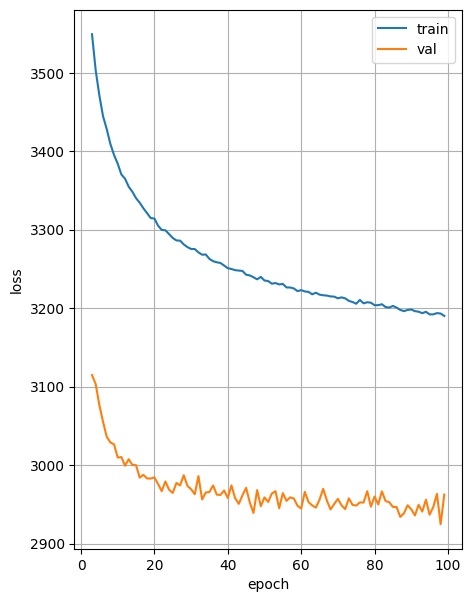

In [ ]:
start_epoch = 3
plt.figure(figsize=(5,7))
plt.plot(range(start_epoch, len(train_loss)), train_loss[start_epoch:], label='train')
plt.plot(range(start_epoch, len(test_loss)), test_loss[start_epoch:], label='val')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

Давайте посмотрим, как наш тренированный VAE кодирует и восстанавливает картинки:

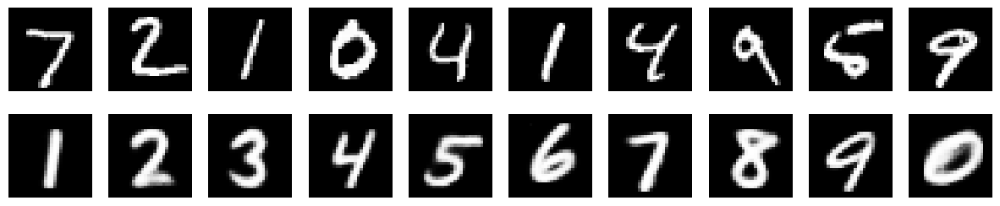

In [ ]:
# < тут Ваш код: выведите первые Х картинок и их реконструкций из val выборки на экран>
cols_count = 10
with torch.no_grad():
  autoencoder.eval()
  source = next(iter(test_loader))[0][:cols_count]
  _, _, reconstruction = autoencoder(images.to(device))
  reconstruction = reconstruction.sigmoid()
  source = source.cpu().permute(0, 2, 3, 1)
  reconstruction = reconstruction.cpu().permute(0, 2, 3, 1)

fig, axes = plt.subplots(2, cols_count, figsize=(15, 3))

for i in range(cols_count):
  axes[0][i].imshow(source[i, :, :, 0], cmap='gray')
  axes[0][i].axis('off')
  axes[1][i].imshow(reconstruction[i], cmap='gray')
  axes[1][i].axis('off')

plt.show()

Я пытался заставить работать эту модель, но никак не получалось. Я свертки пробовал, и разные loss-функции реконструкции. Лучшее, что я получал, - это троллинг модели, как выше. Просто ряд чисел от 1 до 9 и 0.

Давайте попробуем проделать для VAE то же, что и с обычным автоэнкодером -- подсунуть decoder'у из VAE случайные векторы из нормального распределения и посмотреть, какие картинки получаются:

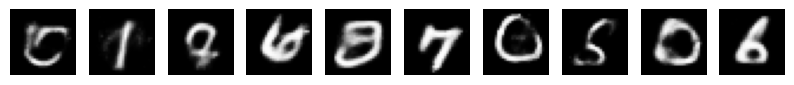

In [ ]:
# вспомните про замечание из этого же пункта обычного AE про распределение латентных переменных
# Посчитаем мат. ожидание, единичной дисперсии вроде бы должно хватить (для более-менее хорошего качества)
s = torch.zeros(features)
count = 0
with torch.no_grad():
  autoencoder.eval()
  for images, labels in train_loader:
    count += len(labels)
    mu, _ = autoencoder.encode(images.to(device))
    s += torch.sum(mu, axis=0).cpu()

s /= count

z = torch.tensor([np.random.normal(s, 1, features) for i in range(10)]).float().to(device)
with torch.no_grad():
  autoencoder.eval()
  output = autoencoder.decode(z).sigmoid().cpu()

cols_count = 10

fig, axes = plt.subplots(1, cols_count, figsize=(10, 3))

for i in range(cols_count):
  axes[i].imshow(output[i, 0, :, :], cmap='gray')
  axes[i].axis('off')

plt.show()

Ну, это похоже на числа. Лучшего выбить не смог.

## 2.2. Latent Representation (2 балла)

Давайте посмотрим, как латентные векторы картинок лиц выглядят в пространстве.
Ваша задача -- изобразить латентные векторы картинок точками в двумерном просторанстве.

Это позволит оценить, насколько плотно распределены латентные векторы изображений цифр в пространстве.

Плюс давайте сделаем такую вещь: покрасим точки, которые соответствуют картинкам каждой цифры, в свой отдельный цвет

Подсказка: красить -- это просто =) У plt.scatter есть параметр c (color), см. в документации.


Итак, план:
1. Получить латентные представления картинок тестового датасета
2. С помощтю `TSNE` (есть в `sklearn`) сжать эти представления до размерности 2 (чтобы можно было их визуализировать точками в пространстве)
3. Визуализировать полученные двумерные представления с помощью `matplotlib.scatter`, покрасить разными цветами точки, соответствующие картинкам разных цифр.

In [ ]:
from sklearn.manifold import TSNE

In [ ]:
latent = []
labels = []
with torch.no_grad():
  autoencoder.eval()
  for im, lab in test_loader:
    mu, logsigma = autoencoder.encode(im.to(device))
    latent.append(mu.cpu().numpy())
    labels.append(lab.numpy())
latent = np.vstack(latent)
labels = np.hstack(labels)

In [ ]:
tsne = TSNE(n_components=2)
latent_2d = tsne.fit_transform(latent)

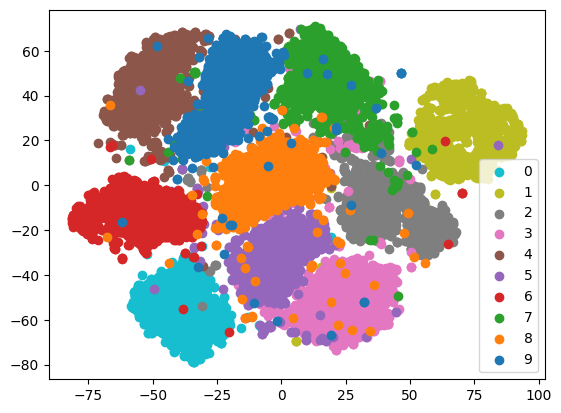

In [ ]:
colors = plt.cm.tab10_r
for d in range(10):
  m = labels == d
  plt.scatter(x=latent_2d[m, 0], y=latent_2d[m, 1], c=[colors(d)], label=d)
plt.legend()
plt.show()

Что вы думаете о виде латентного представления?

Классы неплохо сгруппировались. Даже для такой неидельной модели. Также можно заметить, что часто группы похожих чисел лежат вместе. Например, 8 и 9.

__Congrats v2.0!__

## 2.3. Conditional VAE (6 баллов)


Мы уже научились обучать обычный AE на датасете картинок и получать новые картинки, используя генерацию шума и декодер.
Давайте теперь допустим, что мы обучили AE на датасете MNIST и теперь хотим генерировать новые картинки с числами с помощью декодера (как выше мы генерили рандомные лица).
И вот нам понадобилось сгенерировать цифру 8, и мы подставляем разные варианты шума, но восьмерка никак не генерится:(

Хотелось бы добавить к нашему AE функцию "выдай мне рандомное число из вот этого вот класса", где классов десять (цифры от 0 до 9 образуют десять классов).  Conditional AE — так называется вид автоэнкодера, который предоставляет такую возможность. Ну, название "conditional" уже говорит само за себя.

И в этой части задания мы научимся такие обучать.

### Архитектура

На картинке ниже представлена архитектура простого Conditional VAE.

По сути, единственное отличие от обычного -- это то, что мы вместе с картинкой в первом слое энкодера и декодера передаем еще информацию о классе картинки.

То есть, в первый (входной) слой энкодера подается конкатенация картинки и информации о классе (например, вектора из девяти нулей и одной единицы). В первый слой декодера подается конкатенация латентного вектора и информации о классе.


![alt text](https://sun9-63.userapi.com/impg/Mh1akf7mfpNoprrSWsPOouazSmTPMazYYF49Tw/djoHNw_9KVA.jpg?size=1175x642&quality=96&sign=e88baec5f9bb91c8443fba31dcf0a4df&type=album)

![alt text](https://sun9-73.userapi.com/impg/UDuloLNKhzTBYAKewgxke5-YPsAKyGOqA-qCRg/MnyCavJidxM.jpg?size=1229x651&quality=96&sign=f2d21bfacc1c5755b76868dc4cfef39c&type=album)



На всякий случай: это VAE, то есть, latent у него все еще состоит из mu и sigma

Таким образом, при генерации новой рандомной картинки мы должны будем передать декодеру сконкатенированные латентный вектор и класс картинки.

P.S. Также можно передавать класс картинки не только в первый слой, но и в каждый слой сети. То есть на каждом слое конкатенировать выход из предыдущего слоя и информацию о классе.

In [ ]:
class CVAE(nn.Module):
    def __init__(self, latent_dim=64, classes_dim=10):
         # <определите архитектуры encoder и decoder
        # помните, у encoder должны быть два "хвоста",
        # т.е. encoder должен кодировать картинку в 2 переменные -- mu и logsigma>
        super(CVAE, self).__init__()
        self.classes_dim = classes_dim
        self.encoder = nn.Sequential(
            nn.Flatten(),
            nn.Linear(1*28*28, 1024),
            nn.ReLU()
        )
        self.encoder_mu = nn.Linear(1024, latent_dim)
        self.encoder_logsigma = nn.Linear(1024, latent_dim)
        self.decoder = nn.Sequential(
            nn.Linear(latent_dim + classes_dim, 1024),
            nn.ReLU(),
            nn.Linear(1024, 1*28*28),
            nn.Unflatten(1, (1, 28, 28)),
            nn.Sigmoid()
        )

    def encode(self, x, class_num):
        # <реализуйте forward проход энкодера
        # в качестве возвращаемых переменных -- mu, logsigma и класс картинки>
        intermediate = self.encoder(x)
        mu = self.encoder_mu(intermediate)
        logsigma = self.encoder_logsigma(intermediate)
        return mu, logsigma, class_num

    def gaussian_sampler(self, mu, logsigma):
        if self.training:
            # засемплируйте латентный вектор из нормального распределения с параметрами mu и sigma
            std = torch.exp(0.5 * logsigma)
            eps = torch.randn_like(std)
            sample = mu + (eps * std)
            return sample
        else:
            # на инференсе возвращаем не случайный вектор из нормального распределения, а центральный -- mu.
            # на инференсе выход автоэнкодера должен быть детерминирован.
            return mu

    def decode(self, z, class_num):
        # реализуйте forward проход декодера
        # в качестве возвращаемой переменной -- reconstruction
        one_hot = F.one_hot(class_num, self.classes_dim).to(device)
        x = torch.cat((z, one_hot), dim=1)
        reconstruction = self.decoder(x)
        return reconstruction

    def forward(self, x, class_num):
        # используя encode и decode, реализуйте forward проход автоэнкодера
        # в качестве ваозвращаемых переменных -- mu, logsigma и reconstruction
        mu, logsigma, class_num = self.encode(x, class_num)
        z = self.gaussian_sampler(mu, logsigma)
        reconstruction = self.decode(z, class_num)
        return mu, logsigma, reconstruction

In [ ]:
def KL_divergence(mu, logsigma):
    """
    часть функции потерь, которая отвечает за "близость" латентных представлений разных людей
    """
    loss = -0.5 * torch.sum(1 + logsigma - mu.pow(2) - logsigma.exp())
    return loss

def log_likelihood(x, reconstruction):
    """
    часть функции потерь, которая отвечает за качество реконструкции (как mse в обычном autoencoder)
    """
    # Тут верну обычный BCE
    loss = nn.BCELoss(reduction='sum')
    # loss = nn.BCEWithLogitsLoss(reduction='sum')
    return loss(reconstruction, x)

def loss_vae(x, mu, logsigma, reconstruction):
    return KL_divergence(mu, logsigma) + log_likelihood(x, reconstruction)

In [ ]:
criterion = loss_vae

autoencoder = CVAE().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters())

In [ ]:
epochs = 30
train_loss = []
test_loss = []

for epoch in range(epochs):
  autoencoder.train()
  cur_train_loss = 0.0
  for images, labels in train_loader:
    optimizer.zero_grad()
    images = images.to(device)
    mu, logsigma, reconstruction = autoencoder(images, labels)
    l = criterion(images, mu, logsigma, reconstruction)
    l.backward()
    optimizer.step()
    cur_train_loss += l.detach().cpu().item()
  cur_train_loss /= len(train_loader)

  autoencoder.eval()
  cur_test_loss = 0.0
  with torch.no_grad():
    for images, labels in test_loader:
      images = images.to(device)
      mu, logsigma, reconstruction = autoencoder(images, labels)
      l = criterion(images, mu, logsigma, reconstruction)
      cur_test_loss += l.detach().cpu().item()
  cur_test_loss /= len(test_loader)

  train_loss.append(cur_train_loss)
  test_loss.append(cur_test_loss)
  print(f"Epoch: {epoch + 1}; train loss: {cur_train_loss:.4f}; val loss: {cur_test_loss:.4f}")

Epoch: 1; train loss: 4230.3358; val loss: 3303.4960
Epoch: 2; train loss: 3547.1773; val loss: 3147.4004
Epoch: 3; train loss: 3437.9115; val loss: 3085.2699
Epoch: 4; train loss: 3387.3876; val loss: 3042.3575
Epoch: 5; train loss: 3353.4821; val loss: 3029.9198
Epoch: 6; train loss: 3329.6659; val loss: 3010.7549
Epoch: 7; train loss: 3310.6179; val loss: 2989.5301
Epoch: 8; train loss: 3296.0615; val loss: 2990.5050
Epoch: 9; train loss: 3280.5561; val loss: 2987.2570
Epoch: 10; train loss: 3270.5286; val loss: 2967.7166
Epoch: 11; train loss: 3260.4379; val loss: 2960.2830
Epoch: 12; train loss: 3251.3444; val loss: 2970.3663
Epoch: 13; train loss: 3243.3217; val loss: 2971.8261
Epoch: 14; train loss: 3234.4109; val loss: 2965.8103
Epoch: 15; train loss: 3228.5036; val loss: 2937.6104
Epoch: 16; train loss: 3222.2845; val loss: 2954.1712
Epoch: 17; train loss: 3218.0347; val loss: 2933.4532
Epoch: 18; train loss: 3212.5590; val loss: 2958.3085
Epoch: 19; train loss: 3205.5005; val

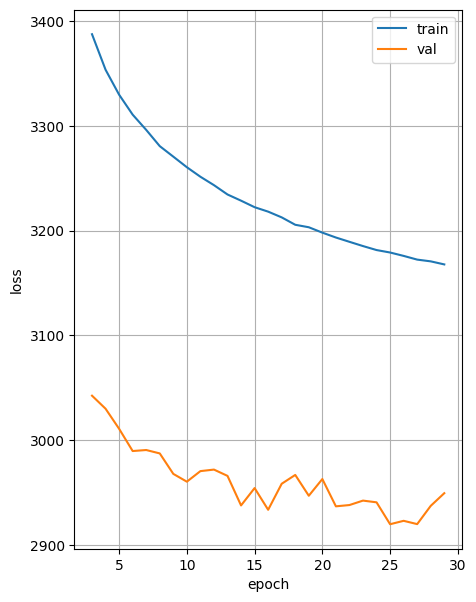

In [ ]:
start_epoch = 3
plt.figure(figsize=(5,7))
plt.plot(range(start_epoch, len(train_loss)), train_loss[start_epoch:], label='train')
plt.plot(range(start_epoch, len(test_loss)), test_loss[start_epoch:], label='val')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend()
plt.grid()
plt.show()

### Sampling


Тут мы будем сэмплировать из CVAE. Это прикольнее, чем сэмплировать из простого AE/VAE: тут можно взять один и тот же латентный вектор и попросить CVAE восстановить из него картинки разных классов!
Для MNIST вы можете попросить CVAE восстановить из одного латентного вектора, например, картинки цифры 5 и 7.

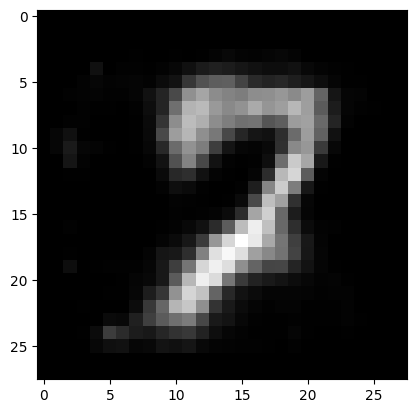

In [ ]:
z = torch.randn((1, 64))
class_num = torch.tensor([7])
with torch.no_grad():
  autoencoder.eval()
  out = autoencoder.decode(z.to(device), class_num)

plt.imshow(out[0, 0].cpu(), cmap='gray')

Это уже вполне похоже на семерку.

Splendid! Вы великолепны!


### Latent Representations

Давайте посмотрим, как выглядит латентное пространство картинок в CVAE и сравним с картинкой для VAE =)

Опять же, нужно покрасить точки в разные цвета в зависимости от класса.

In [ ]:
from sklearn.manifold import TSNE

In [ ]:
latent = []
labels = []
with torch.no_grad():
  autoencoder.eval()
  for im, lab in test_loader:
    mu, logsigma, _ = autoencoder(im.to(device), lab)
    latent.append(mu.cpu().numpy())
    labels.append(lab.numpy())
latent = np.vstack(latent)
labels = np.hstack(labels)

In [ ]:
tsne = TSNE(n_components=2)
latent_2d = tsne.fit_transform(latent)

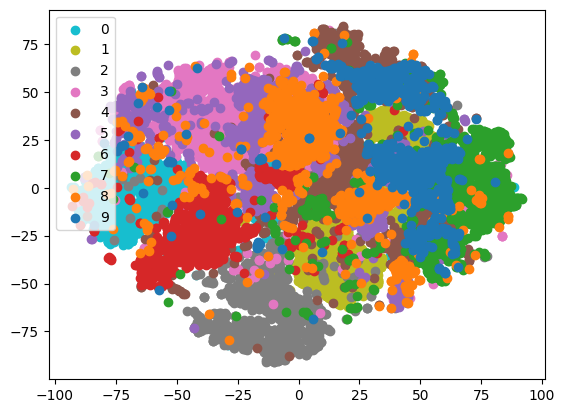

In [ ]:
colors = plt.cm.tab10_r
for d in range(10):
  m = labels == d
  plt.scatter(x=latent_2d[m, 0], y=latent_2d[m, 1], c=[colors(d)], label=d)
plt.legend()
plt.show()

Что вы думаете насчет этой картинки? Отличается от картинки для VAE?

Тут всё сильно хуже. Хотя встречаются и достаточно большие группы одного класса. Скорее всего, структура портится (по сравнению с обычным VAE) из-за того, что нужна для определения класса информация зашита уже не в латентных векторах.

# BONUS 1: Denoising (2 балла)

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

У автоэнкодеров, кроме сжатия и генерации изображений, есть другие практические применения. Про одно из них эта бонусная часть задания.

Автоэнкодеры могут быть использованы для избавления от шума на фотографиях (denoising). Для этого их нужно обучить специальным образом: input картинка будет зашумленной, а выдавать автоэнкодер должен будет картинку без шума.
То есть, loss-функция AE останется той же (MSE между реальной картинкой и выданной), а на вход автоэнкодеру будет подаваться зашумленная картинка.

<a href="https://ibb.co/YbRJ1nZ"><img src="https://i.ibb.co/0QD164t/Screen-Shot-2020-06-04-at-4-49-50-PM.png" alt="Screen-Shot-2020-06-04-at-4-49-50-PM" border="0"></a>

Для этого нужно взять ваш любимый датасет (датасет лиц из первой части этого задания или любой другой) и сделать копию этого датасета с шумом.

В питоне шум можно добавить так:

In [ ]:
# noise_factor = 0.5
# X_noisy = X + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=X.shape)

In [ ]:
def add_noise(tensor: torch.Tensor, noise_factor: float=0.5, device=device):
  # Картинки хранятся в виде числе от 0 до 255
  res = tensor + (noise_factor * 255) * torch.rand_like(tensor, device=device)
  return res.clip(0, 255)

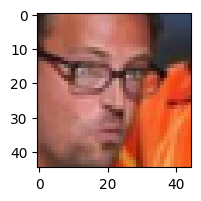

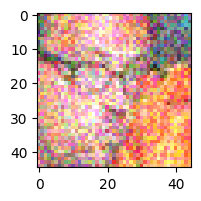

In [ ]:
example = next(iter(train_loader))[0]
example_noise = add_noise(example, noise_factor=0.5)

plt.figure(figsize=(2, 2))
plt.imshow(example[0].cpu().permute(1, 2, 0).type(torch.int))
plt.show()
plt.figure(figsize=(2, 2))
plt.imshow(example_noise[0].cpu().permute(1, 2, 0).type(torch.int))
plt.show()

In [ ]:
criterion = nn.MSELoss() # <loss>

autoencoder = Autoencoder().to(device)

optimizer = torch.optim.Adam(autoencoder.parameters()) # <Ваш любимый оптимизатор>

Epoch: 1; train loss: 2780792.4644; val loss: 207123.7700


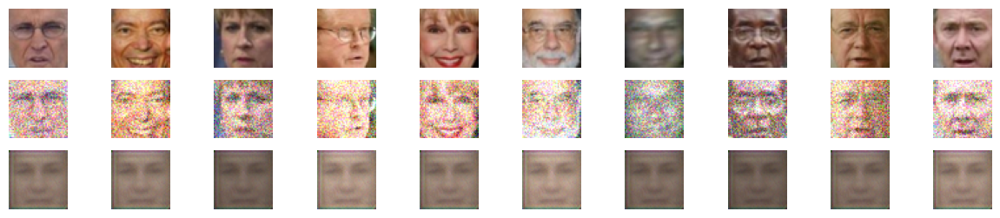

Epoch: 2; train loss: 282711.3440; val loss: 199073.9139


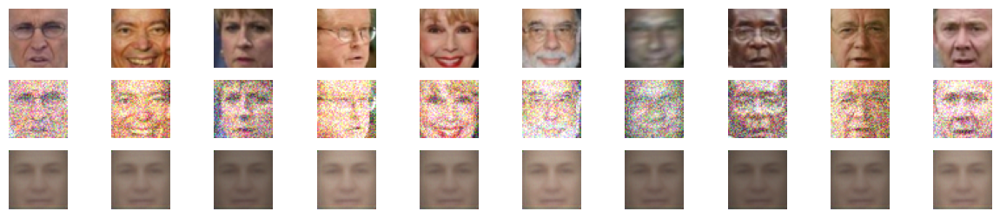

Epoch: 3; train loss: 263426.2860; val loss: 161018.2409


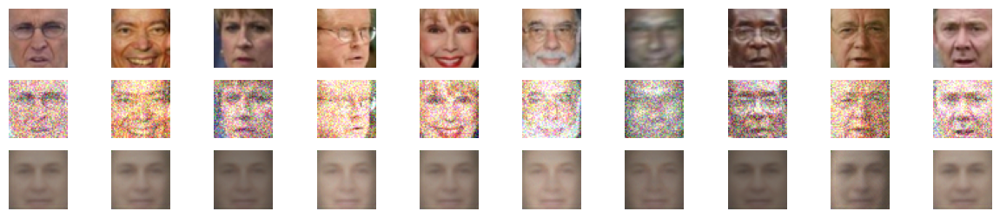

Epoch: 4; train loss: 233502.5914; val loss: 143320.3911


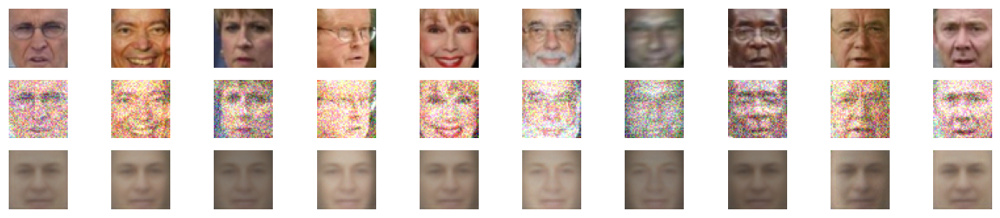

Epoch: 5; train loss: 219228.6911; val loss: 136092.0022


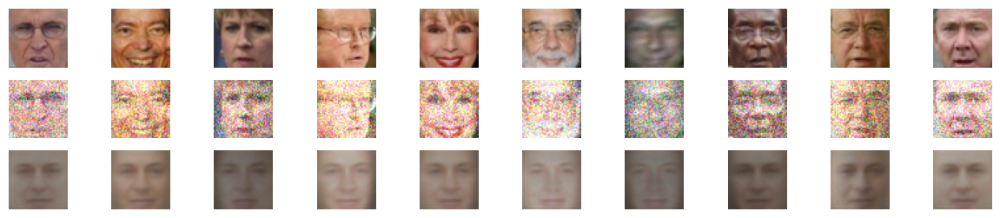

Epoch: 6; train loss: 210274.1245; val loss: 120025.4032


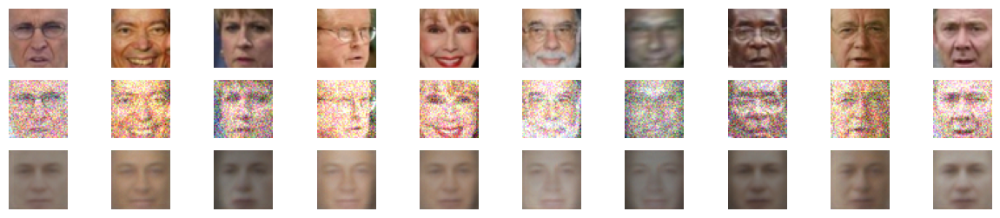

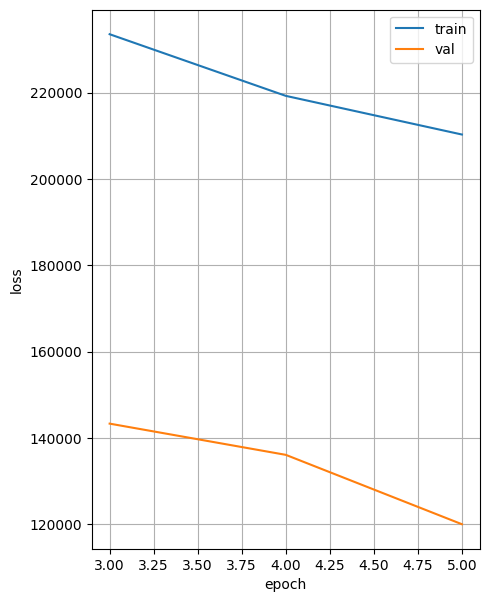

Epoch: 7; train loss: 196699.2640; val loss: 119499.1447


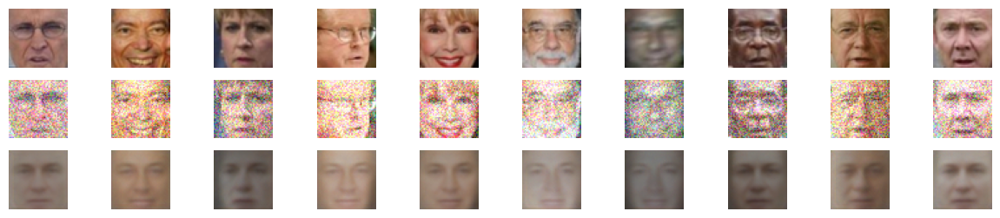

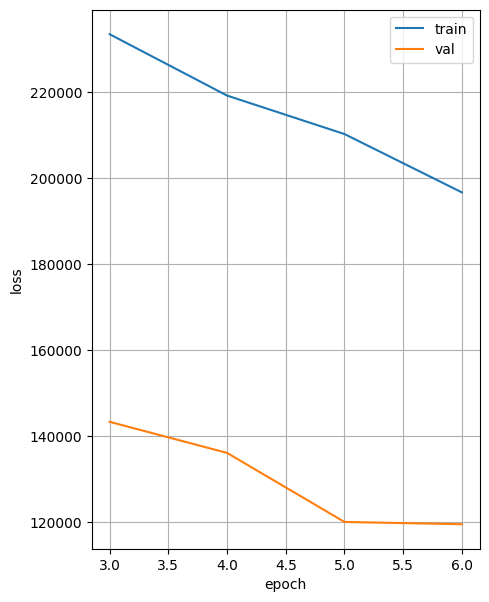

Epoch: 8; train loss: 189714.1840; val loss: 102070.5049


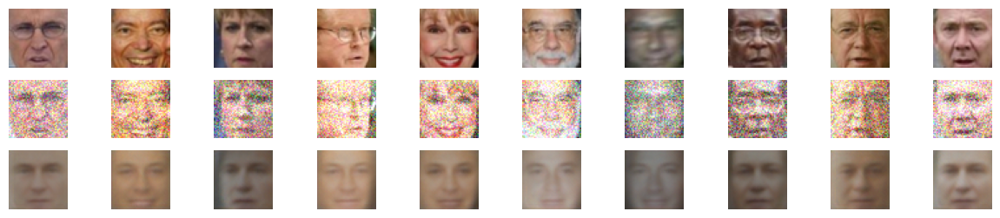

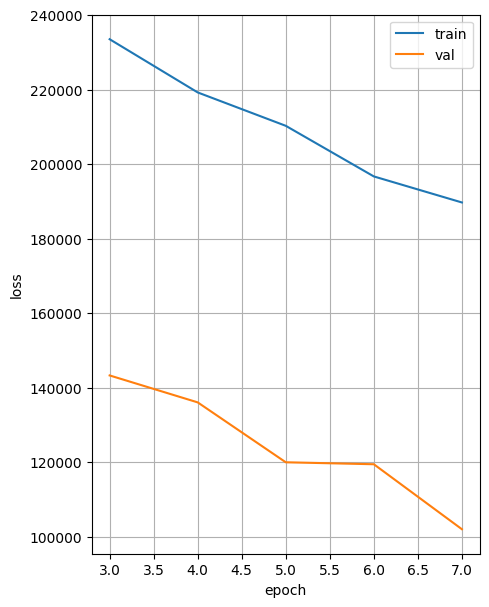

Epoch: 9; train loss: 184774.3889; val loss: 93994.7914


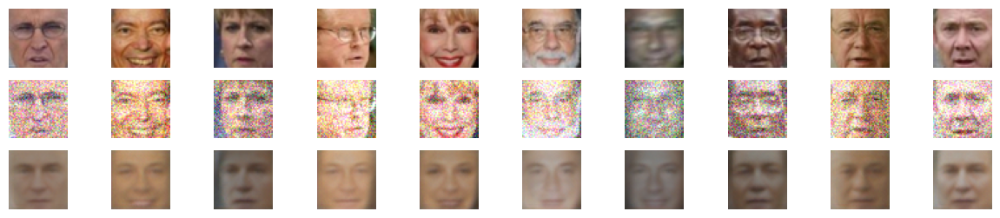

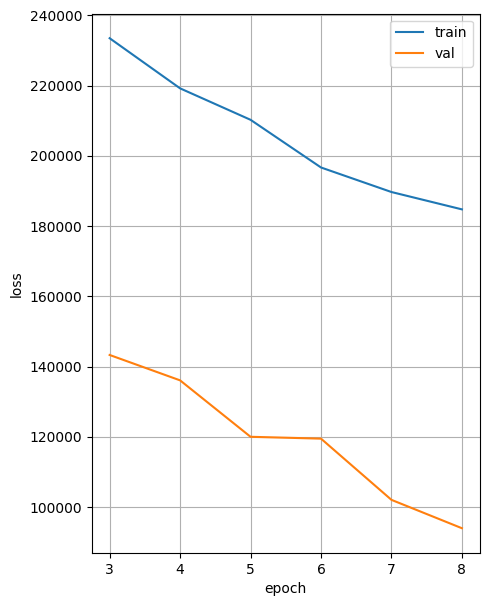

Epoch: 10; train loss: 179852.7088; val loss: 91673.7717


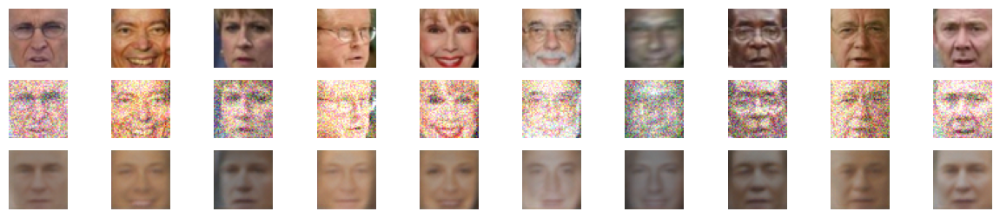

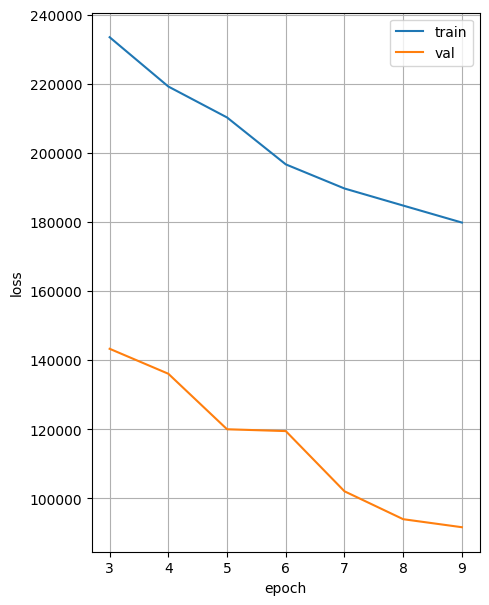

Epoch: 11; train loss: 176845.5668; val loss: 83748.0516


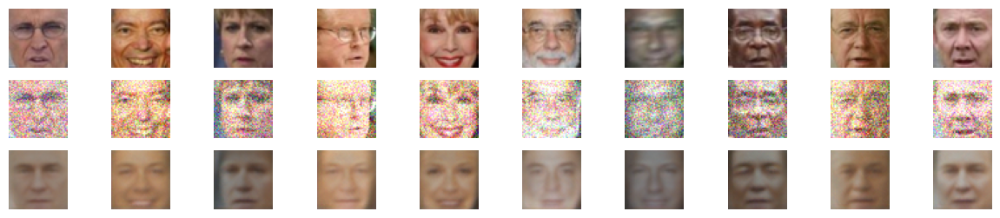

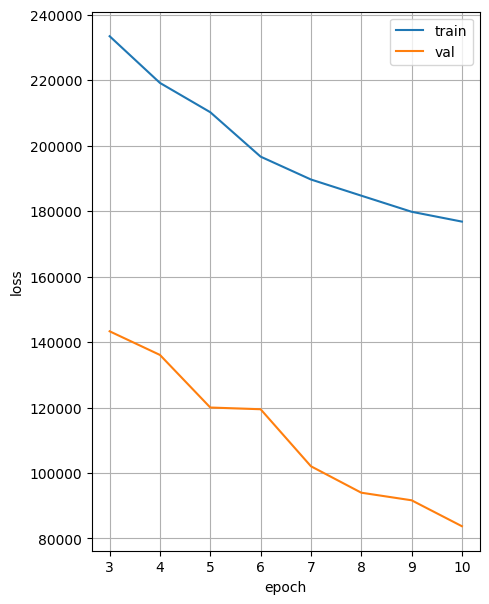

Epoch: 12; train loss: 174158.0440; val loss: 75652.7642


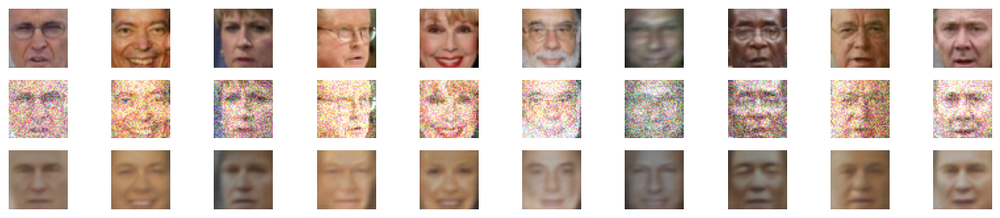

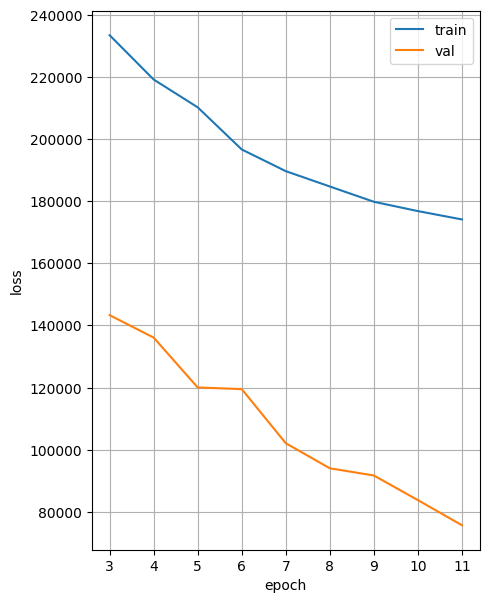

Epoch: 13; train loss: 171462.9887; val loss: 73952.5780


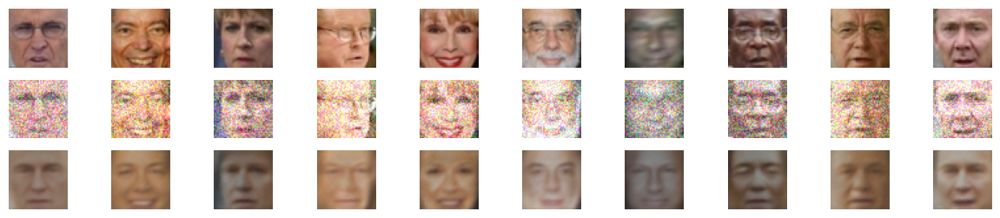

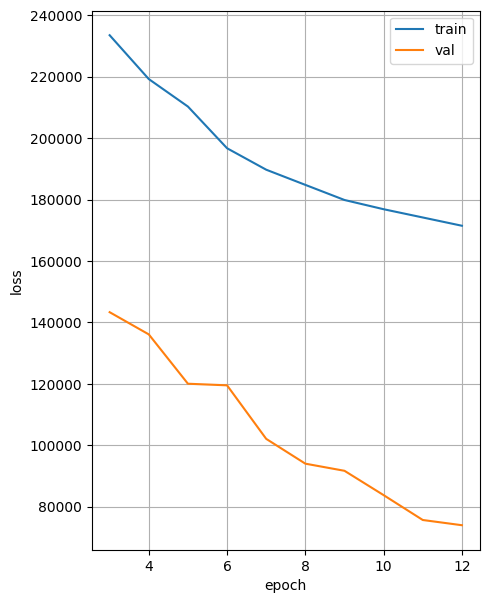

Epoch: 14; train loss: 168656.0005; val loss: 67441.8779


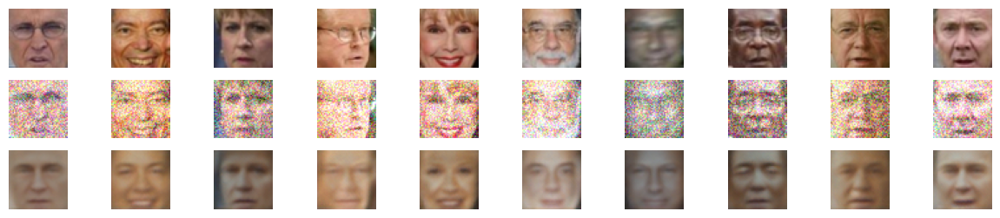

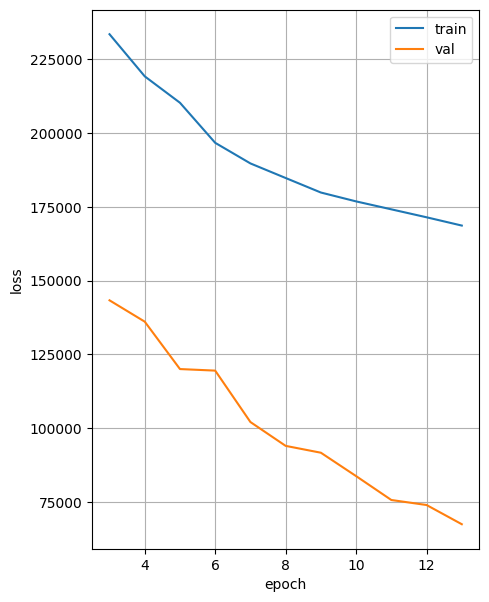

Epoch: 15; train loss: 168546.4546; val loss: 65568.5275


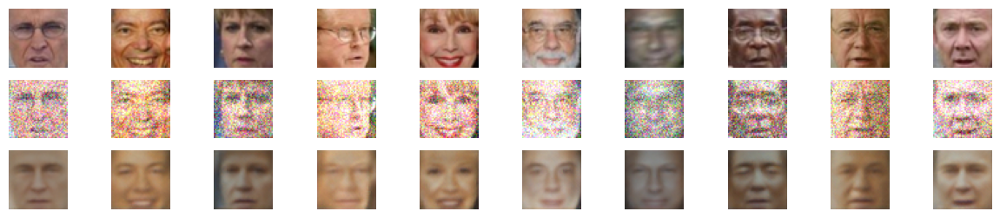

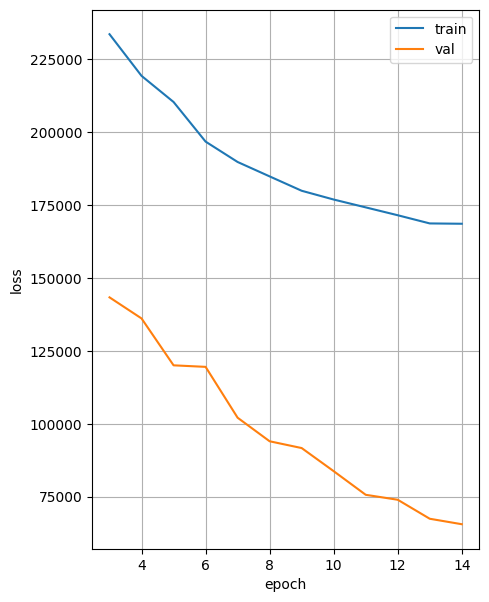

Epoch: 16; train loss: 164779.8426; val loss: 61938.5302


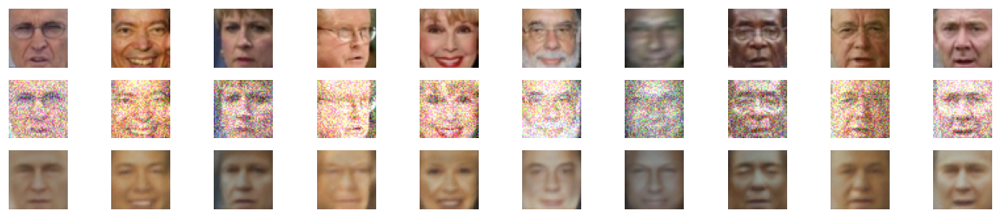

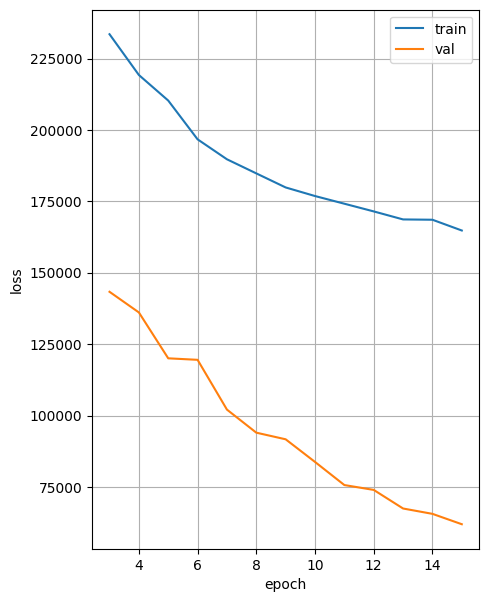

Epoch: 17; train loss: 164778.1703; val loss: 58828.3156


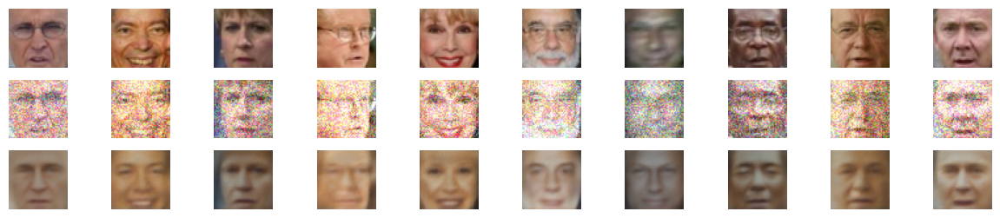

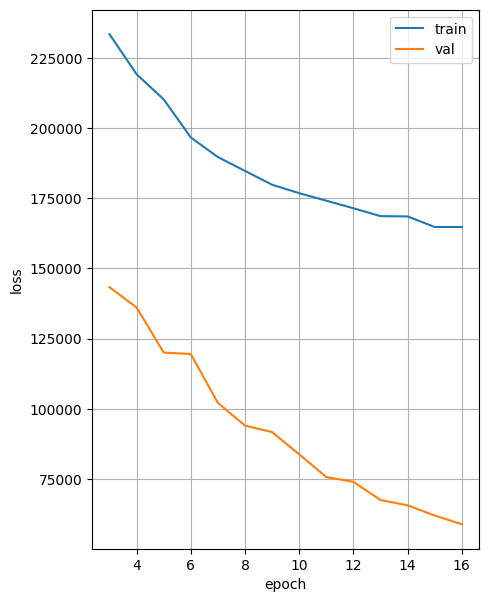

Epoch: 18; train loss: 162368.0019; val loss: 58088.9382


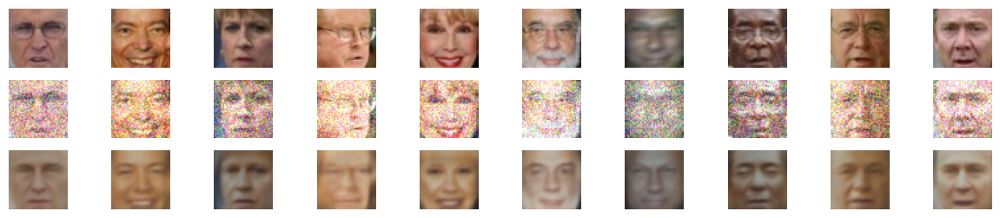

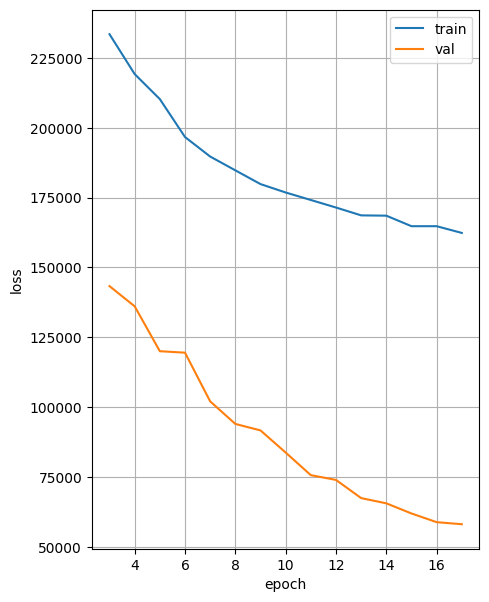

Epoch: 19; train loss: 161461.5360; val loss: 55109.8826


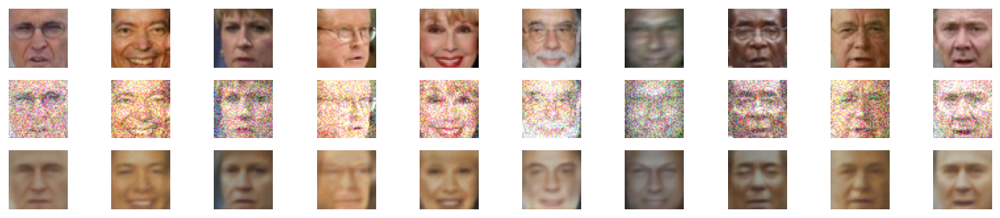

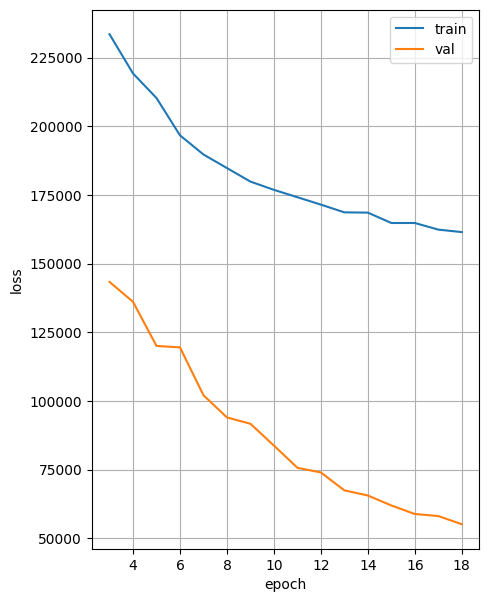

Epoch: 20; train loss: 161776.2346; val loss: 54168.7239


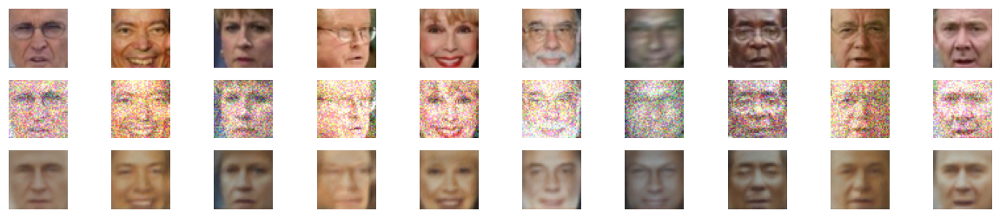

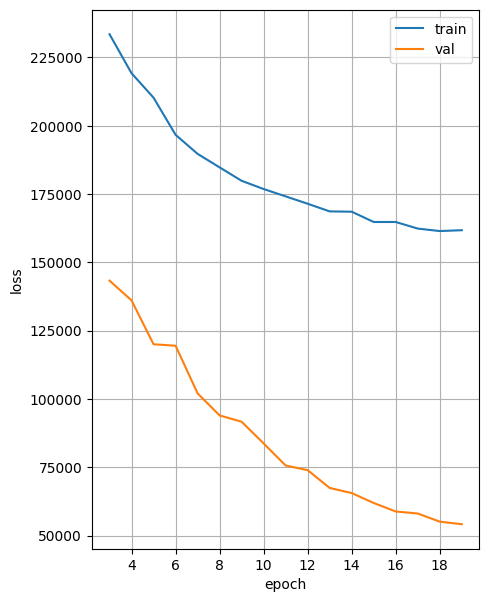

Epoch: 21; train loss: 159482.3353; val loss: 53258.3137


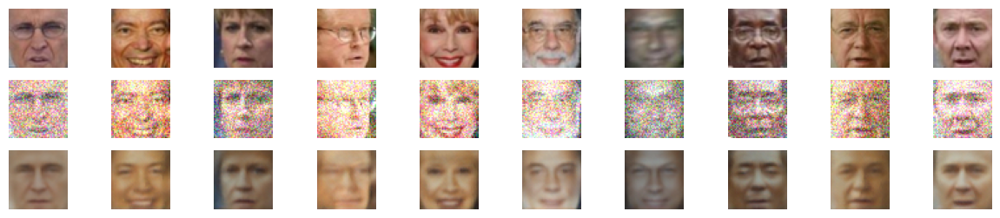

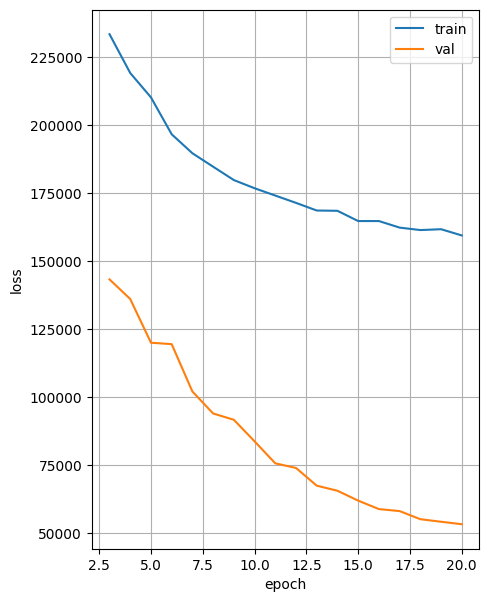

Epoch: 22; train loss: 158777.7155; val loss: 51461.1988


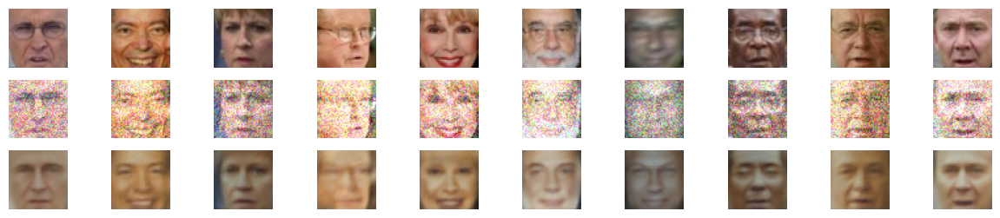

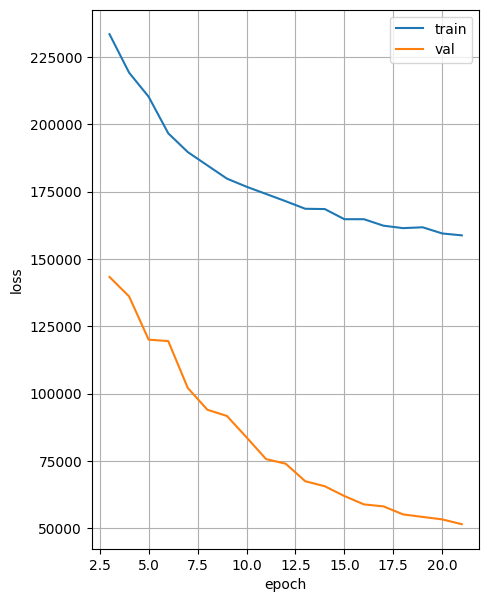

Epoch: 23; train loss: 160961.7605; val loss: 48302.9763


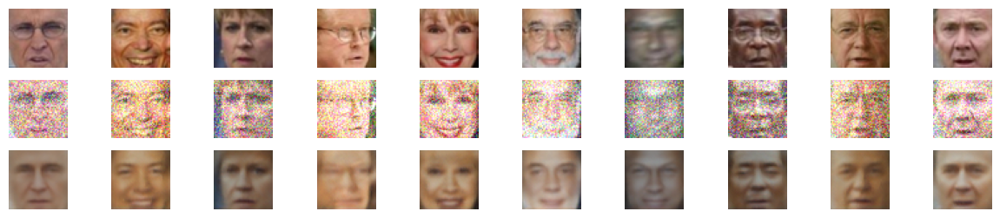

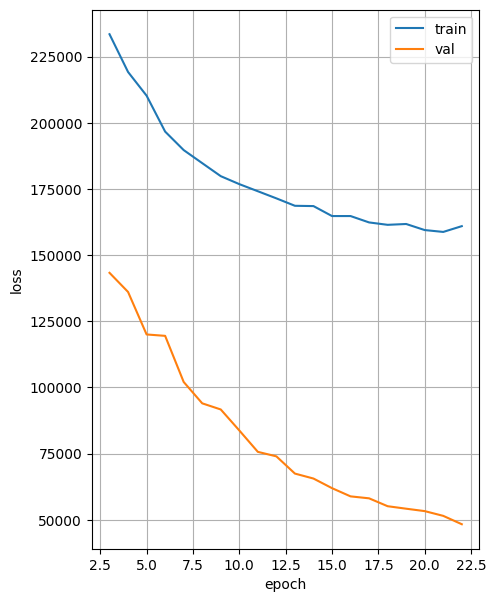

Epoch: 24; train loss: 156745.1772; val loss: 47436.0160


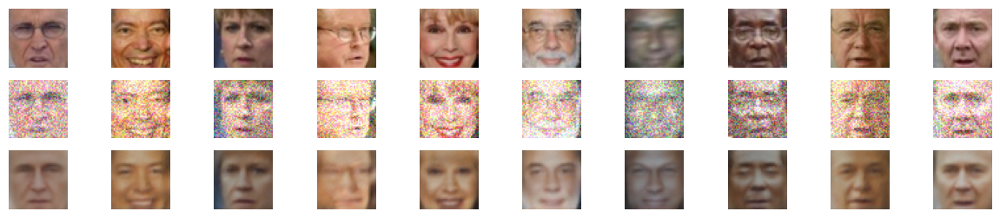

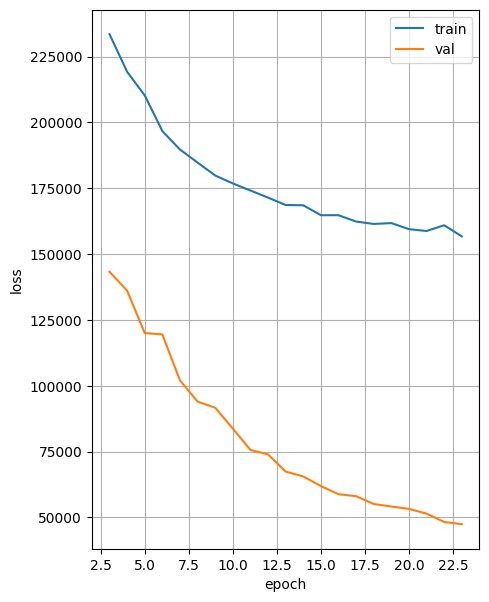

Epoch: 25; train loss: 156822.6588; val loss: 50194.1755


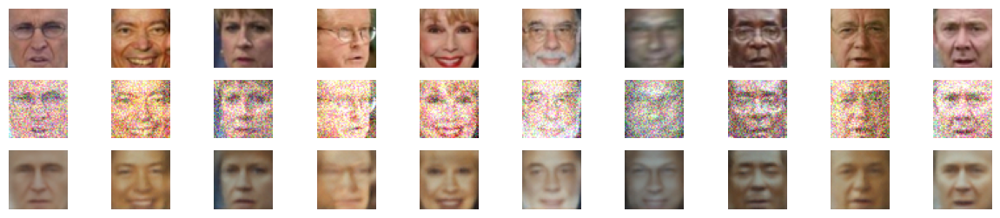

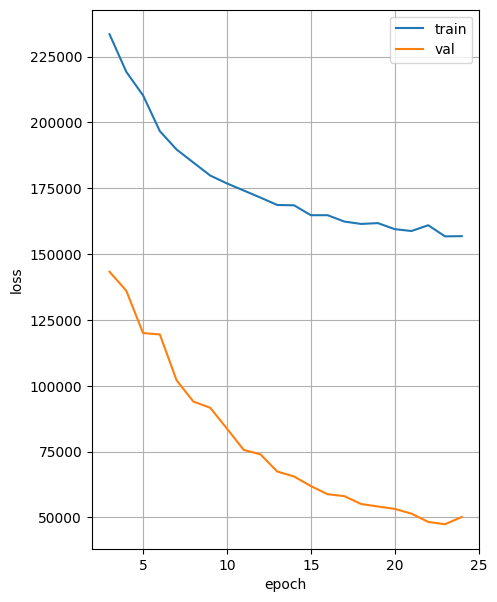

Epoch: 26; train loss: 157031.6202; val loss: 45613.3043


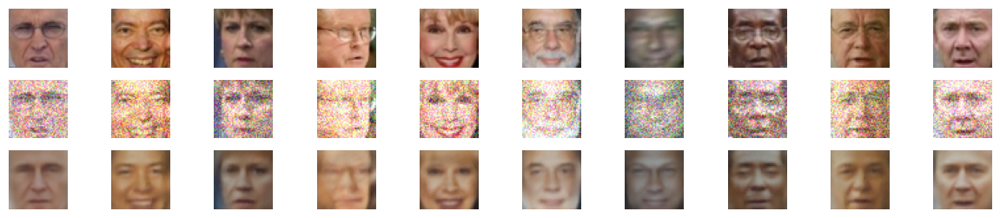

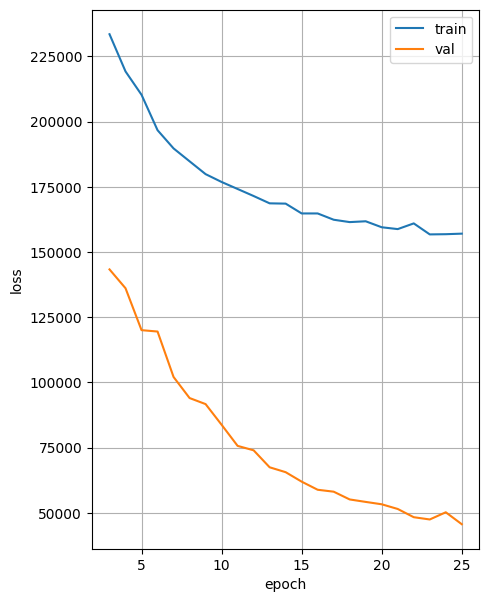

Epoch: 27; train loss: 155687.3231; val loss: 48444.7392


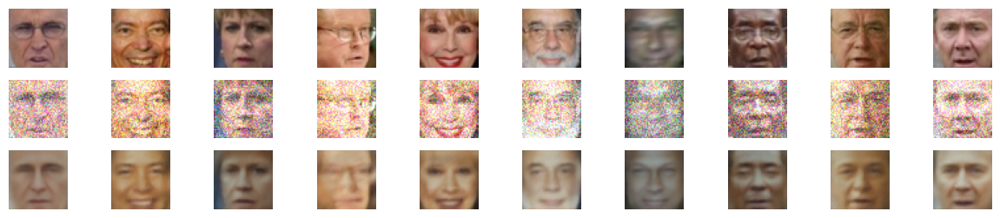

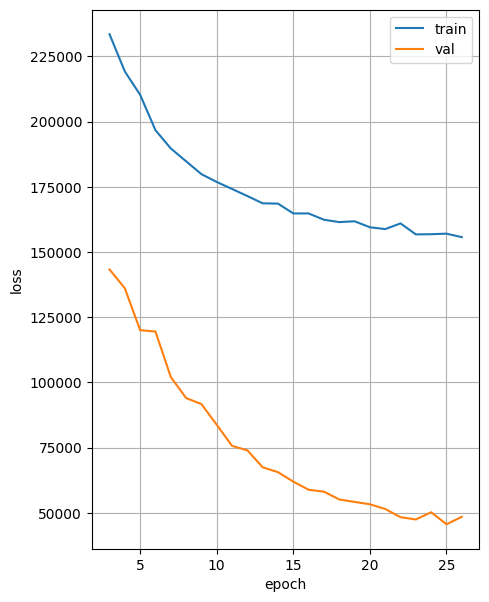

Epoch: 28; train loss: 155729.4186; val loss: 44038.4250


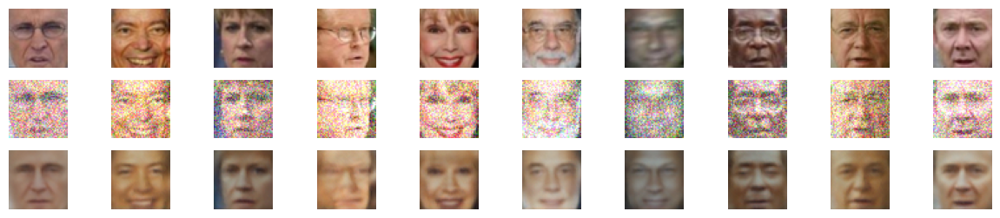

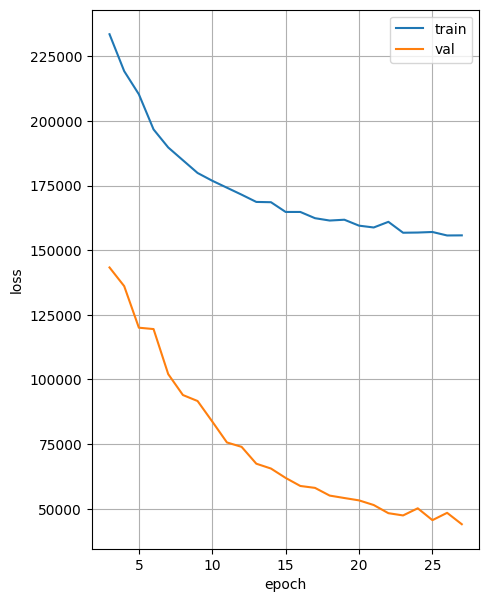

Epoch: 29; train loss: 154424.1652; val loss: 44054.6404


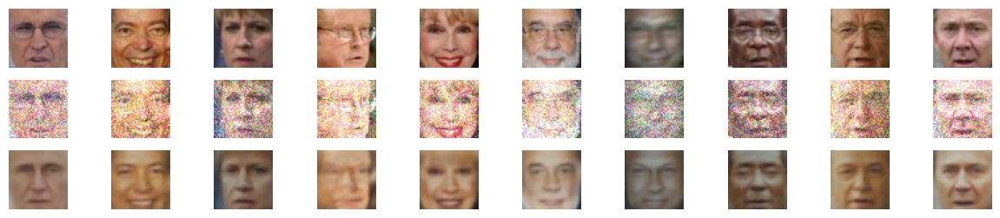

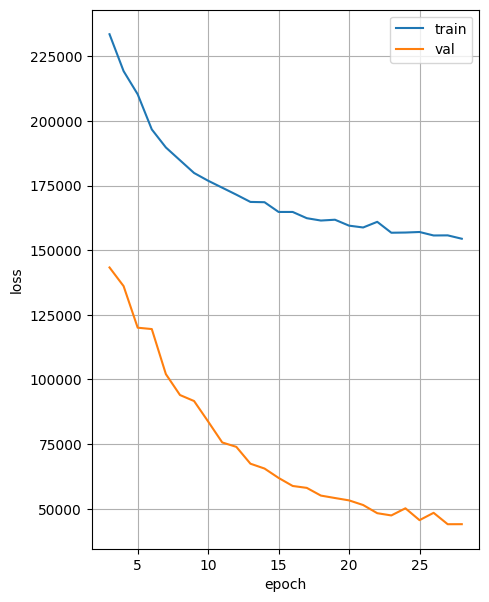

Epoch: 30; train loss: 153998.6057; val loss: 41549.7597


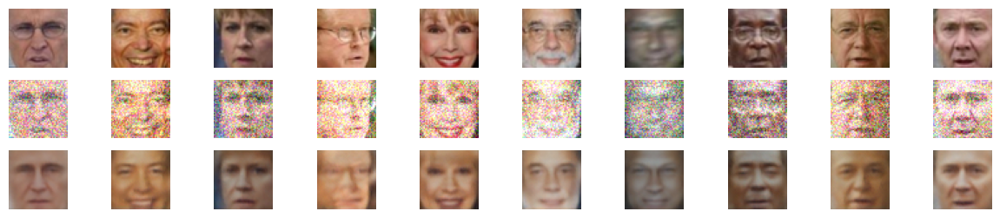

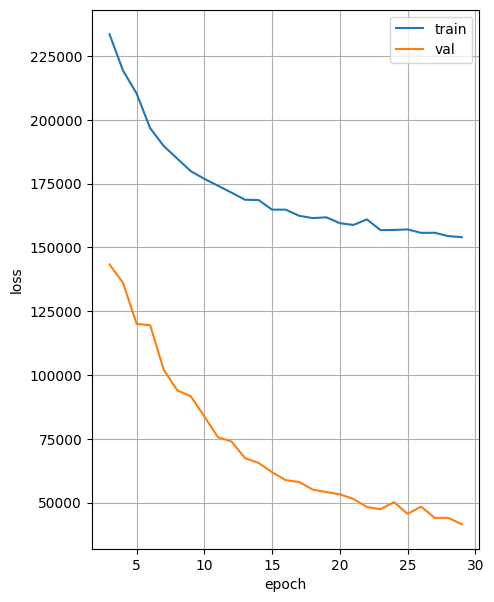

Epoch: 31; train loss: 153810.2014; val loss: 45450.5367


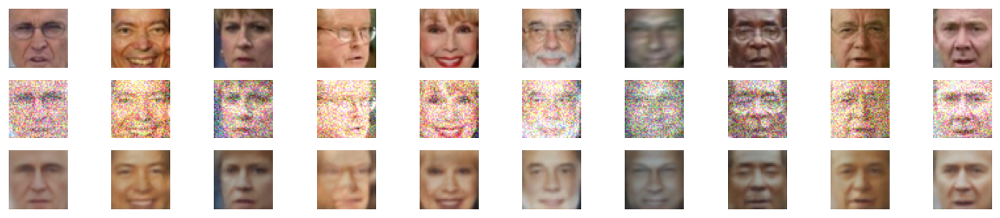

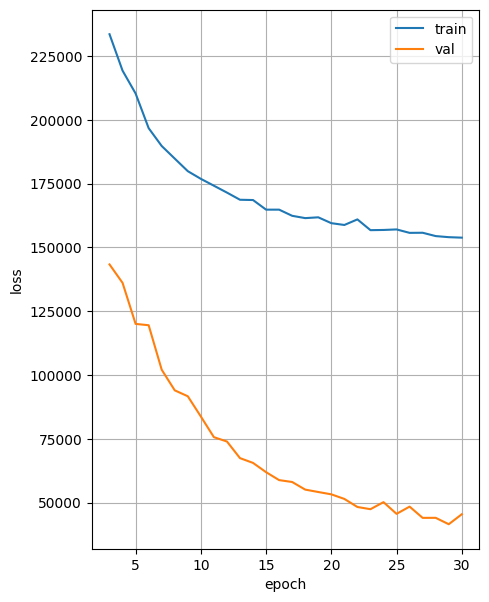

Epoch: 32; train loss: 153871.0909; val loss: 39931.1221


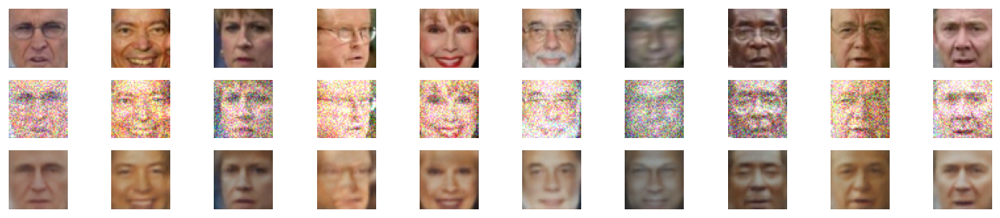

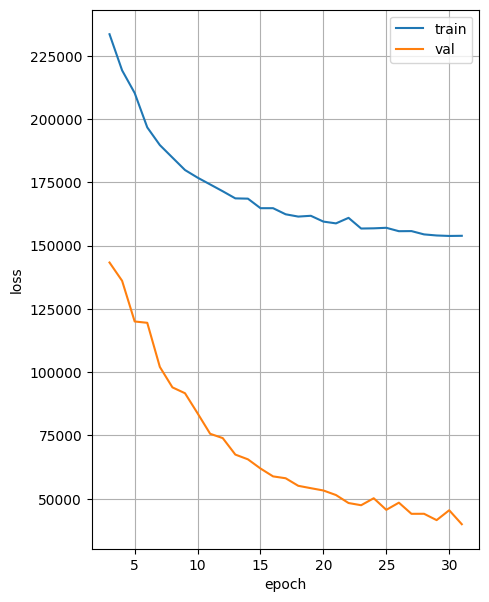

Epoch: 33; train loss: 152923.9227; val loss: 39431.9108


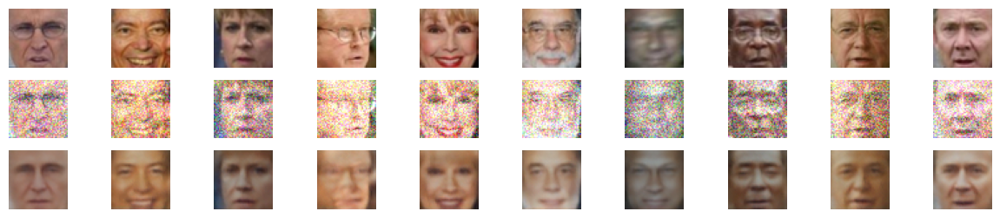

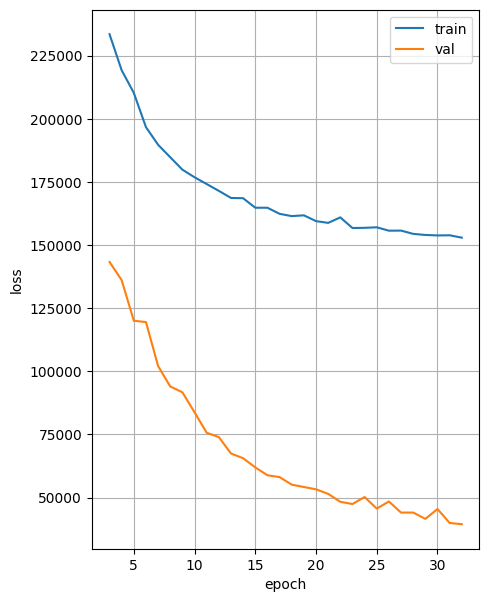

Epoch: 34; train loss: 153101.7753; val loss: 39456.1525


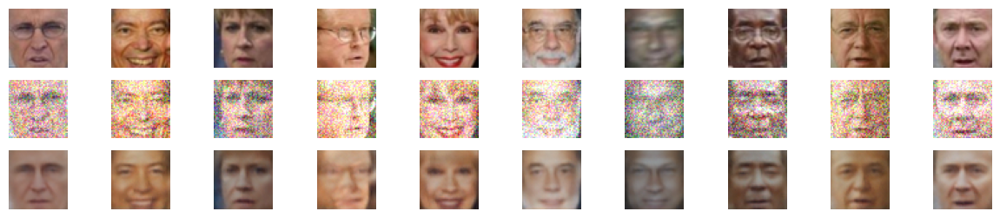

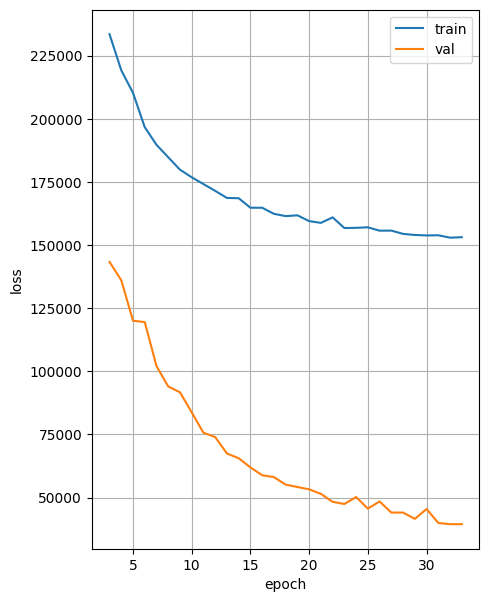

Epoch: 35; train loss: 152523.4958; val loss: 38235.4428


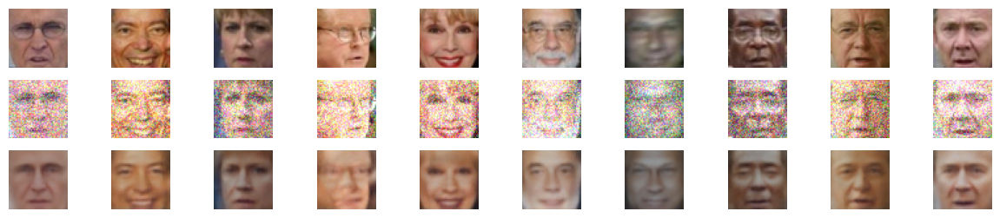

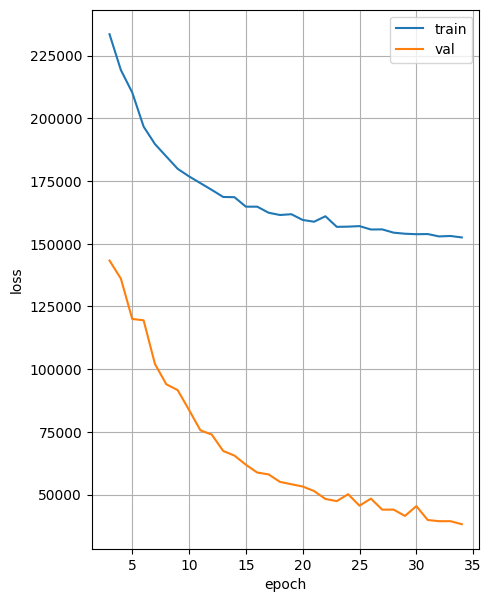

Epoch: 36; train loss: 152302.3921; val loss: 39627.1512


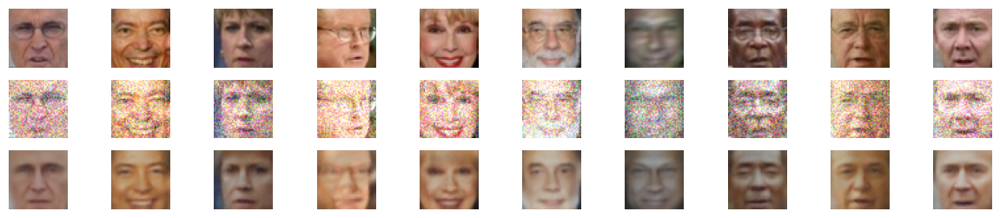

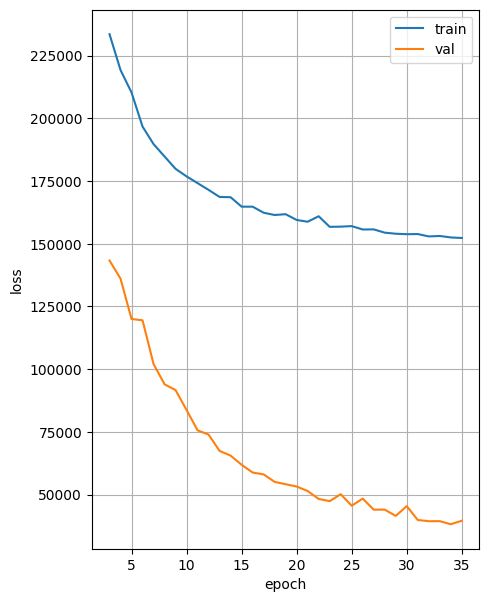

Epoch: 37; train loss: 151427.9670; val loss: 39755.6641


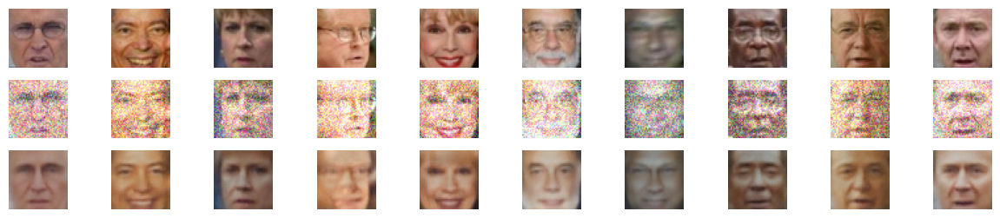

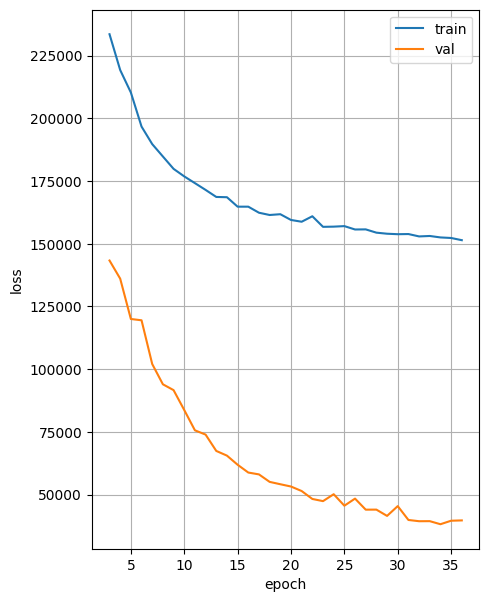

Epoch: 38; train loss: 152286.1734; val loss: 36864.8862


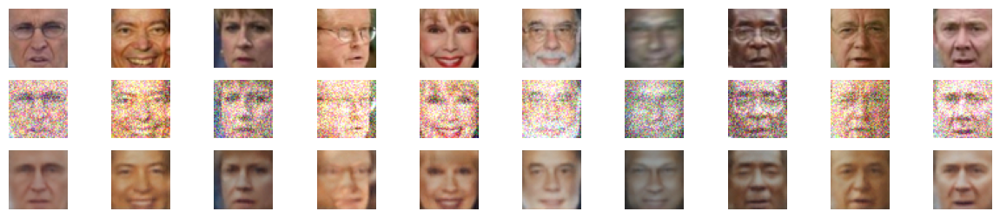

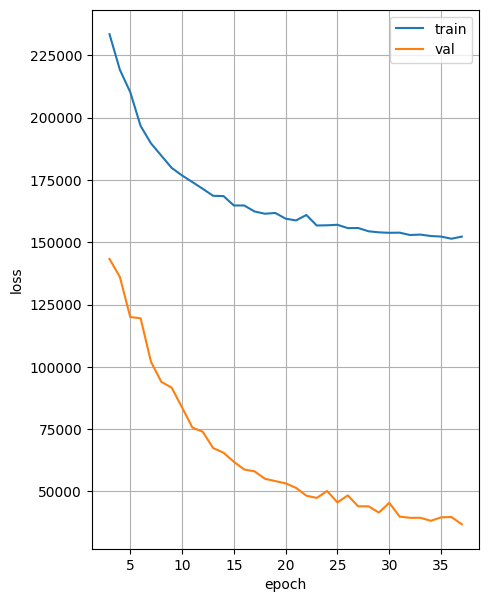

Epoch: 39; train loss: 151463.6312; val loss: 37458.8188


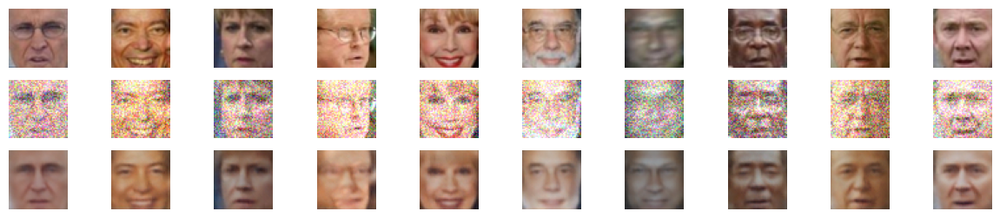

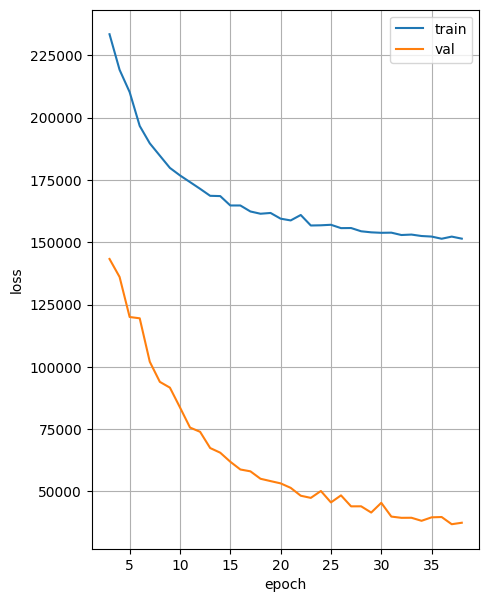

Epoch: 40; train loss: 151504.8865; val loss: 36417.1905


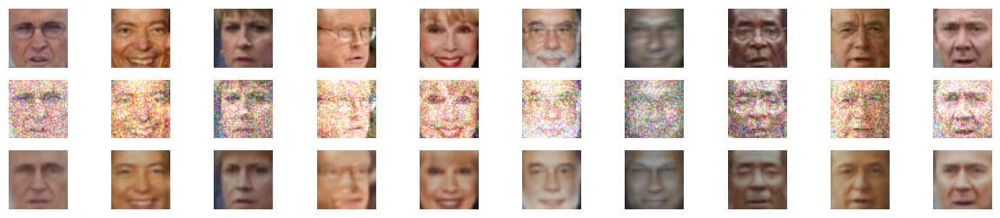

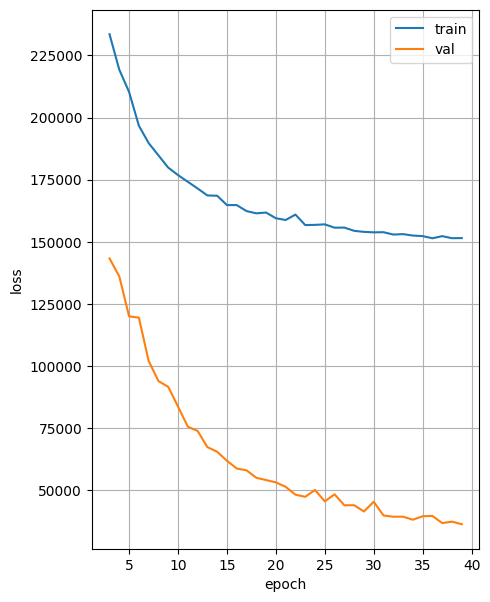

Epoch: 41; train loss: 150735.0418; val loss: 36912.2545


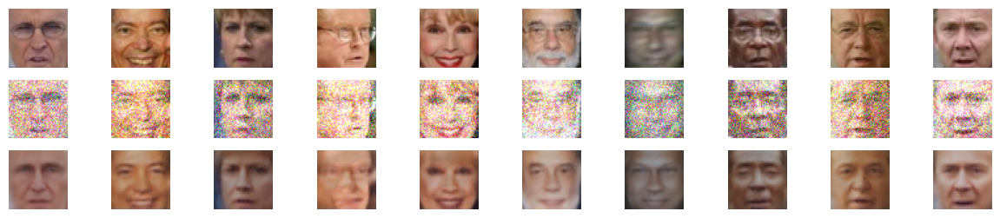

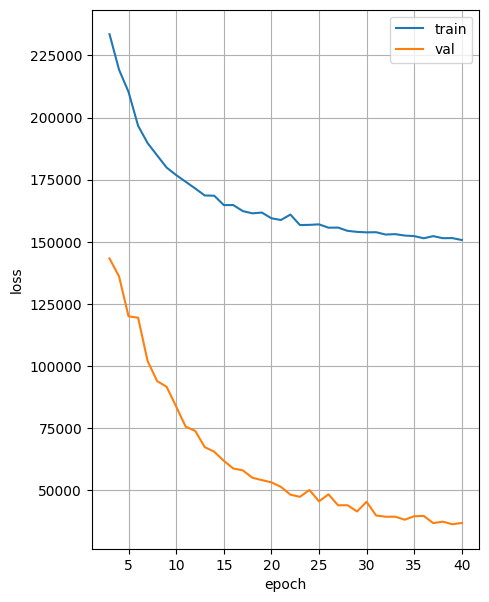

Epoch: 42; train loss: 150572.8421; val loss: 37885.8133


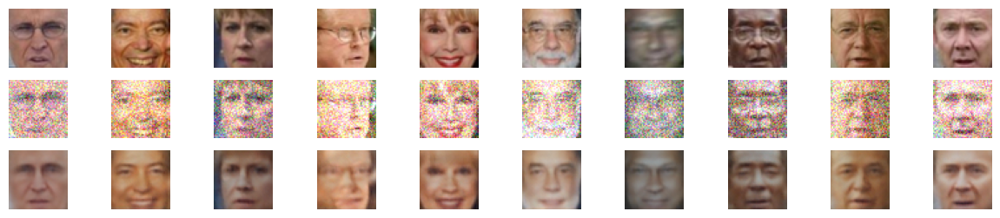

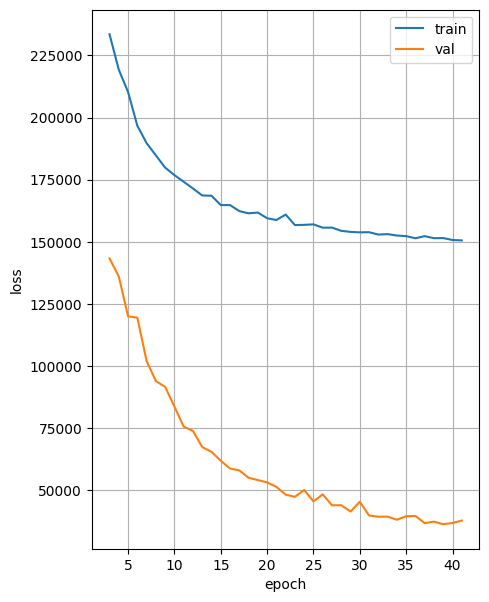

Epoch: 43; train loss: 150881.4690; val loss: 36231.4148


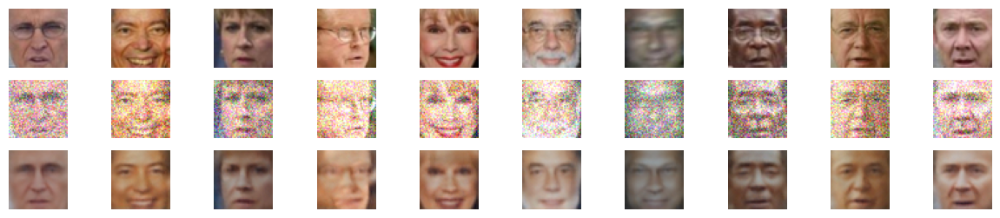

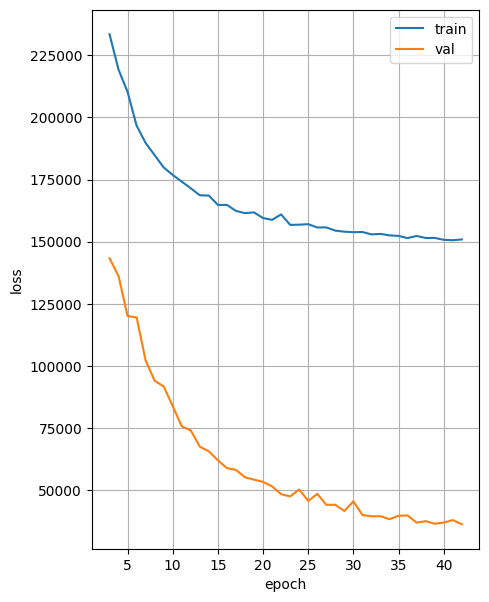

Epoch: 44; train loss: 150004.3594; val loss: 39783.2092


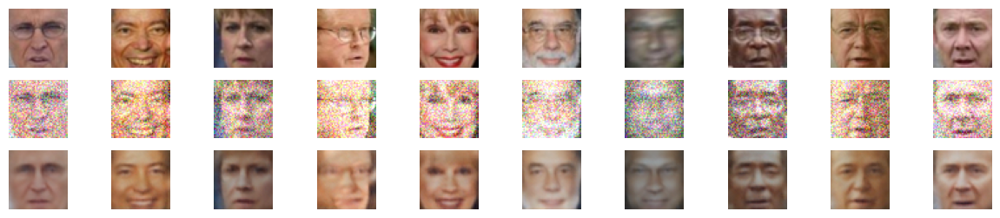

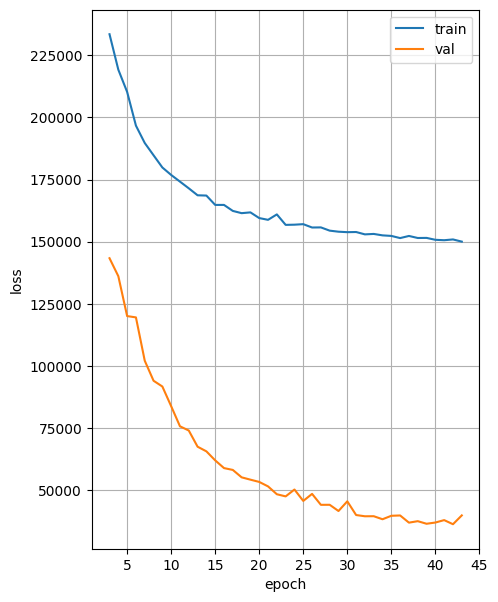

Epoch: 45; train loss: 150015.9209; val loss: 41219.5381


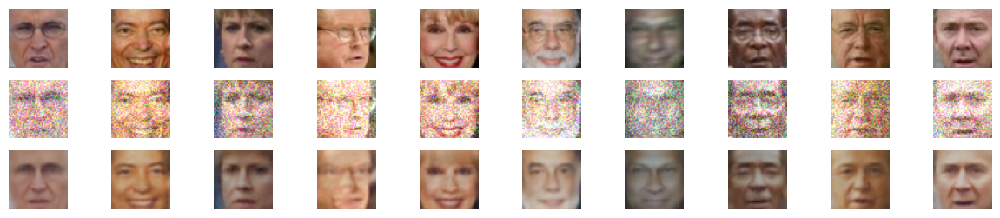

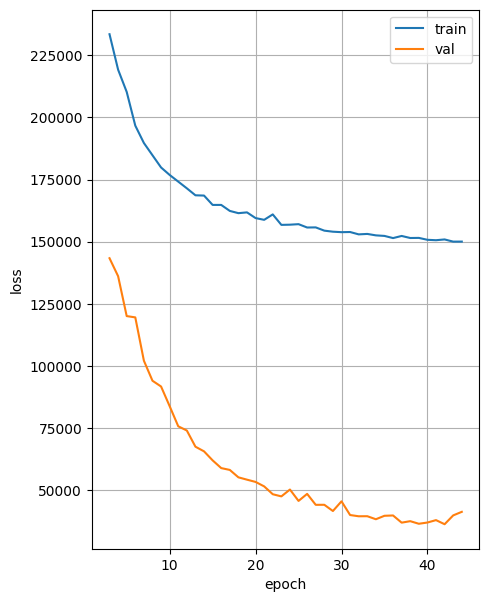

Epoch: 46; train loss: 150339.9884; val loss: 35995.5404


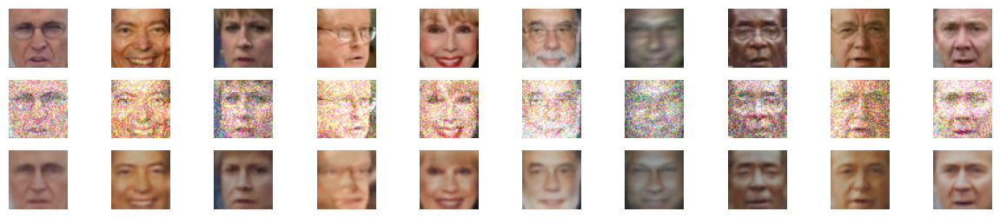

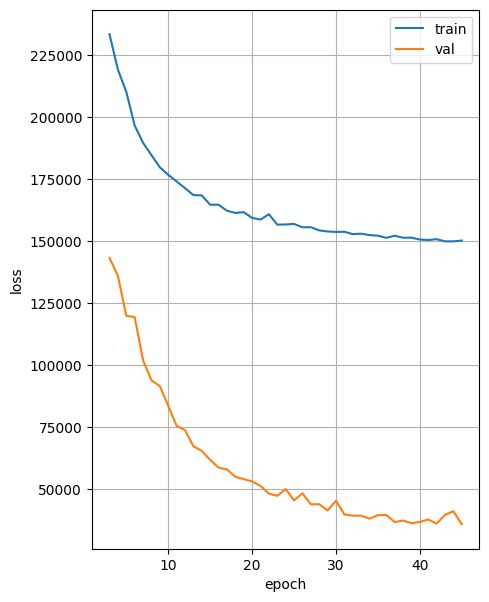

Epoch: 47; train loss: 150985.0634; val loss: 39311.7163


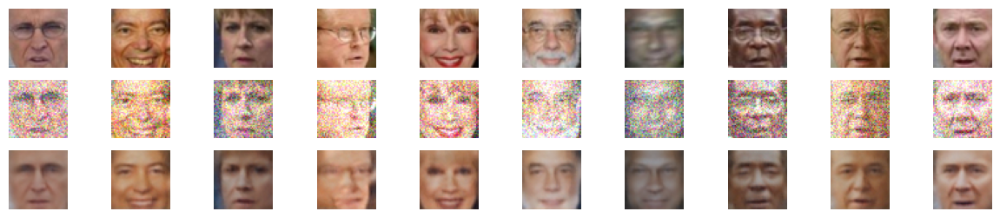

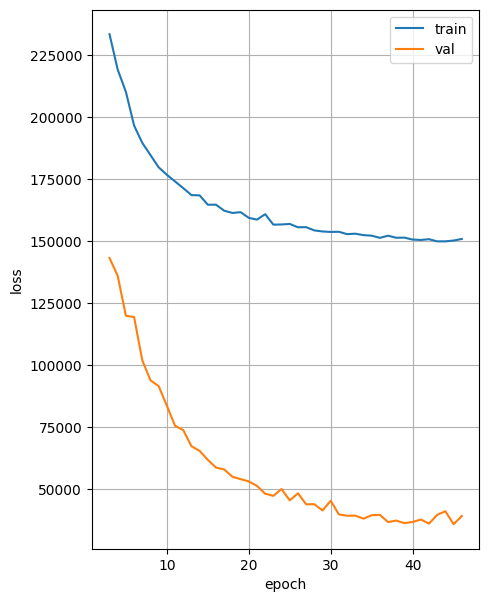

Epoch: 48; train loss: 150051.1546; val loss: 36109.5607


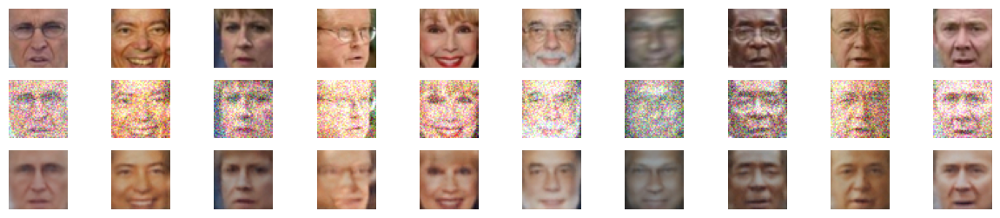

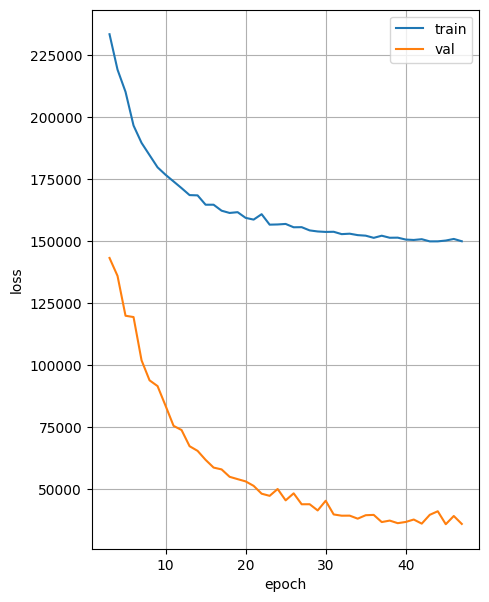

Epoch: 49; train loss: 148575.6365; val loss: 36701.1768


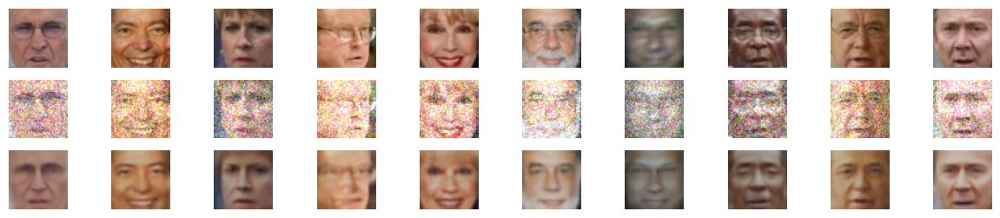

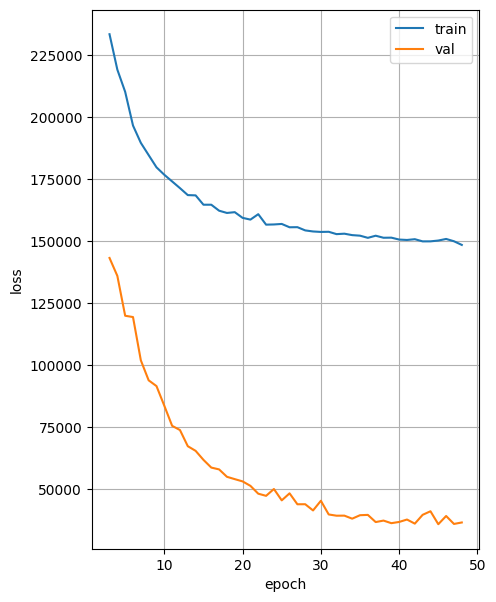

Epoch: 50; train loss: 152151.3553; val loss: 43567.0578


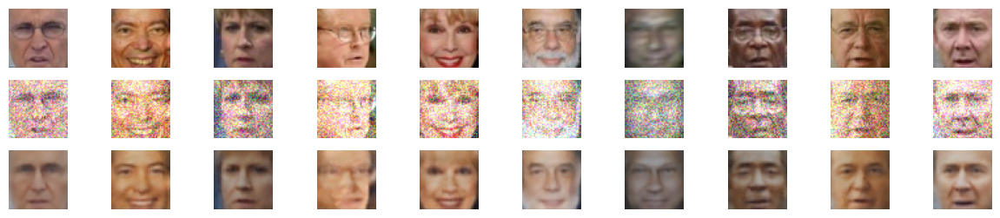

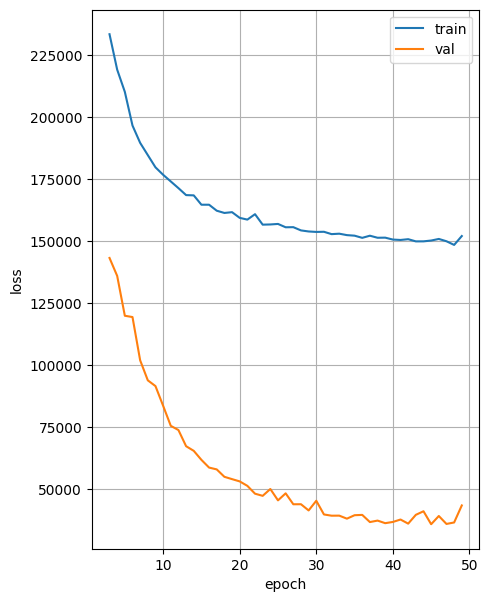

In [ ]:
epochs = 50
train_loss = []
val_loss = []

for epoch in range(epochs):
  autoencoder.train()
  cur_train_loss = 0.0
  for batch in train_loader:
    optimizer.zero_grad()
    # Все данные уже на GPU, переносить не нужно
    images = add_noise(batch[0])
    reconstruction, _ = autoencoder(images)
    l = criterion(images, reconstruction)
    l.backward()
    optimizer.step()
    cur_train_loss += l.detach().cpu().item() * images.numel()
  # Подгоняемся под размер картинок для упрощения кода
  cur_train_loss /= len(train_loader) * (3 * 45 * 45)

  autoencoder.eval()
  cur_val_loss = 0.0
  with torch.no_grad():
    for batch in val_loader:
      images = batch[0]
      reconstruction, _ = autoencoder(images)
      l = criterion(images, reconstruction)
      cur_val_loss += l.detach().cpu().item() * images.numel()
  cur_val_loss /= len(val_loader) * (3 * 45 * 45)

  train_loss.append(cur_train_loss)
  val_loss.append(cur_val_loss)
  print(f"Epoch: {epoch + 1}; train loss: {cur_train_loss:.4f}; val loss: {cur_val_loss:.4f}")

  cols_count = 10
  with torch.no_grad():
    source = next(iter(val_loader))[0][:cols_count]
    source_noise = add_noise(source)
    reconstructed, _ = autoencoder(source)
    source = source.cpu().permute(0, 2, 3, 1).type(torch.int)
    source_noise = source_noise.cpu().permute(0, 2, 3, 1).type(torch.int)
    reconstructed = reconstructed.cpu().permute(0, 2, 3, 1).type(torch.int).clip(0, 255)

  fig, axes = plt.subplots(3, cols_count, figsize=(15, 3))

  for i in range(cols_count):
    axes[0][i].imshow(source[i])
    axes[0][i].axis('off')
    axes[1][i].imshow(source_noise[i])
    axes[1][i].axis('off')
    axes[2][i].imshow(reconstructed[i])
    axes[2][i].axis('off')

  plt.show()

  # Не будем рисовать на первых эпохах, т.к. данных пока мало
  start_epoch = 3
  if epoch > 4:
    plt.figure(figsize=(5,7))
    # Также не будем рисовать loss для первых эпох, т.к. он там слишком большой и не показательный
    plt.plot(range(start_epoch, len(train_loss)), train_loss[start_epoch:], label='train')
    plt.plot(range(start_epoch, len(val_loss)), val_loss[start_epoch:], label='val')
    plt.xlabel('epoch')
    plt.ylabel('loss')
    plt.legend()
    plt.grid()
    plt.show()

Оказывается, я случайно замеряю loss на валидационной выборке без шума. Поэтому он такой низкий. Что в целом не так плохо, т.к. мы проверяем способность модели определять, есть ли шум на изображении, и если есть, то насколько сильный он.

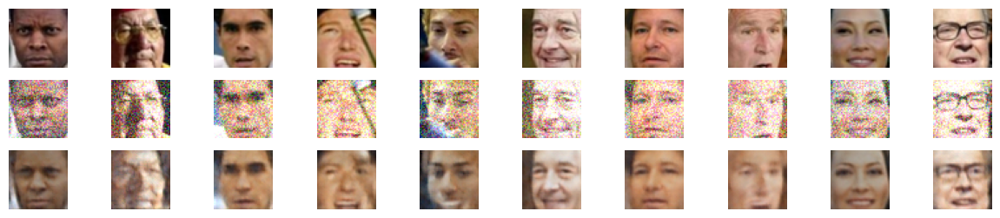

In [ ]:
cols_count = 10
with torch.no_grad():
  source = next(iter(val_loader))[0][cols_count:cols_count*2]
  source_noise = add_noise(source)
  reconstructed, _ = autoencoder(source)
  source = source.cpu().permute(0, 2, 3, 1).type(torch.int)
  source_noise = source_noise.cpu().permute(0, 2, 3, 1).type(torch.int)
  reconstructed = reconstructed.cpu().permute(0, 2, 3, 1).type(torch.int).clip(0, 255)

fig, axes = plt.subplots(3, cols_count, figsize=(15, 3))

for i in range(cols_count):
  axes[0][i].imshow(source[i])
  axes[0][i].axis('off')
  axes[1][i].imshow(source_noise[i])
  axes[1][i].axis('off')
  axes[2][i].imshow(reconstructed[i])
  axes[2][i].axis('off')

plt.show()

Получилось неплохо.

# BONUS 2: Image Retrieval (2 балла)

## Внимание! За бонусы доп. баллы не ставятся, но вы можете сделать их для себя.

Давайте представим, что весь наш тренировочный датасет -- это большая база данных людей. И вот мы получили картинку лица какого-то человека с уличной камеры наблюдения (у нас это картинка из тестового датасета) и хотим понять, что это за человек. Что нам делать? Правильно -- берем наш VAE, кодируем картинку в латентное представление и ищем среди латентных представлений лиц нашей базы самые ближайшие!

План:

1. Получаем латентные представления всех лиц тренировочного датасета
2. Обучаем на них LSHForest `(sklearn.neighbors.LSHForest)`, например, с `n_estimators=50`
3. Берем картинку из тестового датасета, с помощью VAE получаем ее латентный вектор
4. Ищем с помощью обученного LSHForest ближайшие из латентных представлений тренировочной базы
5. Находим лица тренировочного датасета, которым соответствуют ближайшие латентные представления, визуализируем!

Немного кода вам в помощь: (feel free to delete everything and write your own)

In [ ]:
train_loader_not_shuffle = DataLoader(TensorDataset(train_images), batch_size=batch_size, shuffle=False)
codes = []
with torch.no_grad():
  autoencoder.eval()
  for batch in train_loader_not_shuffle:
    codes.append(autoencoder.encoder(batch[0]))
codes = torch.cat(codes).cpu()

In [ ]:
# обучаем LSHForest
# from sklearn.neighbors import LSHForest
from sklearn.neighbors import NearestNeighbors
nearest_neighbors = NearestNeighbors(n_neighbors=50).fit(codes)

In [ ]:
def get_similar(image, n_neighbors=5):
  # функция, которая берет тестовый image и с помощью метода kneighbours у LSHForest ищет ближайшие векторы
  # прогоняет векторы через декодер и получает картинки ближайших людей

  code = autoencoder.encoder(image).detach().cpu()

  (distances,),(idx,) = nearest_neighbors.kneighbors(code, n_neighbors=n_neighbors)

  return distances, train_images[idx]

In [ ]:
def show_similar(image):

  # функция, которая принимает тестовый image, ищет ближайшие к нему и визуализирует результат

    distances,neighbors = get_similar(image,n_neighbors=11)

    plt.figure(figsize=[8,6])
    plt.subplot(3,4,1)
    plt.imshow(image[0].cpu().type(torch.int).clip(0, 255).numpy().transpose([1,2,0]))
    plt.title("Original image")
    plt.axis('off')

    for i in range(11):
        plt.subplot(3,4,i+2)
        plt.imshow(neighbors[i].cpu().type(torch.int).clip(0, 255).numpy().transpose([1,2,0]))
        plt.title("Dist=%.3f"%distances[i])
        plt.axis('off')
    plt.show()

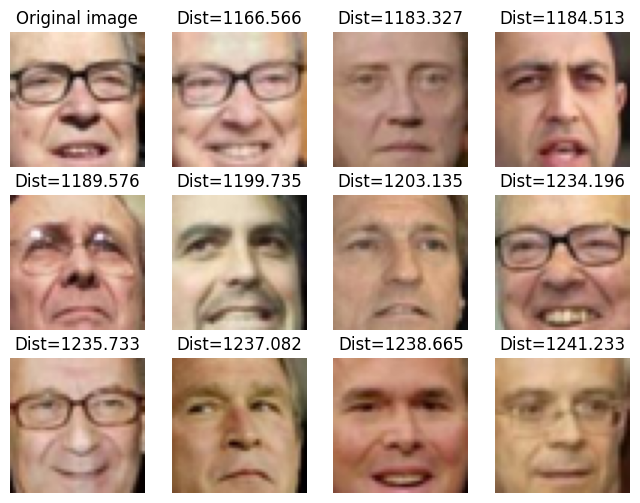

In [ ]:
sample = next(iter(val_loader))[0][19:20]
show_similar(sample)

Достаточно похоже.

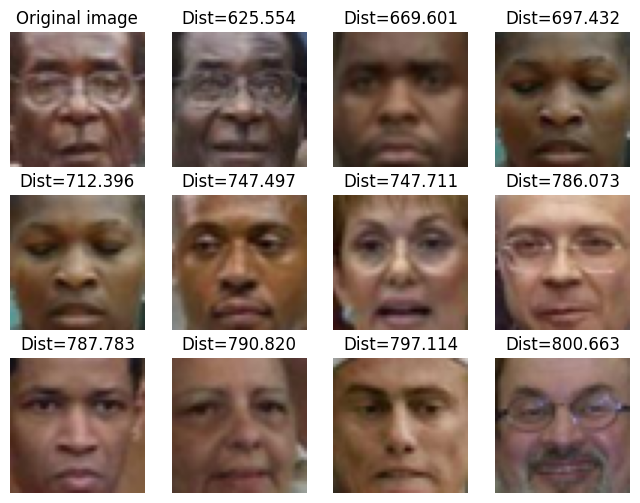

In [ ]:
sample = next(iter(val_loader))[0][7:8]
show_similar(sample)